In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import networkx as nx
import time as time
from tabulate import tabulate
from scipy.linalg import svd
from scipy.optimize import minimize
import pandas as pd

BASE_WIDTH = 5
bgr_range = [(20, 20, 255), (240, 240, 240) , (255, 30, 30)]
cm_bgr = mcolors.LinearSegmentedColormap.from_list( "bgr", np.array(bgr_range) / 255.0 )

def solve_gFJ(s, Lambda, W):
    n = len(s)
    I = np.eye(n)
    H = np.linalg.inv(I - Lambda @ W) @ (I - Lambda)
    z = H @ s

    return z

def calculate_polarization_metrics(x, W):
    n = len(x)
    x_mean = np.mean(x)

    # GDI
    GDI = 0
    for i in range(n):
        for j in range(i + 1, n):
            GDI += ( x[i] - x[j] ) ** 2

    # NDI
    NDI = 0
    for i in range(n):
        for j in range(n):
            NDI += W[i, j] * ( x[i] - x[j] ) ** 2

    # P metrics
    P1 = np.sum((x - x_mean) ** 2)
    P2 = np.mean(x ** 2)
    P3 = np.sum(x ** 2)
    P4 = np.sum(np.abs(x))

    return {"GDI": GDI, "NDI": NDI, "P1": P1, "P2": P2, "P3": P3, "P4": P4}

def plot_opinions(s, z):
    n = len(s)
    x = np.arange(n)

    # assign colors
    cmap = cm_bgr # plt.cm.bgr
    norm = mcolors.Normalize(vmin=-1, vmax=1)
    s_colors = cmap(norm(s))
    z_colors = cmap(norm(z))

    fig, ax = plt.subplots(figsize=(8, 4))

    # print points
    ax.scatter(x, s, marker='s', s=100, c=s_colors, label='Initial $s$')
    ax.scatter(x, z, marker='o', s=100, c=z_colors, label='Final $z$')

    # plot
    ax.axhline(0, color='gray', linestyle='--', linewidth=1, alpha=0.6)
    ax.set_xlabel("Node")
    ax.set_ylabel("Opinion")
    ax.set_title("Opinions comparison")
    ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
    ax.set_ylim(-1, 1)
    ax.legend(loc='lower right', bbox_to_anchor=(1.18, 0.85), borderaxespad=0)
    ax.grid(False)
    plt.show()

def visualize_network(W, opinions, layout="spring", set_pos=None, title="Opinions", options=None):
    n = len(opinions)

    # connect graph
    G = nx.DiGraph()
    for i in range(n):
        for j in range(n):
            if W[i, j] > 0:
                G.add_edge(i, j, weight=W[i, j])

    # assign node colors
    norm_opinions = (opinions + 1) / 2
    cmap = cm_bgr # plt.cm.bgr #plt.cm.coolwarm
    node_colors = cmap(norm_opinions)

    # choose layout
    if set_pos is not None:
        pos = set_pos
    elif layout == "spring":
        pos = nx.spring_layout(G)
    elif layout == "circular":
        pos = nx.circular_layout(G)
    else:
        pos = nx.spring_layout(G)

    # scale edges according yo weights
    edge_widths = []
    for u, v in G.edges():
        w = G[u][v]['weight']
        edge_widths.append(w * BASE_WIDTH)

    # plot network
    fig, ax = plt.subplots(figsize=(6, 5))
    nx.draw(G, pos, ax=ax,
            with_labels=True,
            node_color=node_colors,
            node_size=800,
            arrowsize=10,
            # width=1.5,
            width=edge_widths,
            font_color='black',
            edge_color='gray',
            edgecolors='black')

    ax.set_title(title)
    ax.set_axis_off()
    plt.show()

    return pos

def print_W(W):
    headers = [f"->{j}" for j in range(W.shape[1])]
    rows = [[f"{W[i, j]:.2f}" for j in range(W.shape[1])] for i in range(W.shape[0])]
    print(tabulate(rows, headers=headers, showindex=[f"<-{i}" for i in range(W.shape[0])], tablefmt="grid"))

def common_template(s, Lambda, W):
    # find convergence
    z = solve_gFJ(s, Lambda, W)

    # metrics
    metrics_s = calculate_polarization_metrics(s, W)
    metrics_z = calculate_polarization_metrics(z, W)

    # prints
    print("Initial Opinions:\t", [f"{val:.2f}" for val in s])
    print("Final Opinions:\t\t", [f"{val:.2f}" for val in z])
    print("Susceptibilities:\t", [f"{val:.2f}" for val in lambda_vals])
    print("Weights:")
    print_W(W)
    print("\nPolarization:")
    for k in metrics_s:
        delta = metrics_z[k] - metrics_s[k]
        print(f"{k}:\tΔΦ = ({metrics_s[k]:.2f}) - ({metrics_z[k]:.2f}) = {delta:.2f}")

    # another type
    plot_opinions(s, z)

    # plot opinion network graph
    pos = visualize_network(W, s, title="Starting Opinions")
    _ = visualize_network(W, z, set_pos=pos, title="Final Opinions")

In [2]:
""" P2, P3 """

def find_polarizing_s_for_P2_P3(Lambda, W):
    # calc Hg
    I = np.eye(len(Lambda))
    Hg = np.linalg.inv(I - Lambda @ W) @ (I - Lambda)

    # find s
    eigvals, eigvecs = np.linalg.eig(Hg.T @ Hg)
    i_max = np.argmax(eigvals)
    s = eigvecs[:, i_max].real # real part only
    return s

def find_polarizing_s_for_P2_P3(Lambda, W):
    # calc Hg
    I = np.eye(len(Lambda))
    Hg = np.linalg.inv(I - Lambda @ W) @ (I - Lambda)

    # find s
    eigvals, eigvecs = np.linalg.eig(Hg.T @ Hg)
    i_max = np.argmax(eigvals)
    s = eigvecs[:, i_max].real # real part only
    s = s / np.max(np.abs(s)) # normalize - s_B2(1) * t, t = 1/max(s_B2(1))
    return s

def objective_P2P3(s, n, Hg):
    z = Hg @ s
    return - (np.linalg.norm(z) ** 2 - np.linalg.norm(s) ** 2)

def get_s_max_P2P3(Lambda, W):
    # initial s0
    s0 = np.random.rand(n)

    # calc Hg
    I = np.eye(n)
    Hg = np.linalg.inv(I - Lambda @ W) @ (I - Lambda)

    bounds = [(0, 1)] * n

    res = minimize(objective_P2P3, s0, args=(n, Hg), method='SLSQP', bounds=bounds)

    return np.array(res.x)

""" P4 """

def find_polarizing_s_for_P4(Lambda, W):
    # calc Hg
    I = np.eye(n)
    Hg = np.linalg.inv(I - Lambda @ W) @ (I - Lambda)

    # find elem j
    col_sums = Hg.sum(axis=0)
    j = np.argmax(col_sums)

    s = np.zeros(n)
    s[j] = 1
    return s

def objective_P4(s, n, Hg):
    z = Hg @ s
    return - ( (np.sum(np.abs(z))) - (np.sum(np.abs(s))) )

def get_s_max_P4(Lambda, W):
    # initial s0
    s0 = np.random.rand(n)

    # calc Hg
    I = np.eye(n)
    Hg = np.linalg.inv(I - Lambda @ W) @ (I - Lambda)


    bounds = [(0, 1)] * n

    res = minimize(objective_P4, s0, args=(n, Hg), method='SLSQP', bounds=bounds)

    return np.array(res.x)

---
# **Scenario 1**: Testing
---

Initial Opinions:	 ['0.20', '0.80', '-0.60', '0.00', '0.90']
Final Opinions:		 ['0.22', '0.50', '-0.50', '0.24', '0.76']

Polarization:
GDI:	ΔΦ = (7.56) - (4.41) = -3.15
NDI:	ΔΦ = (3.11) - (1.85) = -1.26
P1:	ΔΦ = (1.51) - (0.88) = -0.63
P2:	ΔΦ = (0.37) - (0.24) = -0.13
P3:	ΔΦ = (1.85) - (1.18) = -0.67
P4:	ΔΦ = (2.50) - (2.22) = -0.28


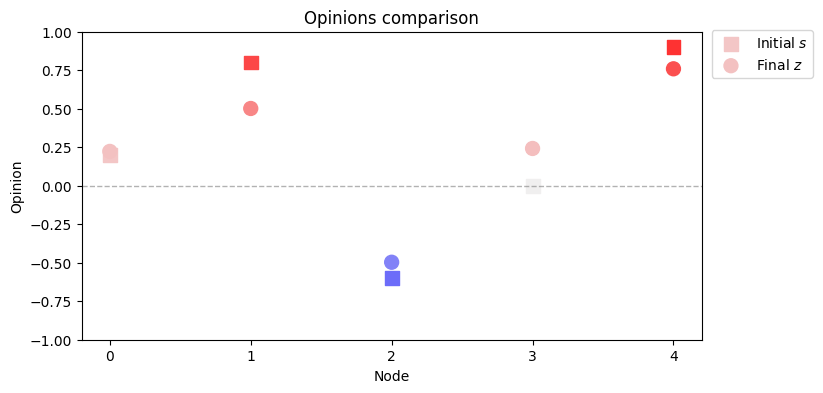

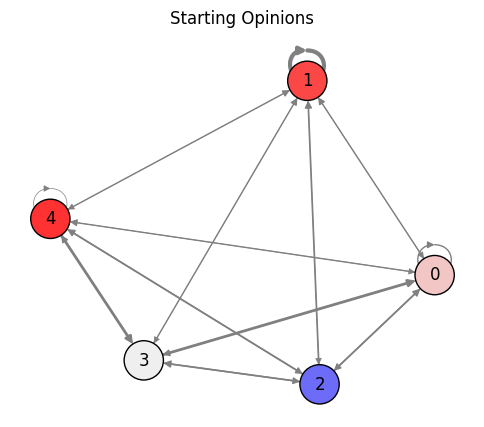

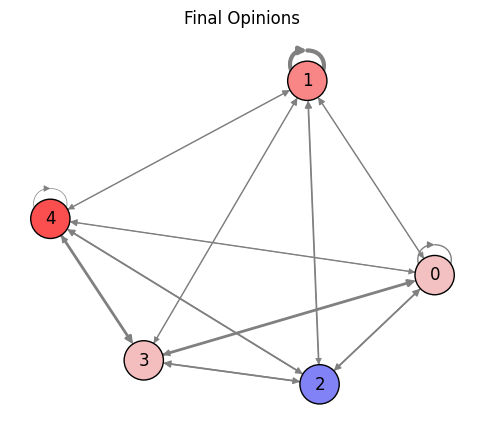

In [5]:
s = np.array([0.2, 0.8, -0.6, 0.0, 0.9]) # starting opinion
n = len(s)

lambda_vals = np.array([0.5, 0.7, 0.1, 1.0, 0.2]) # susceptabilities
Lambda = np.diag(lambda_vals) # Lambda matrix

W = np.array([
    [0.2, 0.2, 0.2, 0.2, 0.2],
    [0.1, 0.6, 0.1, 0.1, 0.1],
    [0.25, 0.25, 0.0, 0.25, 0.25],
    [0.4, 0.2, 0.2, 0.0, 0.2],
    [0.1, 0.2, 0.2, 0.4, 0.1],
]) # weights

# find convergence
z = solve_gFJ(s, Lambda, W)

# metrics
metrics_s = calculate_polarization_metrics(s, W)
metrics_z = calculate_polarization_metrics(z, W)

# prints
print("Initial Opinions:\t", [f"{val:.2f}" for val in s])
print("Final Opinions:\t\t", [f"{val:.2f}" for val in z])
print("\nPolarization:")
for k in metrics_s:
    delta = metrics_z[k] - metrics_s[k]
    print(f"{k}:\tΔΦ = ({metrics_s[k]:.2f}) - ({metrics_z[k]:.2f}) = {delta:.2f}")

# another type
plot_opinions(s, z)

# plot opinion network graph
pos = visualize_network(W, s, title="Starting Opinions")
_ = visualize_network(W, z, set_pos=pos, title="Final Opinions")

---
# **Scenario 2**: Random
---

seed: 1749567893

Initial Opinions:	 ['0.12', '0.71', '-0.21', '0.91', '0.98', '0.28', '-0.31', '0.38', '0.57', '-0.86']
Final Opinions:		 ['0.06', '0.61', '-0.11', '0.71', '0.17', '0.13', '-0.24', '0.01', '-0.01', '-0.80']
Susceptibilities:	 ['0.70', '0.14', '0.26', '0.23', '0.95', '0.71', '0.21', '0.93', '0.94', '0.06']
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
|     |   ->0 |   ->1 |   ->2 |   ->3 |   ->4 |   ->5 |   ->6 |   ->7 |   ->8 |   ->9 |
+=====+=======+=======+=======+=======+=======+=======+=======+=======+=======+=======+
| <-0 |  0    |  0.16 |  0.14 |  0.1  |  0.07 |  0.04 |  0.07 |  0.1  |  0.14 |  0.16 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-1 |  0.16 |  0    |  0.16 |  0.14 |  0.1  |  0.07 |  0.04 |  0.07 |  0.1  |  0.14 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-2 |  0.14 |  0.16 |  0    |  0.16 |  0.14 |  0.1  |  0.0

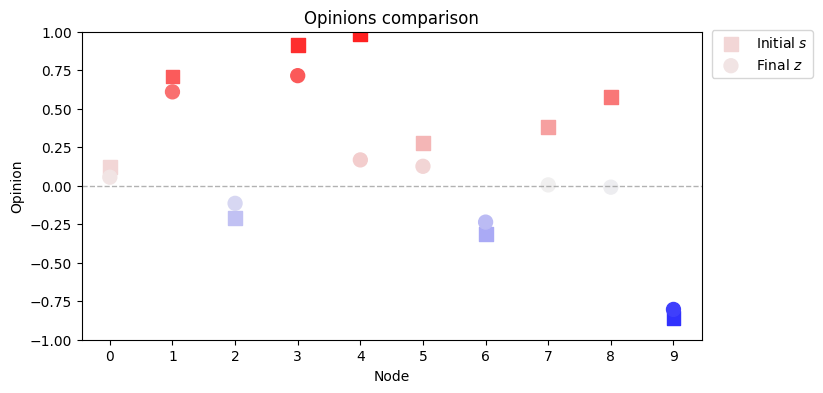

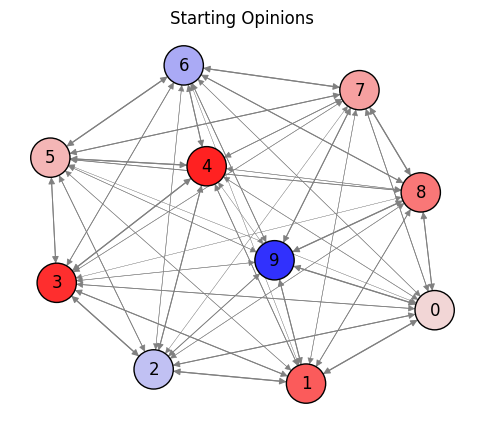

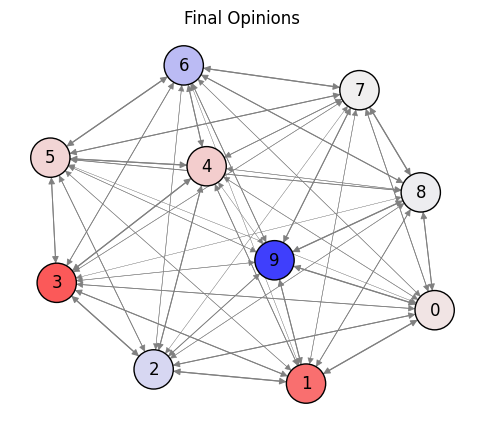

In [6]:
# function more localized weights (gaussian, numerically close neighbors -> higher w_ij) - WIP random doesn't work atm (TODO)
def rand_weights_scheme1(n, sigma=1, deterministic=True):
    W = np.zeros((n, n))

    if deterministic:
        for i in range(n):
            for j in range(n):
                if i == j:
                    W[i, j] = 0
                else:
                    # dist = i - j
                    dist = min(abs(i - j), n - abs(i - j)) # modular dist
                    W[i, j] = np.exp(-(dist ** 2) / (2 * sigma ** 2))

            W[i] /= W[i].sum() # stochastic row
    else:
        for i in range(n):
            distances = np.array([min(abs(i - j), n - abs(i - j)) for j in range(n)])
            probabilities = np.exp(-(distances ** 2) / (2 * sigma ** 2)) # discrete prob
            probabilities /= probabilities.sum() # normalize
            W[i] = np.random.dirichlet(probabilities) # approx distribution

    return W

n = 10

# random init
seed = int(time.time())
print("seed: " + str(seed) +"\n")
np.random.seed(seed)
s = np.random.uniform(-1, 1, n)

lambda_vals = np.random.uniform(0, 1, n)
Lambda = np.diag(lambda_vals)

# W = np.random.rand(n, n)
# W = W / W.sum(axis=1, keepdims=True) # row stochastic (i -> all j's)
W = rand_weights_scheme1(n, sigma=3, deterministic=True)

# find convergence
z = solve_gFJ(s, Lambda, W)

# metrics
metrics_s = calculate_polarization_metrics(s, W)
metrics_z = calculate_polarization_metrics(z, W)

# prints
print("Initial Opinions:\t", [f"{val:.2f}" for val in s])
print("Final Opinions:\t\t", [f"{val:.2f}" for val in z])
print("Susceptibilities:\t", [f"{val:.2f}" for val in lambda_vals])

# tabulate, no idea how this format works
headers = [f"->{j}" for j in range(W.shape[1])]
rows = [[f"{W[i, j]:.2f}" for j in range(W.shape[1])] for i in range(W.shape[0])]
print(tabulate(rows, headers=headers, showindex=[f"<-{i}" for i in range(W.shape[0])], tablefmt="grid"))

print("\nPolarization:")
for k in metrics_s:
    delta = metrics_z[k] - metrics_s[k]
    print(f"{k}:\tΔΦ = ({metrics_s[k]:.2f}) - ({metrics_z[k]:.2f}) = {delta:.2f}")

# another type
plot_opinions(s, z)

# plot opinion network graph
pos = visualize_network(W, s, title="Starting Opinions")
_ = visualize_network(W, z, set_pos=pos, title="Final Opinions")

---
# **Scenario 3**: Polarizing vector for P2, P3
---

From theorem 5 (i), finds the max eigenvalue eigenvector of Hg^T @ Hg. \\
Only creates concordant vectors. \\
s_B1(1)

Initial Opinions:	 ['0.28', '0.88', '0.24', '0.45', '0.36', '0.07', '0.53', '0.13', '1.00', '0.35']
Final Opinions:		 ['0.47', '0.86', '0.44', '0.49', '0.45', '0.55', '0.53', '0.40', '0.98', '0.46']
Susceptibilities:	 ['0.60', '0.07', '0.63', '0.39', '0.39', '0.90', '0.25', '0.73', '0.04', '0.46']
Weights:
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
|     |   ->0 |   ->1 |   ->2 |   ->3 |   ->4 |   ->5 |   ->6 |   ->7 |   ->8 |   ->9 |
+=====+=======+=======+=======+=======+=======+=======+=======+=======+=======+=======+
| <-0 |  0.17 |  0.15 |  0.1  |  0.12 |  0.07 |  0.04 |  0.16 |  0.02 |  0.12 |  0.03 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-1 |  0.11 |  0.06 |  0.08 |  0.15 |  0.16 |  0.06 |  0.12 |  0.11 |  0.13 |  0.03 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-2 |  0.07 |  0.14 |  0.17 |  0.15 |  0.1  |  0.07 |  0.06 |  0.13 |  0.0

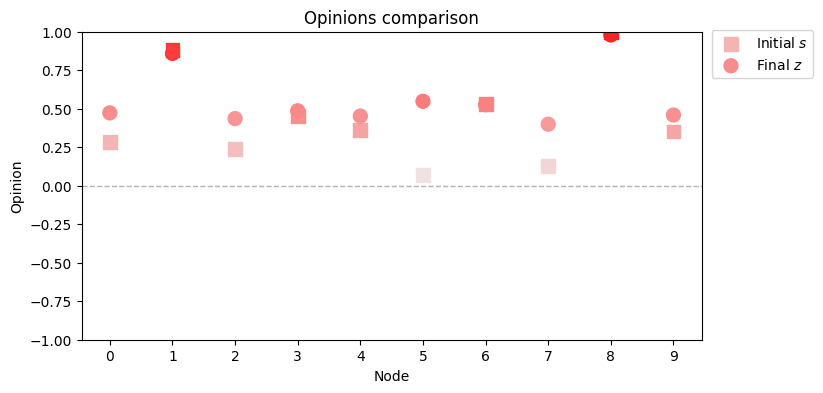

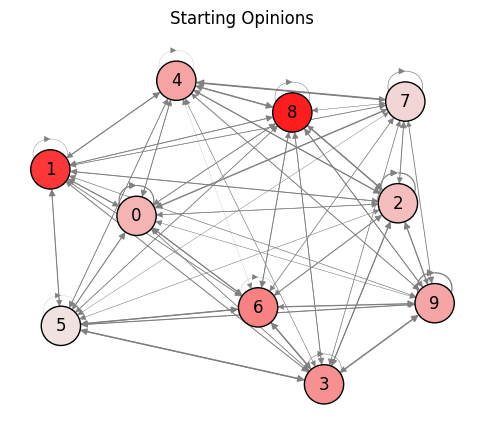

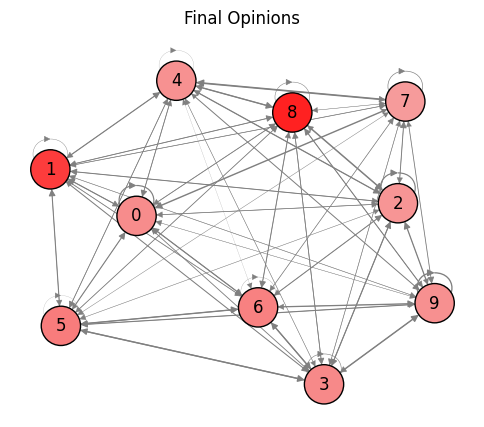

In [3]:
# given random Lambda and W
n = 10
# rand Lambda
lambda_vals = np.random.uniform(0, 1, n)
Lambda = np.diag(lambda_vals)
# rand W
W = np.random.rand(n, n)
W = W / W.sum(axis=1, keepdims=True) # row stochastic (i -> all j's)

# calculate s, so that it's aligned with max
s = find_polarizing_s_for_P2_P3(Lambda, W)


common_template(s, Lambda, W)

s_B2{t)


Initial Opinions:	 ['-1.00', '-0.99', '-0.71', '-0.19', '-0.30', '-0.18', '-0.91', '-0.18', '-0.73', '-0.09']
Final Opinions:		 ['-0.97', '-0.95', '-0.71', '-0.64', '-0.58', '-0.67', '-0.88', '-0.63', '-0.73', '-0.67']
Susceptibilities:	 ['0.11', '0.17', '0.19', '0.83', '0.71', '0.80', '0.21', '0.79', '0.39', '0.92']
Weights:
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
|     |   ->0 |   ->1 |   ->2 |   ->3 |   ->4 |   ->5 |   ->6 |   ->7 |   ->8 |   ->9 |
+=====+=======+=======+=======+=======+=======+=======+=======+=======+=======+=======+
| <-0 |  0.1  |  0.1  |  0.23 |  0.01 |  0    |  0.12 |  0.04 |  0.07 |  0.2  |  0.13 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-1 |  0.13 |  0.02 |  0.17 |  0.07 |  0.09 |  0.12 |  0.06 |  0.02 |  0.15 |  0.17 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-2 |  0.09 |  0.12 |  0.03 |  0.2  |  0.21 |  0.18 | 

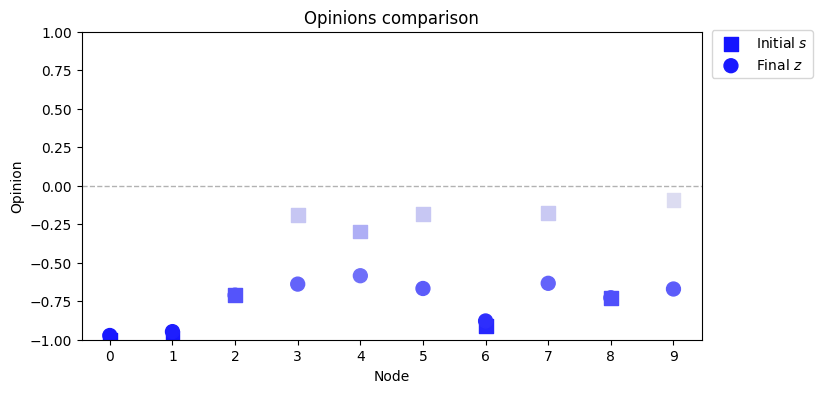

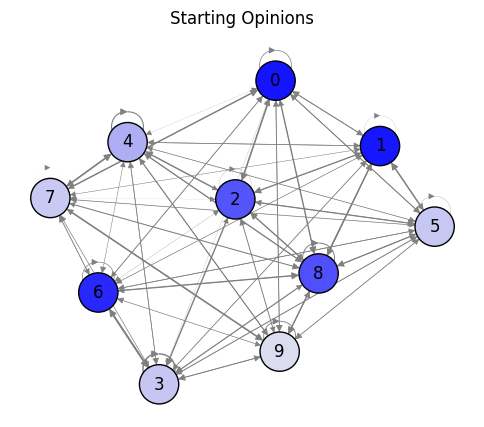

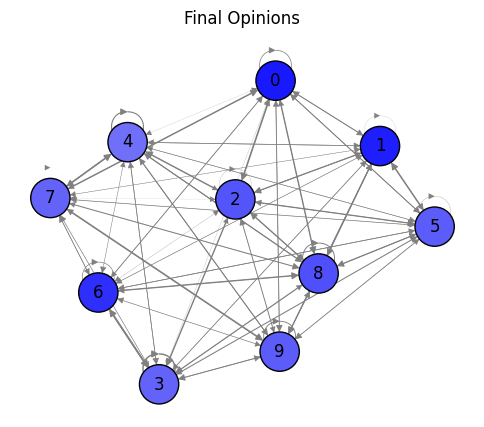

In [4]:
# given random Lambda and W
n = 10
# rand Lambda
lambda_vals = np.random.uniform(0, 1, n)
Lambda = np.diag(lambda_vals)
# rand W
W = np.random.rand(n, n)
W = W / W.sum(axis=1, keepdims=True) # row stochastic (i -> all j's)

# calculate s, so that it's aligned with max
s = find_polarizing_s_for_P2_P3(Lambda, W)


common_template(s, Lambda, W)

s_maxP2,P3 is NP-hard

s_V>1 and s_V>=1 is convex problem that I don't know how to solve

s_v_heu is easier to compute. Nvm.

s_max^P2P3 using scipy minimize on the opt problem given https://docs.scipy.org/doc/scipy/tutorial/optimize.html


s_B2(1)
Initial Opinions:	 ['0.19', '1.00', '0.18', '0.23', '0.70', '0.38', '0.26', '0.35', '0.40', '0.41']
Final Opinions:		 ['0.39', '0.97', '0.38', '0.37', '0.68', '0.44', '0.38', '0.39', '0.43', '0.43']
Susceptibilities:	 ['0.69', '0.06', '0.67', '0.56', '0.09', '0.39', '0.50', '0.33', '0.34', '0.37']
Weights:
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
|     |   ->0 |   ->1 |   ->2 |   ->3 |   ->4 |   ->5 |   ->6 |   ->7 |   ->8 |   ->9 |
+=====+=======+=======+=======+=======+=======+=======+=======+=======+=======+=======+
| <-0 |  0.16 |  0.08 |  0.06 |  0.07 |  0.08 |  0.17 |  0.08 |  0.05 |  0.17 |  0.08 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-1 |  0.09 |  0.11 |  0.13 |  0.1  |  0.1  |  0.15 |  0.09 |  0.1  |  0.01 |  0.12 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-2 |  0.21 |  0.12 |  0.06 |  0.13 |  0.03 |  0.04 |  0.03 |  0.0

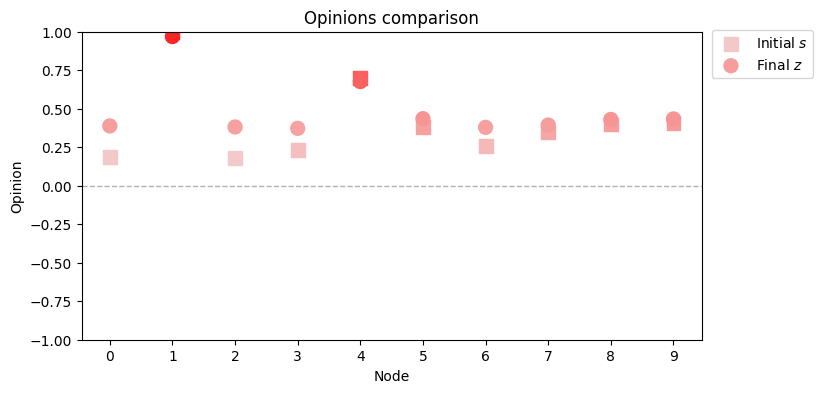

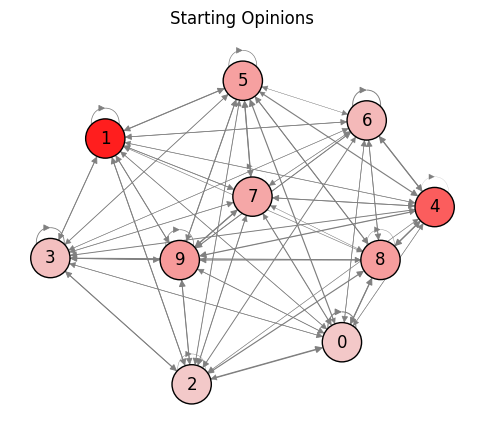

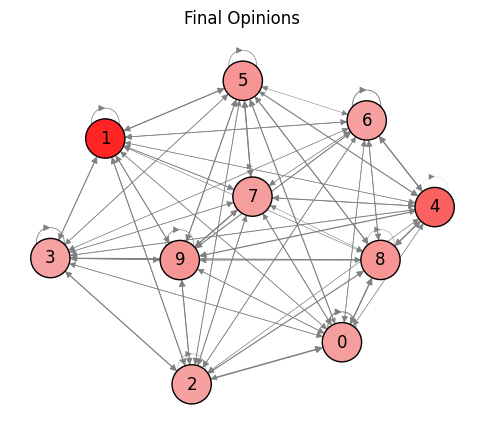

s_B2(t)
Initial Opinions:	 ['0.19', '1.00', '0.18', '0.23', '0.70', '0.38', '0.26', '0.35', '0.40', '0.41']
Final Opinions:		 ['0.39', '0.97', '0.38', '0.37', '0.68', '0.44', '0.38', '0.39', '0.43', '0.43']
Susceptibilities:	 ['0.69', '0.06', '0.67', '0.56', '0.09', '0.39', '0.50', '0.33', '0.34', '0.37']
Weights:
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
|     |   ->0 |   ->1 |   ->2 |   ->3 |   ->4 |   ->5 |   ->6 |   ->7 |   ->8 |   ->9 |
+=====+=======+=======+=======+=======+=======+=======+=======+=======+=======+=======+
| <-0 |  0.16 |  0.08 |  0.06 |  0.07 |  0.08 |  0.17 |  0.08 |  0.05 |  0.17 |  0.08 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-1 |  0.09 |  0.11 |  0.13 |  0.1  |  0.1  |  0.15 |  0.09 |  0.1  |  0.01 |  0.12 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-2 |  0.21 |  0.12 |  0.06 |  0.13 |  0.03 |  0.04 |  0.03 |  0.0

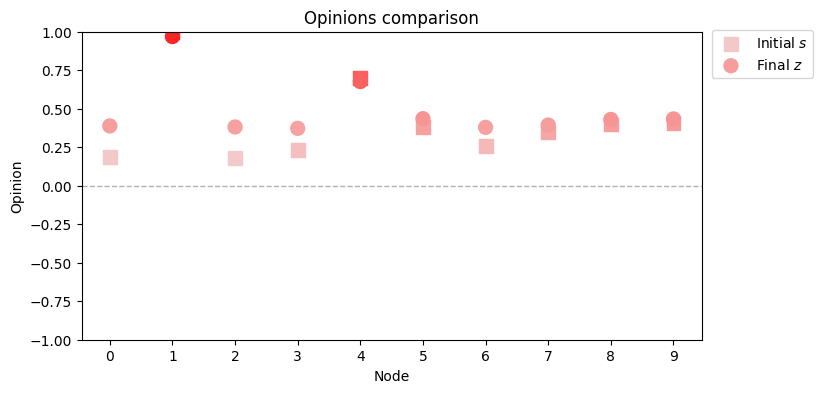

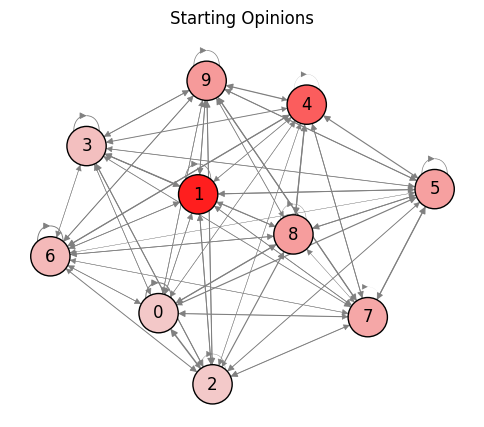

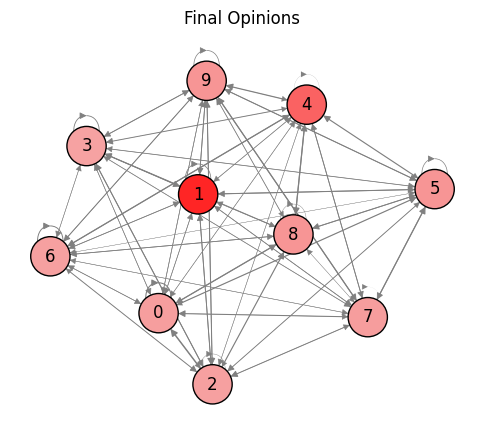

s_max_P2P3
Initial Opinions:	 ['0.41', '1.00', '0.39', '0.51', '1.00', '0.89', '0.57', '0.83', '0.95', '0.97']
Final Opinions:		 ['0.70', '0.99', '0.68', '0.68', '0.98', '0.88', '0.70', '0.83', '0.91', '0.91']
Susceptibilities:	 ['0.69', '0.06', '0.67', '0.56', '0.09', '0.39', '0.50', '0.33', '0.34', '0.37']
Weights:
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
|     |   ->0 |   ->1 |   ->2 |   ->3 |   ->4 |   ->5 |   ->6 |   ->7 |   ->8 |   ->9 |
+=====+=======+=======+=======+=======+=======+=======+=======+=======+=======+=======+
| <-0 |  0.16 |  0.08 |  0.06 |  0.07 |  0.08 |  0.17 |  0.08 |  0.05 |  0.17 |  0.08 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-1 |  0.09 |  0.11 |  0.13 |  0.1  |  0.1  |  0.15 |  0.09 |  0.1  |  0.01 |  0.12 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-2 |  0.21 |  0.12 |  0.06 |  0.13 |  0.03 |  0.04 |  0.03 |  

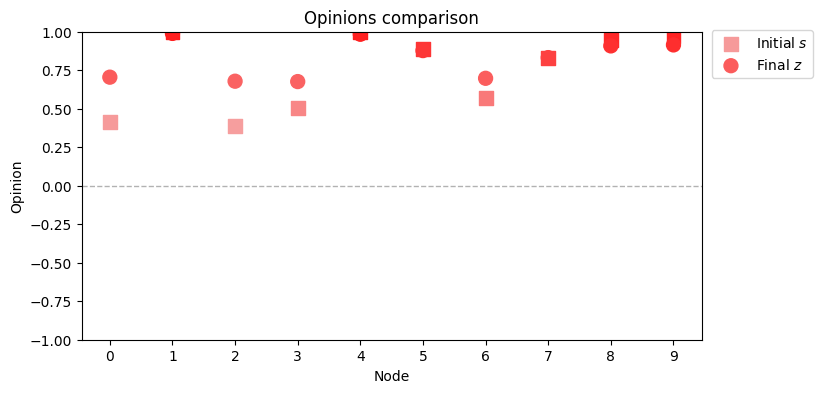

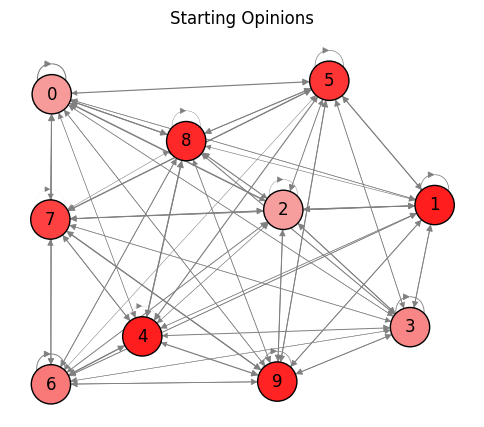

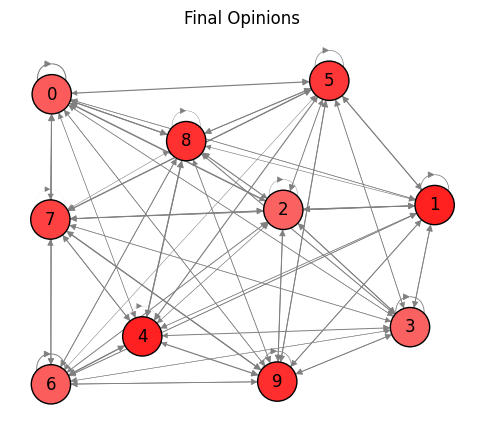

In [5]:
n = 10
# rand Lambda
np.random.seed(500)
lambda_vals = np.random.uniform(0, 1, n)
Lambda = np.diag(lambda_vals)
# rand W
W = np.random.rand(n, n)
W = W / W.sum(axis=1, keepdims=True) # row stochastic (i -> all j's)

s_max_P2P3 = get_s_max_P2P3(Lambda, W)
s_max_P2P3

# sB2(1)
s_b2_1 = find_polarizing_s_for_P2_P3(Lambda, W)

# sB2(t)
s_b2_t = s_b2_1 / np.max(np.abs(s_b2_1))

print("s_B2(1)")
common_template(s_b2_1, Lambda, W)
print("s_B2(t)")
common_template(s_b2_t, Lambda, W)
print("s_max_P2P3")
common_template(s_max_P2P3, Lambda, W)

---
# **Scenario 4**: Polarizing vector for P4
---


From theorem 6(i) find the j element aka the elem with max_j\{ sum(Hg, axis=1) \} the new vector is s = e_j \\
σ_{B2(1)}

Initial Opinions:	 ['1.00', '0.00', '0.00', '0.00', '0.00']
Final Opinions:		 ['0.96', '0.21', '0.18', '0.29', '0.10']
Susceptibilities:	 ['0.07', '0.64', '0.40', '0.77', '0.26']
Weights:
+-----+-------+-------+-------+-------+-------+
|     |   ->0 |   ->1 |   ->2 |   ->3 |   ->4 |
+=====+=======+=======+=======+=======+=======+
| <-0 |  0.32 |  0.21 |  0.17 |  0.25 |  0.05 |
+-----+-------+-------+-------+-------+-------+
| <-1 |  0.17 |  0.1  |  0.08 |  0.3  |  0.34 |
+-----+-------+-------+-------+-------+-------+
| <-2 |  0.26 |  0.2  |  0.01 |  0.48 |  0.04 |
+-----+-------+-------+-------+-------+-------+
| <-3 |  0.23 |  0.4  |  0.2  |  0.13 |  0.04 |
+-----+-------+-------+-------+-------+-------+
| <-4 |  0.24 |  0.21 |  0.23 |  0.18 |  0.14 |
+-----+-------+-------+-------+-------+-------+

Polarization:
GDI:	ΔΦ = (4.00) - (2.46) = -1.54
NDI:	ΔΦ = (1.59) - (0.95) = -0.64
P1:	ΔΦ = (0.80) - (0.49) = -0.31
P2:	ΔΦ = (0.20) - (0.22) = 0.02
P3:	ΔΦ = (1.00) - (1.09) = 0.09
P4:	ΔΦ =

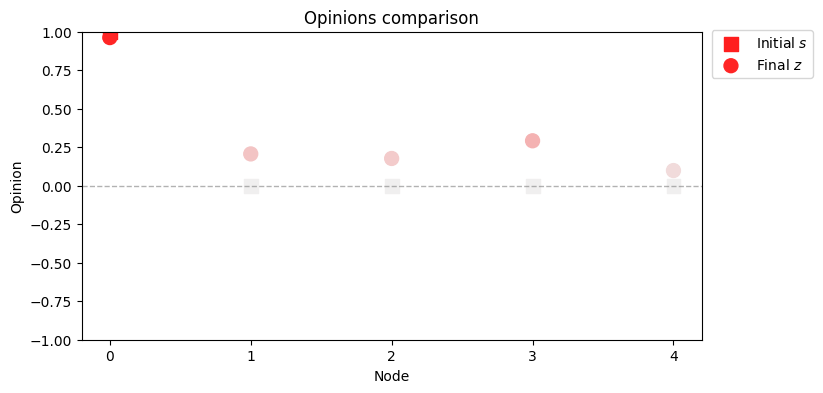

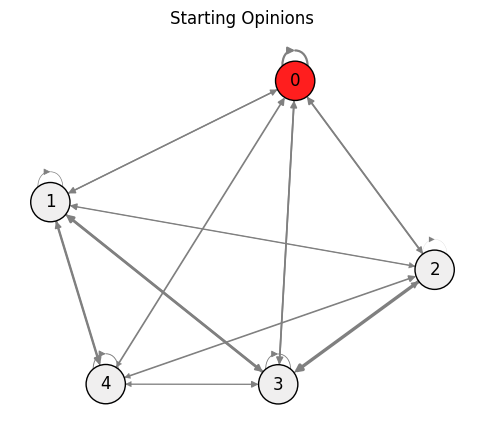

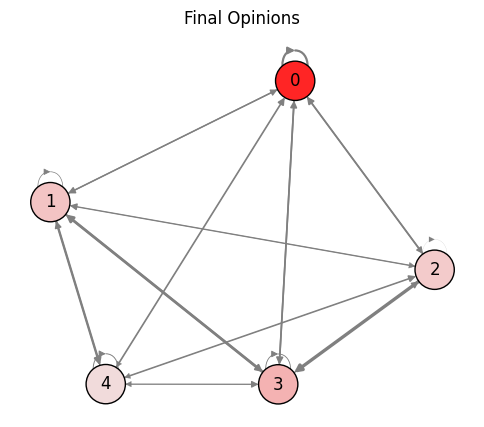

In [6]:
# given random Lambda and W
n = 5
# rand Lambda
lambda_vals = np.random.uniform(0, 1, n)
Lambda = np.diag(lambda_vals)
# rand W
W = np.random.rand(n, n)
W = W / W.sum(axis=1, keepdims=True) # row stochastic (i -> all j's)

# calculate polarizing s for P4
s = find_polarizing_s_for_P4(Lambda, W)

common_template(s, Lambda, W)

s_max_P4

s_B1(1)
Initial Opinions:	 ['0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00']
Final Opinions:		 ['0.20', '0.09', '0.23', '0.13', '0.16', '0.03', '0.22', '1.00', '0.06', '0.10']
Susceptibilities:	 ['0.97', '0.55', '0.97', '0.71', '0.70', '0.22', '0.98', '0.01', '0.25', '0.43']
Weights:
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
|     |   ->0 |   ->1 |   ->2 |   ->3 |   ->4 |   ->5 |   ->6 |   ->7 |   ->8 |   ->9 |
+=====+=======+=======+=======+=======+=======+=======+=======+=======+=======+=======+
| <-0 |  0.16 |  0.04 |  0.17 |  0.2  |  0.03 |  0.12 |  0    |  0.08 |  0.01 |  0.19 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-1 |  0.08 |  0.18 |  0.15 |  0.17 |  0.03 |  0.01 |  0.12 |  0.03 |  0.14 |  0.08 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-2 |  0.11 |  0.19 |  0.1  |  0.02 |  0.03 |  0.11 |  0.1  |  0.1

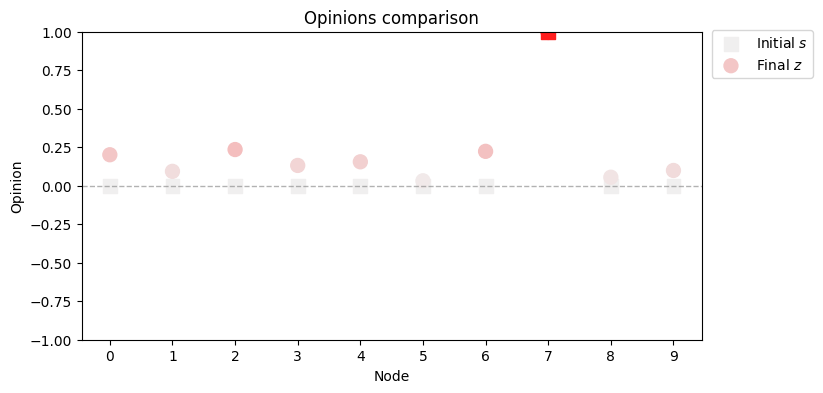

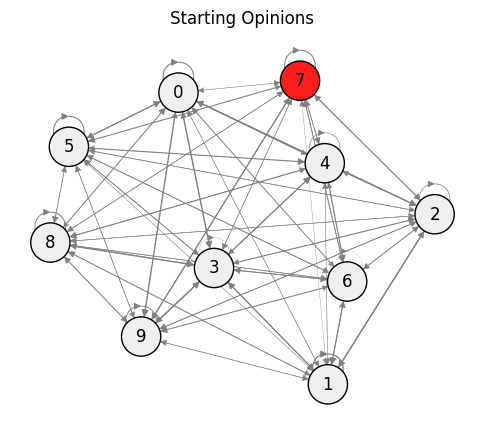

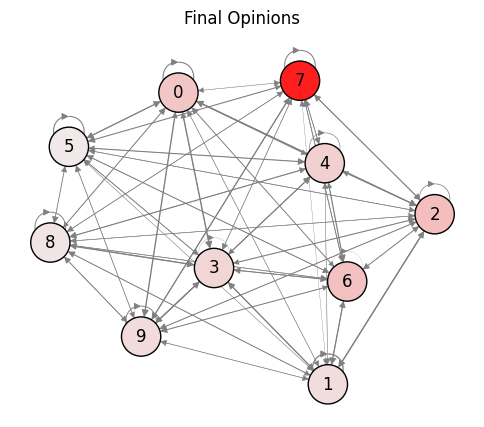

s_max_P2P3
Initial Opinions:	 ['0.00', '1.00', '0.00', '0.00', '0.00', '1.00', '0.00', '1.00', '1.00', '1.00']
Final Opinions:		 ['0.81', '0.91', '0.87', '0.62', '0.60', '0.96', '0.86', '1.00', '0.96', '0.93']
Susceptibilities:	 ['0.97', '0.55', '0.97', '0.71', '0.70', '0.22', '0.98', '0.01', '0.25', '0.43']
Weights:
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
|     |   ->0 |   ->1 |   ->2 |   ->3 |   ->4 |   ->5 |   ->6 |   ->7 |   ->8 |   ->9 |
+=====+=======+=======+=======+=======+=======+=======+=======+=======+=======+=======+
| <-0 |  0.16 |  0.04 |  0.17 |  0.2  |  0.03 |  0.12 |  0    |  0.08 |  0.01 |  0.19 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-1 |  0.08 |  0.18 |  0.15 |  0.17 |  0.03 |  0.01 |  0.12 |  0.03 |  0.14 |  0.08 |
+-----+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| <-2 |  0.11 |  0.19 |  0.1  |  0.02 |  0.03 |  0.11 |  0.1  |  

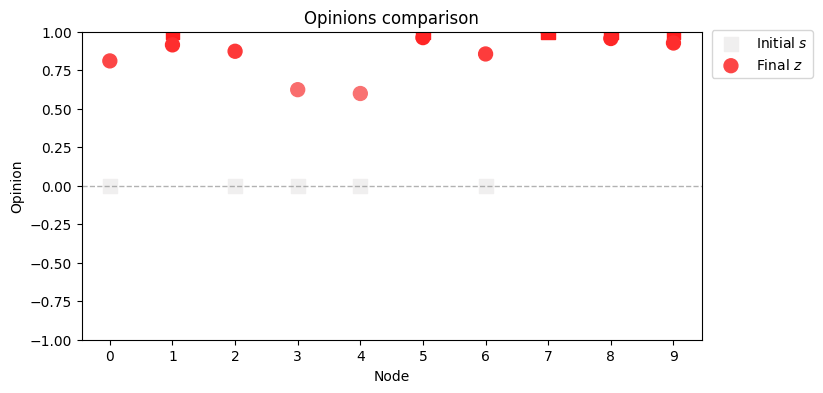

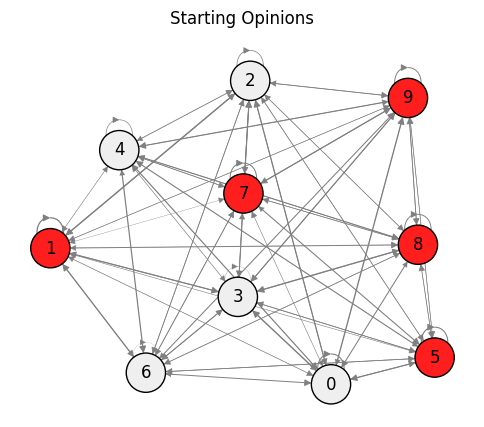

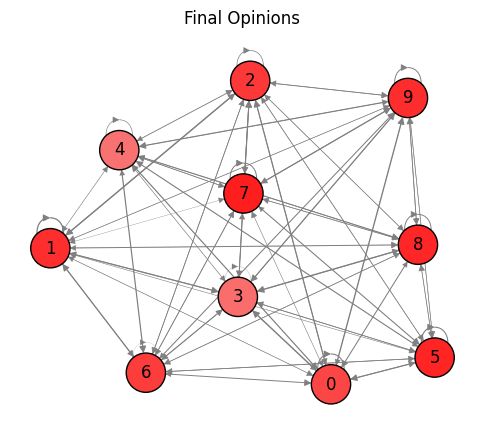

In [7]:
n = 10
# rand Lambda
np.random.seed(4)
lambda_vals = np.random.uniform(0, 1, n)
Lambda = np.diag(lambda_vals)
# rand W
W = np.random.rand(n, n)
W = W / W.sum(axis=1, keepdims=True) # row stochastic (i -> all j's)

s_max_P4 = get_s_max_P4(Lambda, W)
s_max_P4

# sB1(1)
s_b1_1 = find_polarizing_s_for_P4(Lambda, W)

print("s_B1(1)")
common_template(s_b1_1, Lambda, W)
print("s_max_P2P3")
common_template(s_max_P4, Lambda, W)

---
# **Scenario 5**: Testing polarizing vectors on random envs
---
top 5 nodes aka "hubs" have a thicker black border

cases:

*   lambda = 0.8
*   lambda prop C
*   lambda prop 1/C


In [14]:
def visualize_network_barabasi_albert(W, opinions, layout="spring", set_pos=None, title="Opinions", options=None): # cba to parametrize the original
    n = len(opinions)

    # connect graph
    G = nx.DiGraph()
    for i in range(n):
        for j in range(n):
            if W[i, j] > 0:
                G.add_edge(i, j, weight=W[i, j])

    # assign node colors
    norm_opinions = (opinions + 1) / 2
    cmap = cm_bgr # plt.cm.bgr #plt.cm.coolwarm
    node_colors = cmap(norm_opinions)

    # choose layout
    if set_pos is not None:
        pos = set_pos
    elif layout == "spring":
        pos = nx.spring_layout(G)
    elif layout == "circular":
        pos = nx.circular_layout(G)
    else:
        pos = nx.spring_layout(G)

    # scale edges according yo weights
    edge_widths = []
    for u, v in G.edges():
        w = G[u][v]['weight']
        edge_widths.append(w * BASE_WIDTH)

    # highlight top 5 hub
    degrees = dict(G.degree())
    top_5_nodes = sorted(degrees, key=degrees.get, reverse=True)[:5]

    node_border_widths = [3 if node in top_5_nodes else 1 for node in G.nodes()]
    node_border_colors = ['black' if node in top_5_nodes else 'gray' for node in G.nodes()]

    # plot network
    fig, ax = plt.subplots(figsize=(8, 6))
    nx.draw(G, pos, ax=ax,
            with_labels=True,
            node_color=node_colors,
            node_size=400,
            # width=1.5,
            width=edge_widths,
            font_color='black',
            edge_color='gray',
            # edgecolors='black',
            linewidths=node_border_widths,
            edgecolors=node_border_colors)

    ax.set_title(title)
    ax.set_axis_off()
    plt.show()

    return pos

def barabasi_albert_template(s, Lambda, W):
    # find convergence
    z = solve_gFJ(s, Lambda, W)

    # metrics
    metrics_s = calculate_polarization_metrics(s, W)
    metrics_z = calculate_polarization_metrics(z, W)

    # prints
    print("Initial Opinions:\t", [f"{val:.2f}" for val in s])
    print("Final Opinions:\t\t", [f"{val:.2f}" for val in z])
    print("Susceptibilities:\t", [f"{val:.2f}" for val in lambda_vals])

    print("\nPolarization:")
    diff = {}
    for k in metrics_s:
        delta = metrics_z[k] - metrics_s[k]
        diff[k] = round(delta, 2)
        print(f"{k}:\tΔΦ = ({metrics_s[k]:.2f}) - ({metrics_z[k]:.2f}) = {delta:.2f}")

    # another type
    plot_opinions(s, z)

    _ = visualize_network_barabasi_albert(W, s, set_pos=pos, title="Starting Opinions")
    _ = visualize_network_barabasi_albert(W, z, set_pos=pos, title="Final Opinions")

    return diff

lambda const 0.8

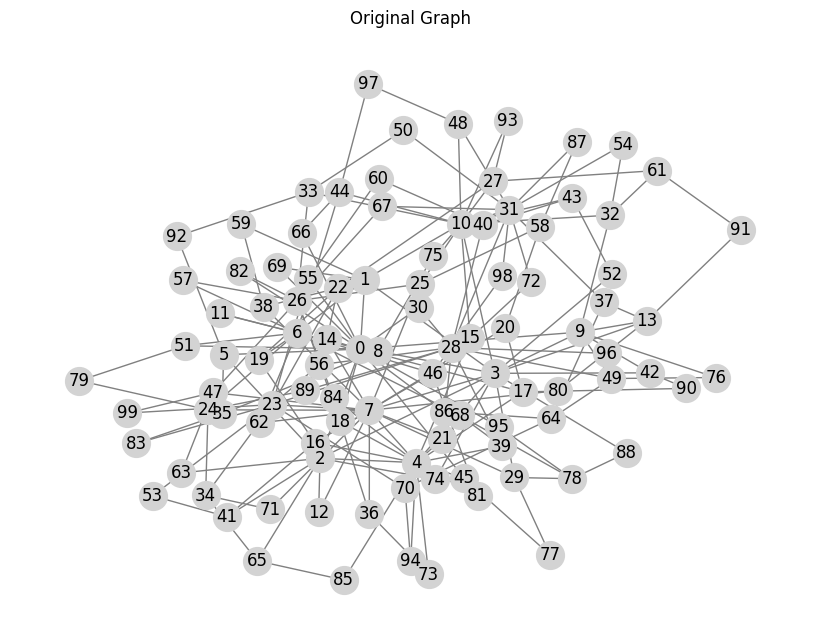



 >> 1. s_unif :

Initial Opinions:	 ['0.68', '-0.13', '0.08', '0.79', '-0.34', '0.74', '-1.00', '-0.58', '0.56', '0.07', '0.01', '0.51', '-0.66', '-0.06', '-0.42', '0.68', '-0.60', '-0.99', '0.26', '-0.79', '-0.61', '0.00', '-0.28', '0.21', '0.55', '0.95', '0.21', '-0.36', '-0.46', '-0.08', '0.42', '0.49', '-0.44', '-0.88', '0.83', '0.17', '-0.71', '-0.10', '-0.90', '-0.21', '-0.14', '-0.44', '0.04', '-0.74', '-0.96', '0.92', '0.25', '0.63', '0.02', '0.14', '-0.79', '0.10', '0.30', '0.76', '-0.17', '-0.41', '-0.53', '0.67', '0.43', '0.85', '-0.12', '0.16', '-0.62', '-0.09', '0.29', '-0.13', '0.40', '0.62', '0.55', '0.91', '-0.92', '-0.59', '0.43', '-0.90', '-0.12', '0.24', '0.93', '0.75', '0.31', '0.36', '0.76', '-0.73', '0.20', '-0.77', '0.08', '-0.88', '0.26', '0.75', '0.31', '0.49', '0.09', '-0.23', '-0.07', '-0.03', '-0.77', '-0.48', '0.11', '0.22', '0.08', '0.82']
Final Opinions:		 ['0.19', '0.05', '0.04', '0.20', '-0.14', '0.22', '-0.21', '-0.16', '0.24', '0.11', '-0.00', '0.09

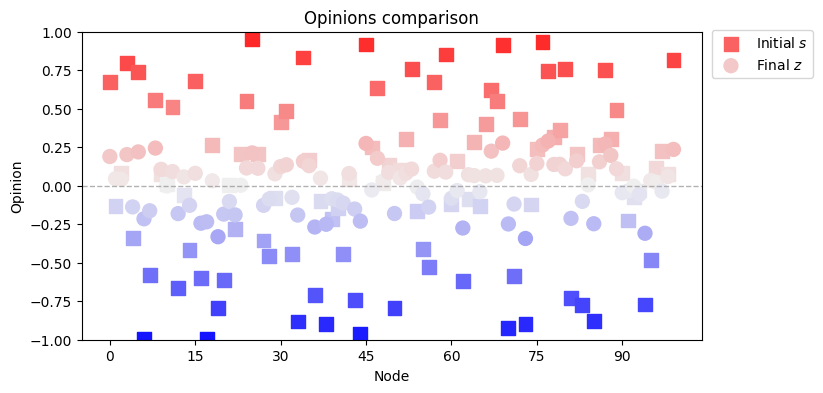

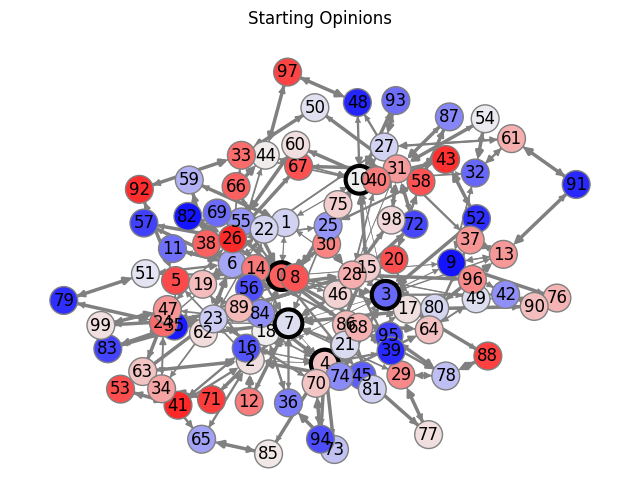

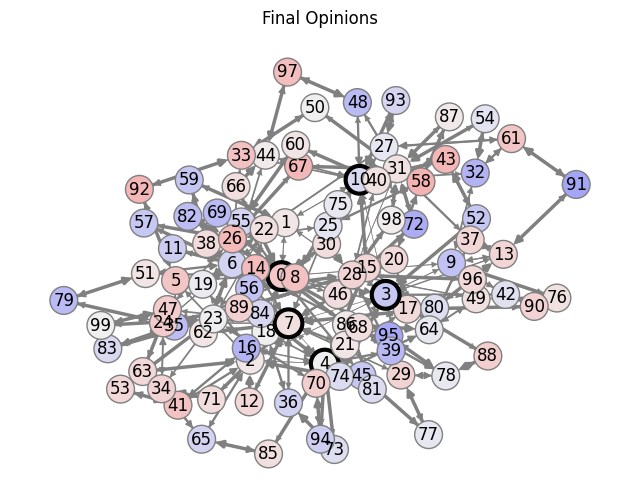



 >> 2. s_B2(1) :

Initial Opinions:	 ['1.00', '0.32', '0.48', '0.65', '0.79', '0.23', '0.58', '0.87', '0.23', '0.36', '0.71', '0.14', '0.13', '0.27', '0.18', '0.13', '0.27', '0.24', '0.23', '0.17', '0.18', '0.18', '0.27', '0.53', '0.28', '0.22', '0.45', '0.22', '0.53', '0.23', '0.13', '0.53', '0.22', '0.23', '0.23', '0.19', '0.19', '0.17', '0.18', '0.18', '0.23', '0.18', '0.18', '0.18', '0.24', '0.19', '0.29', '0.24', '0.18', '0.27', '0.13', '0.19', '0.13', '0.13', '0.13', '0.18', '0.13', '0.13', '0.19', '0.13', '0.13', '0.17', '0.13', '0.13', '0.23', '0.19', '0.14', '0.13', '0.18', '0.14', '0.18', '0.13', '0.13', '0.14', '0.13', '0.13', '0.12', '0.14', '0.25', '0.14', '0.13', '0.13', '0.14', '0.13', '0.13', '0.14', '0.13', '0.13', '0.13', '0.13', '0.13', '0.12', '0.13', '0.13', '0.14', '0.14', '0.13', '0.13', '0.13', '0.13']
Final Opinions:		 ['0.50', '0.39', '0.40', '0.43', '0.46', '0.35', '0.41', '0.47', '0.36', '0.36', '0.42', '0.39', '0.37', '0.33', '0.38', '0.38', '0.36', '0.37

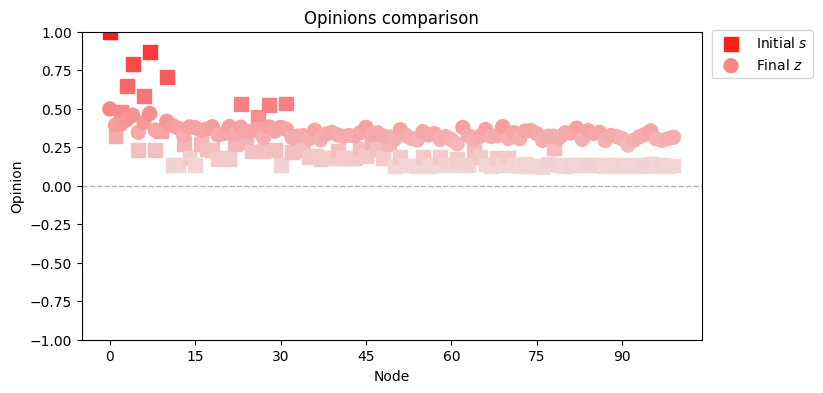

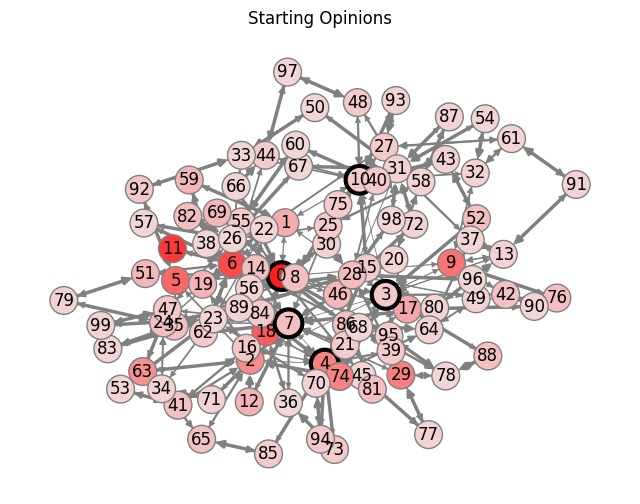

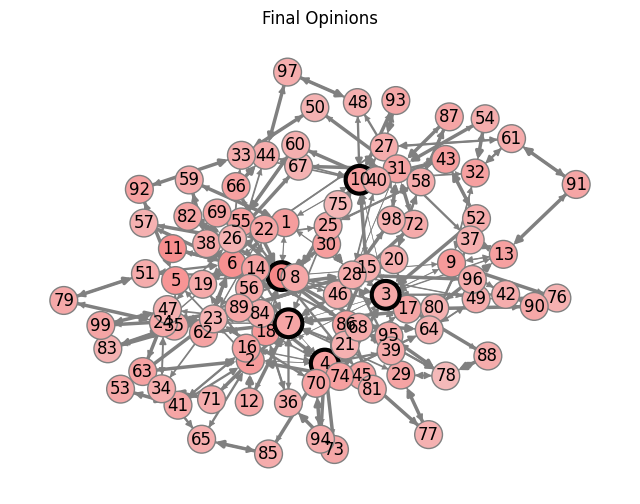



 >> 3. s_B2(t) :

Initial Opinions:	 ['1.00', '0.32', '0.48', '0.65', '0.79', '0.23', '0.58', '0.87', '0.23', '0.36', '0.71', '0.14', '0.13', '0.27', '0.18', '0.13', '0.27', '0.24', '0.23', '0.17', '0.18', '0.18', '0.27', '0.53', '0.28', '0.22', '0.45', '0.22', '0.53', '0.23', '0.13', '0.53', '0.22', '0.23', '0.23', '0.19', '0.19', '0.17', '0.18', '0.18', '0.23', '0.18', '0.18', '0.18', '0.24', '0.19', '0.29', '0.24', '0.18', '0.27', '0.13', '0.19', '0.13', '0.13', '0.13', '0.18', '0.13', '0.13', '0.19', '0.13', '0.13', '0.17', '0.13', '0.13', '0.23', '0.19', '0.14', '0.13', '0.18', '0.14', '0.18', '0.13', '0.13', '0.14', '0.13', '0.13', '0.12', '0.14', '0.25', '0.14', '0.13', '0.13', '0.14', '0.13', '0.13', '0.14', '0.13', '0.13', '0.13', '0.13', '0.13', '0.12', '0.13', '0.13', '0.14', '0.14', '0.13', '0.13', '0.13', '0.13']
Final Opinions:		 ['0.50', '0.39', '0.40', '0.43', '0.46', '0.35', '0.41', '0.47', '0.36', '0.36', '0.42', '0.39', '0.37', '0.33', '0.38', '0.38', '0.36', '0.37

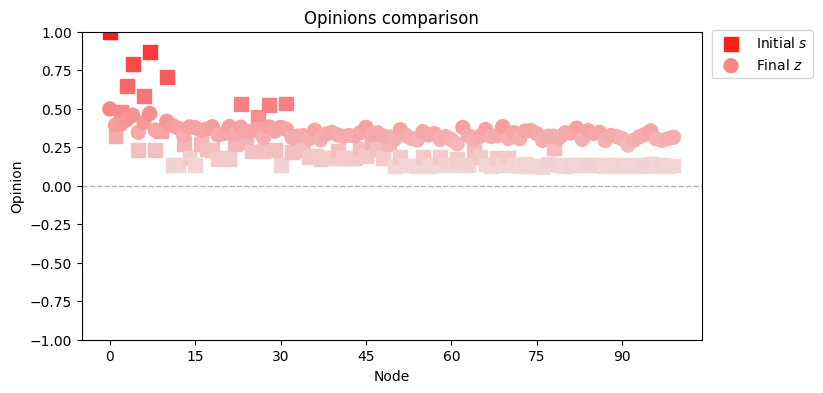

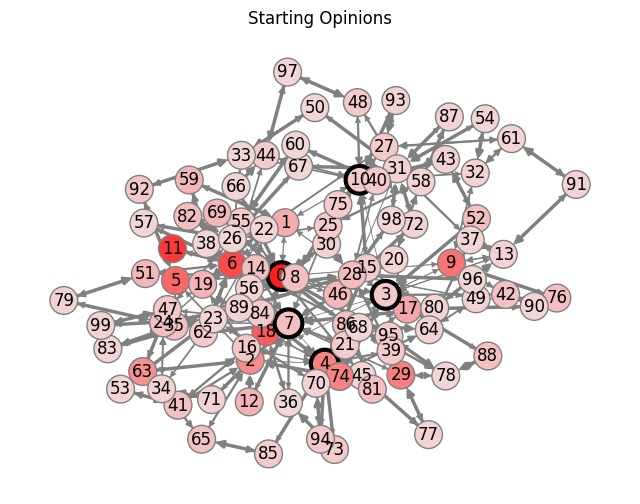

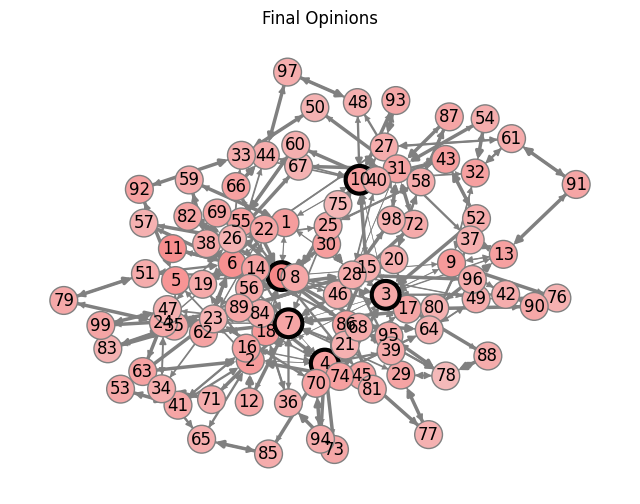



 >> 4. s_max^P2P3 :

Initial Opinions:	 ['1.00', '1.00', '1.00', '1.00', '1.00', '0.76', '1.00', '1.00', '0.74', '1.00', '1.00', '0.41', '0.41', '0.94', '0.55', '0.41', '0.88', '0.74', '0.71', '0.57', '0.59', '0.55', '0.91', '1.00', '0.93', '0.72', '1.00', '0.77', '1.00', '0.74', '0.41', '1.00', '0.77', '0.78', '0.77', '0.62', '0.58', '0.60', '0.60', '0.57', '0.76', '0.60', '0.59', '0.60', '0.77', '0.58', '0.96', '0.77', '0.60', '0.95', '0.44', '0.59', '0.43', '0.44', '0.44', '0.59', '0.42', '0.42', '0.62', '0.44', '0.45', '0.64', '0.41', '0.43', '0.80', '0.61', '0.42', '0.43', '0.59', '0.41', '0.62', '0.42', '0.44', '0.43', '0.41', '0.42', '0.44', '0.44', '0.80', '0.44', '0.42', '0.43', '0.42', '0.44', '0.42', '0.43', '0.43', '0.45', '0.43', '0.43', '0.44', '0.46', '0.45', '0.43', '0.43', '0.43', '0.44', '0.45', '0.44', '0.43']
Final Opinions:		 ['0.80', '0.82', '0.80', '0.82', '0.80', '0.75', '0.81', '0.80', '0.76', '0.82', '0.80', '0.72', '0.72', '0.80', '0.75', '0.72', '0.80', '0

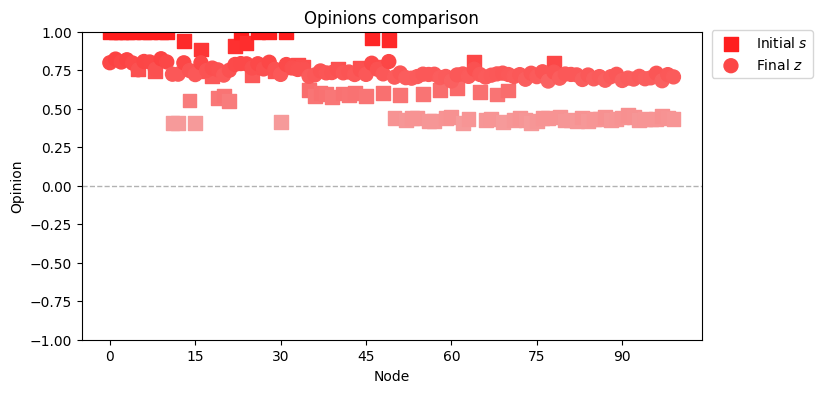

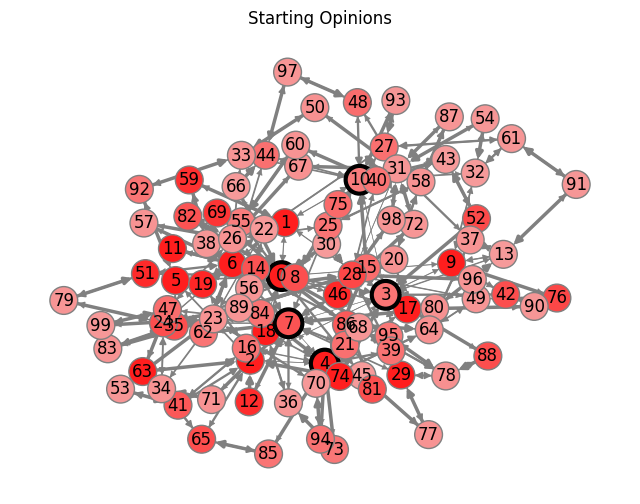

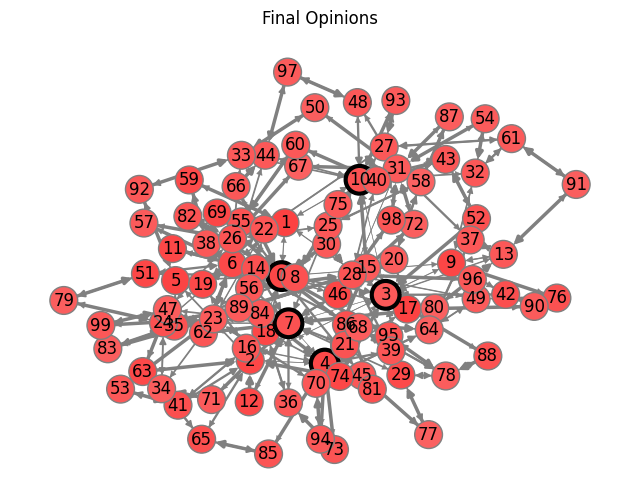



 >> 5. s_B1(1) :

Initial Opinions:	 ['1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00']
Final Opinions:		 ['0.28', '0.08', '0.05', '0.03', '0.03', '0.08', '0.06', '0.02', '0.08', '0.05', '0.02', '0.13', '0.03', '0.02', '0.09', '0.02', '0.02', '0.08

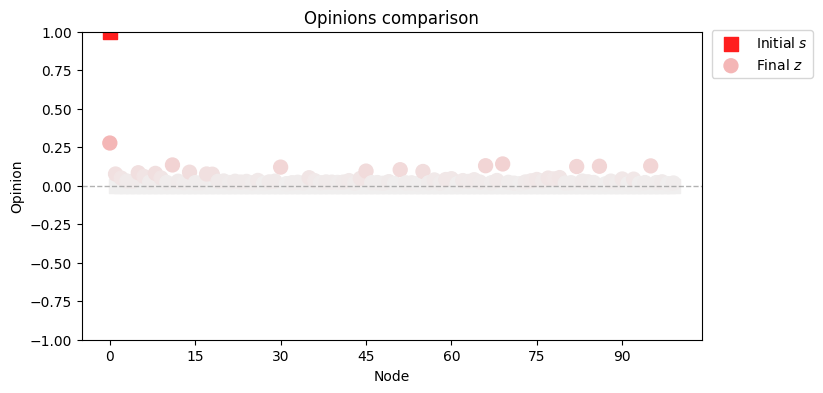

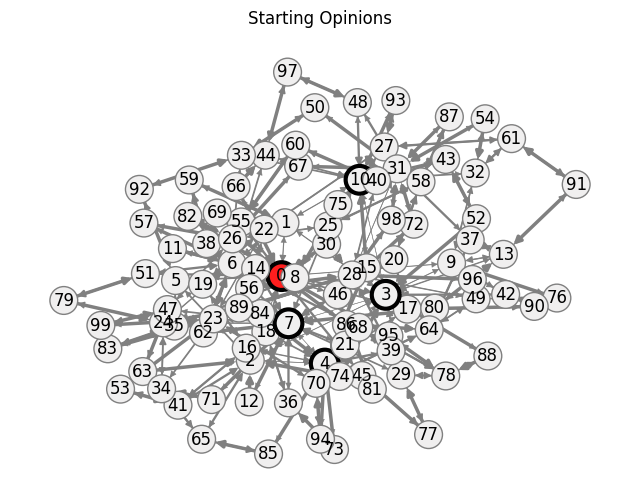

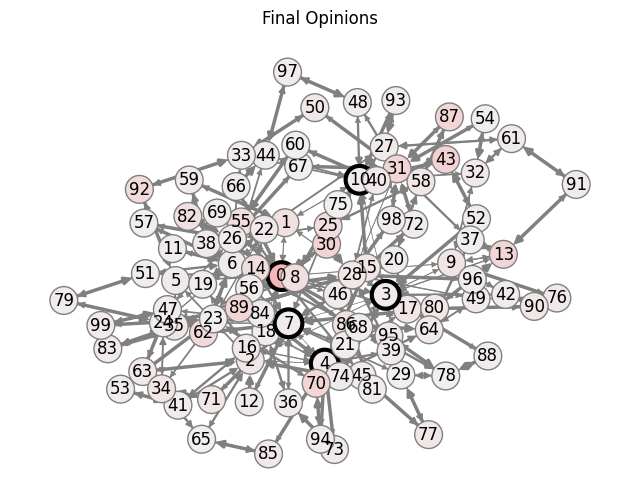



 >> 6. s_max^P4 :

Initial Opinions:	 ['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.00', '0.00', '1.00', '0.00', '0.00', '1.00', '1.00', '0.00', '0.00', '0.00', '0.00', '1.00', '1.00', '1.00', '0.00', '1.00', '1.00', '1.00', '1.00', '0.00', '1.00', '1.00', '1.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '1.00', '0.00', '1.00', '1.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00']
Final Opinions:		 ['0.65', '0.69', '0.66', '0.70', '0.63', '0.66', '0.67', '0.65', '0.67', '0.71', '0.68', '0.53', '0.52', '0.66', '0.52', '0.52', '0.67', '0.6

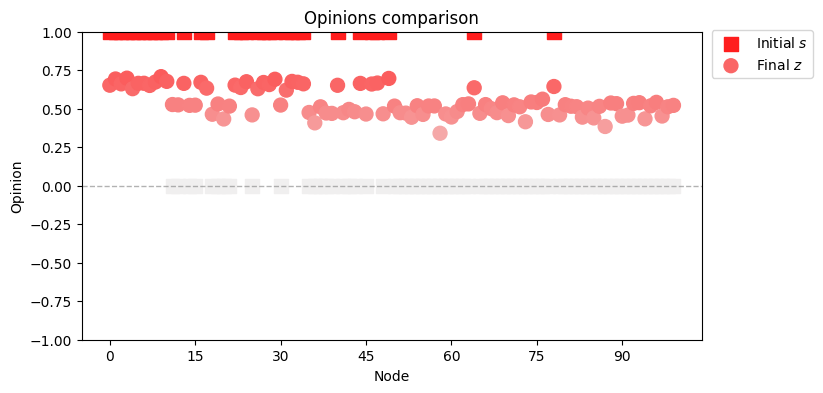

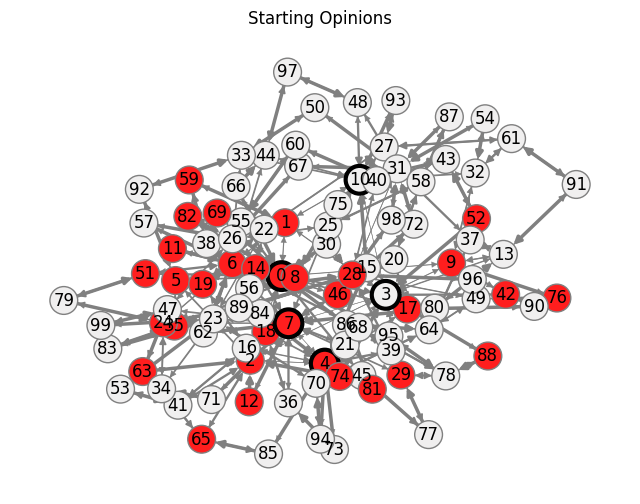

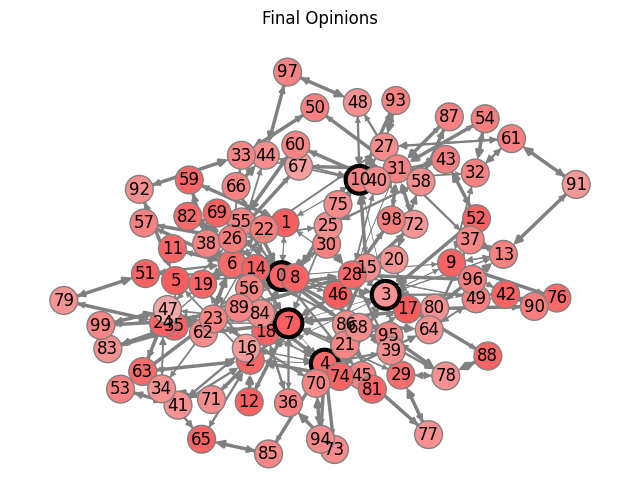

         s      GDI    NDI     P1    P2     P3     P4
    s_unif -2730.45 -46.01 -27.30 -0.27 -27.32 -32.37
   s_B2(1)  -258.03 -14.92  -2.58  0.04   4.03  11.60
   s_B2(t)  -258.03 -14.92  -2.58  0.04   4.03  11.60
s_max^P2P3  -426.52 -15.74  -4.27  0.12  11.98  11.98
   s_B1(1)   -83.35  -7.06  -0.83 -0.01  -0.67   3.18
  s_max^P4 -2097.50 -68.86 -20.97 -0.01  -1.46  22.54


In [15]:
# get graph
n = 100
m = 2
G = nx.barabasi_albert_graph(n, m, seed=500)

#original graph
pos = nx.spring_layout(G)
plt.figure(figsize=(8, 6))
nx.draw(G, pos, with_labels=True, node_color='lightgray', edge_color='gray', node_size=400)
plt.title("Original Graph")
plt.show()

# define W
A = nx.to_numpy_array(G)
W = A / A.sum(axis=1, keepdims=True)

# print("Weights:")
# print_W(W)

# Lambda const 0.8
lambda_vals = np.full(n, 0.8)
Lambda = np.diag(lambda_vals)

# s_unif
s_unif = np.random.uniform(-1, 1, n)
# sB2(1)
s_b2_1 = find_polarizing_s_for_P2_P3(Lambda, W)
# sB2(t)
s_b2_t = s_b2_1 / np.max(np.abs(s_b2_1))
# s_max^P2P3(1)
s_max_P2P3 = get_s_max_P2P3(Lambda, W)
# sB1(1)
s_b1_1 = find_polarizing_s_for_P4(Lambda, W)
# s_max^P4(1)
s_max_P4 = get_s_max_P4(Lambda, W)

s_all = {"s_unif": s_unif, "s_B2(1)": s_b2_1, "s_B2(t)": s_b2_t, "s_max^P2P3": s_max_P2P3, "s_B1(1)": s_b1_1, "s_max^P4": s_max_P4}

i = 1
rows = []
for name, s in s_all.items():
    print(f"\n\n >> {i}. {name} :\n")
    metrics = barabasi_albert_template(s, Lambda, W)

    # table
    row = {"s": name}
    row.update(metrics)
    rows.append(row)
    i += 1

df = pd.DataFrame(rows)
print(df.to_string(index=False))


lambda prop centrality

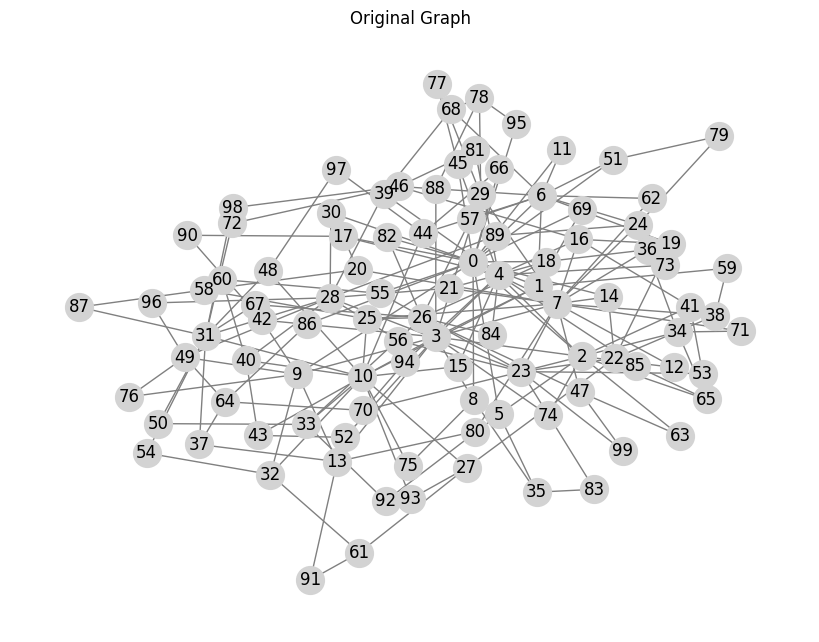



 >> 1. s_unif :

Initial Opinions:	 ['-0.20', '0.43', '-0.57', '0.73', '-0.59', '-0.23', '-0.31', '0.05', '0.27', '0.87', '-0.69', '0.68', '-0.26', '-0.22', '0.93', '0.14', '-0.78', '0.10', '-0.90', '0.89', '-0.59', '0.92', '0.22', '0.08', '-0.67', '-0.31', '0.95', '-0.67', '0.44', '-0.11', '-0.41', '-0.67', '0.76', '0.91', '-0.83', '-0.49', '-0.51', '0.68', '0.07', '-0.68', '0.38', '0.00', '0.26', '0.18', '0.95', '0.11', '0.01', '0.94', '0.16', '-0.46', '0.50', '0.06', '0.75', '-0.83', '0.96', '0.79', '-0.30', '0.63', '0.94', '0.79', '-0.68', '0.22', '-0.10', '0.69', '-0.17', '-0.10', '-0.73', '0.75', '0.48', '0.62', '0.20', '-0.08', '0.46', '-0.17', '0.27', '-0.82', '-0.78', '0.97', '0.30', '-0.08', '0.20', '0.75', '0.35', '0.89', '-0.62', '0.09', '0.56', '0.18', '-0.51', '-0.27', '-0.27', '-0.39', '0.30', '0.69', '0.28', '-0.27', '0.37', '-0.95', '0.76', '-0.45']
Final Opinions:		 ['-0.09', '0.41', '-0.47', '0.57', '-0.44', '-0.23', '-0.19', '0.03', '0.24', '0.76', '-0.46', '0.65'

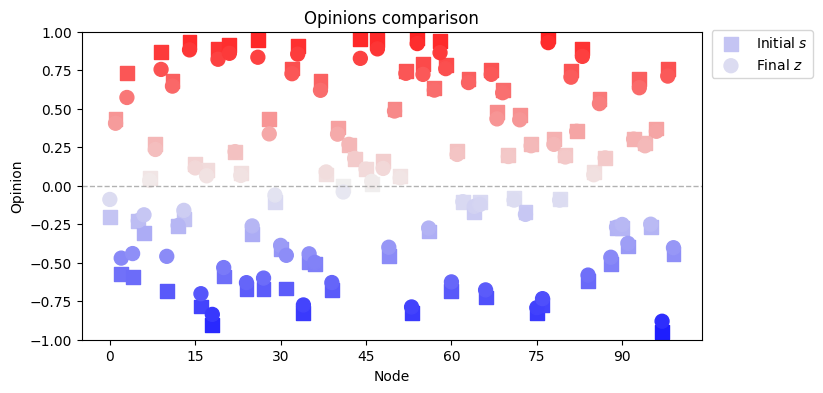

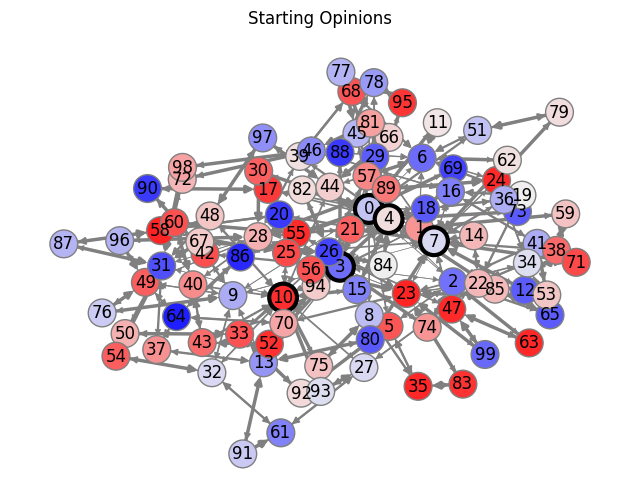

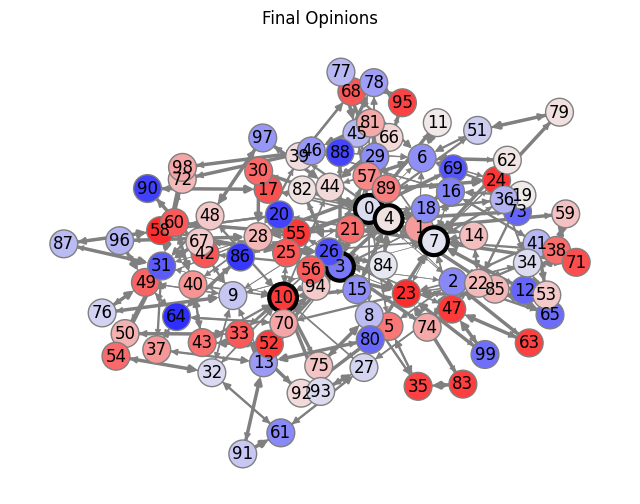



 >> 2. s_B2(1) :

Initial Opinions:	 ['-0.85', '-1.00', '-0.96', '-0.94', '-0.90', '-0.96', '-0.94', '-0.88', '-0.98', '-0.98', '-0.90', '-0.96', '-0.96', '-0.96', '-1.00', '-0.96', '-0.99', '-0.97', '-1.00', '-0.98', '-0.96', '-1.00', '-0.98', '-0.93', '-0.97', '-0.99', '-0.94', '-0.96', '-0.94', '-0.97', '-0.96', '-0.91', '-0.96', '-0.95', '-0.95', '-0.93', '-0.96', '-0.95', '-0.96', '-0.97', '-0.96', '-0.95', '-0.96', '-0.95', '-0.96', '-0.97', '-0.95', '-0.96', '-0.94', '-0.96', '-0.91', '-0.96', '-0.93', '-0.92', '-0.92', '-0.95', '-0.94', '-0.94', '-0.93', '-0.93', '-0.91', '-0.92', '-0.96', '-0.93', '-0.94', '-0.94', '-0.94', '-0.93', '-0.96', '-0.96', '-0.93', '-0.94', '-0.92', '-0.93', '-0.96', '-0.94', '-0.93', '-0.92', '-0.94', '-0.92', '-0.94', '-0.93', '-0.95', '-0.91', '-0.95', '-0.92', '-0.93', '-0.90', '-0.93', '-0.93', '-0.91', '-0.90', '-0.91', '-0.93', '-0.92', '-0.93', '-0.93', '-0.90', '-0.92', '-0.92']
Final Opinions:		 ['-0.89', '-0.99', '-0.96', '-0.94', '-0.9

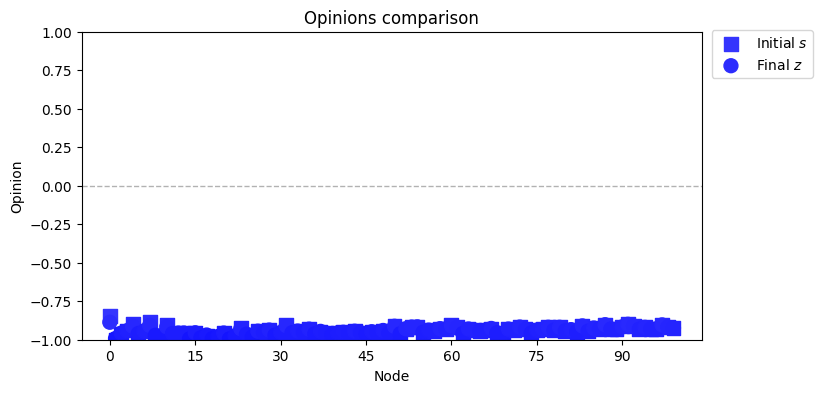

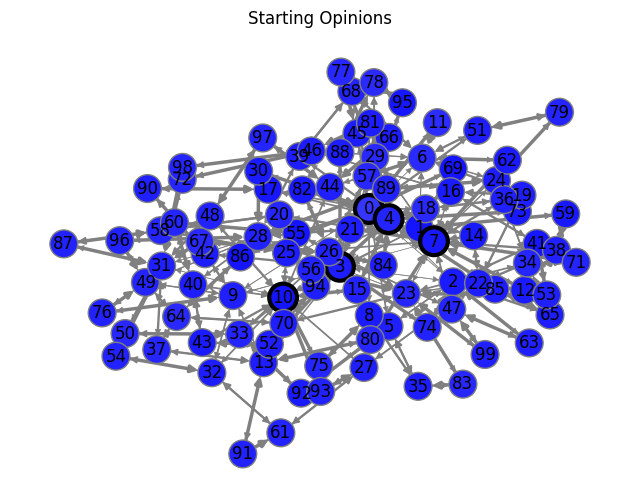

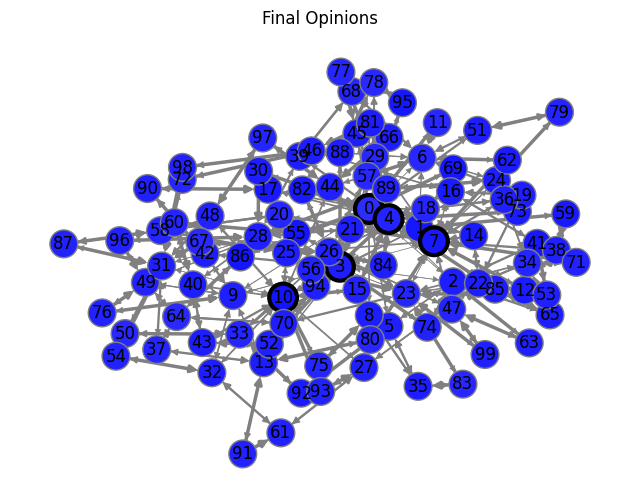



 >> 3. s_B2(t) :

Initial Opinions:	 ['-0.85', '-1.00', '-0.96', '-0.94', '-0.90', '-0.96', '-0.94', '-0.88', '-0.98', '-0.98', '-0.90', '-0.96', '-0.96', '-0.96', '-1.00', '-0.96', '-0.99', '-0.97', '-1.00', '-0.98', '-0.96', '-1.00', '-0.98', '-0.93', '-0.97', '-0.99', '-0.94', '-0.96', '-0.94', '-0.97', '-0.96', '-0.91', '-0.96', '-0.95', '-0.95', '-0.93', '-0.96', '-0.95', '-0.96', '-0.97', '-0.96', '-0.95', '-0.96', '-0.95', '-0.96', '-0.97', '-0.95', '-0.96', '-0.94', '-0.96', '-0.91', '-0.96', '-0.93', '-0.92', '-0.92', '-0.95', '-0.94', '-0.94', '-0.93', '-0.93', '-0.91', '-0.92', '-0.96', '-0.93', '-0.94', '-0.94', '-0.94', '-0.93', '-0.96', '-0.96', '-0.93', '-0.94', '-0.92', '-0.93', '-0.96', '-0.94', '-0.93', '-0.92', '-0.94', '-0.92', '-0.94', '-0.93', '-0.95', '-0.91', '-0.95', '-0.92', '-0.93', '-0.90', '-0.93', '-0.93', '-0.91', '-0.90', '-0.91', '-0.93', '-0.92', '-0.93', '-0.93', '-0.90', '-0.92', '-0.92']
Final Opinions:		 ['-0.89', '-0.99', '-0.96', '-0.94', '-0.9

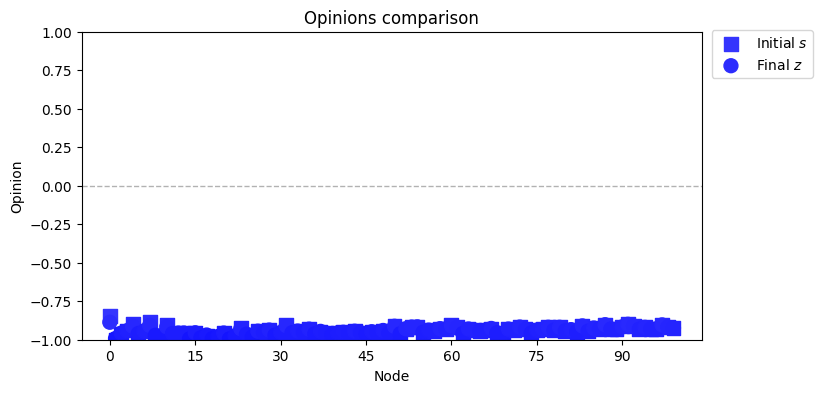

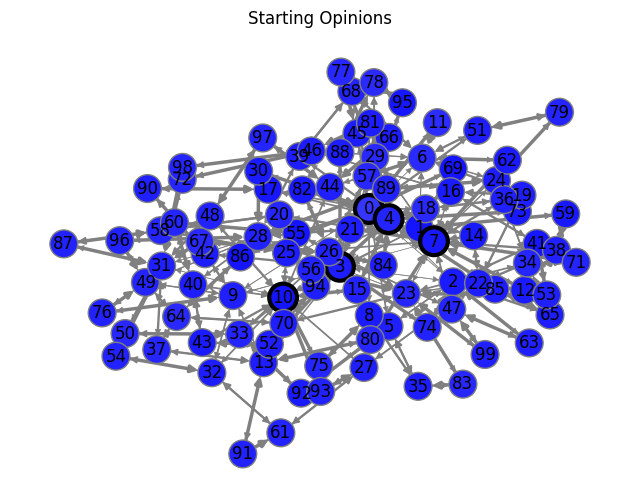

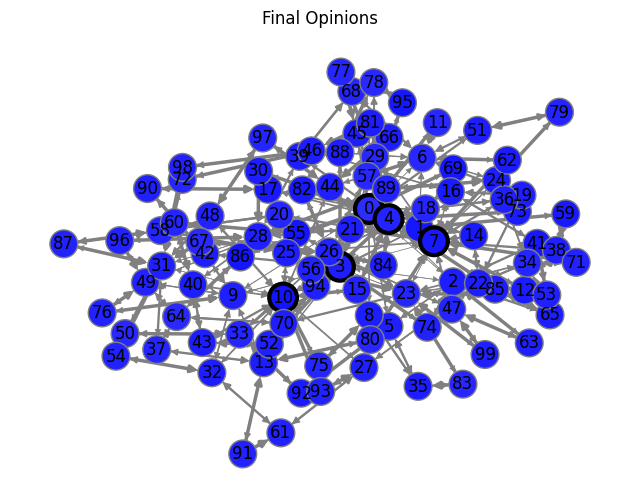



 >> 4. s_max^P2P3 :

Initial Opinions:	 ['0.87', '1.00', '0.99', '0.96', '0.92', '0.99', '0.96', '0.90', '1.00', '1.00', '0.93', '0.99', '0.98', '0.99', '1.00', '0.98', '1.00', '1.00', '1.00', '1.00', '0.98', '1.00', '1.00', '0.95', '0.99', '1.00', '0.96', '0.98', '0.96', '1.00', '0.98', '0.93', '0.98', '0.97', '0.98', '0.96', '0.98', '0.98', '0.98', '1.00', '0.99', '0.97', '0.98', '0.97', '0.98', '0.99', '0.97', '0.98', '0.97', '0.99', '0.94', '0.99', '0.95', '0.94', '0.94', '0.98', '0.97', '0.97', '0.95', '0.94', '0.93', '0.95', '0.98', '0.96', '0.97', '0.97', '0.96', '0.95', '0.98', '0.98', '0.96', '0.96', '0.94', '0.95', '0.98', '0.96', '0.96', '0.94', '0.96', '0.94', '0.97', '0.96', '0.97', '0.94', '0.97', '0.95', '0.96', '0.93', '0.96', '0.96', '0.94', '0.93', '0.94', '0.96', '0.95', '0.96', '0.96', '0.93', '0.94', '0.95']
Final Opinions:		 ['0.91', '0.99', '0.98', '0.96', '0.93', '0.99', '0.97', '0.93', '1.00', '1.00', '0.94', '0.98', '0.98', '0.98', '1.00', '0.98', '1.00', '0

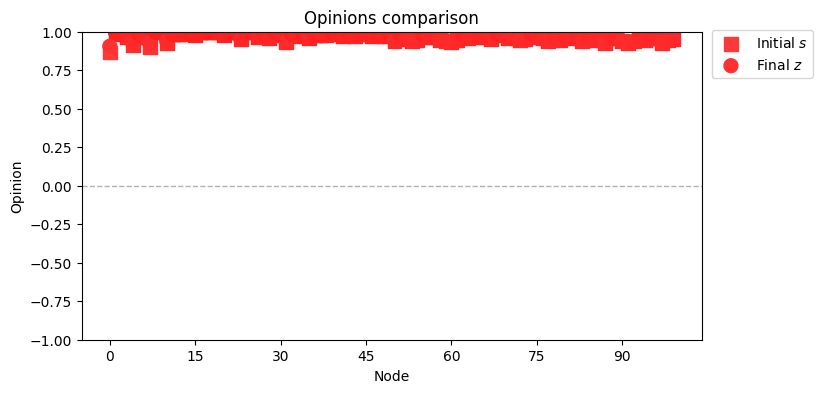

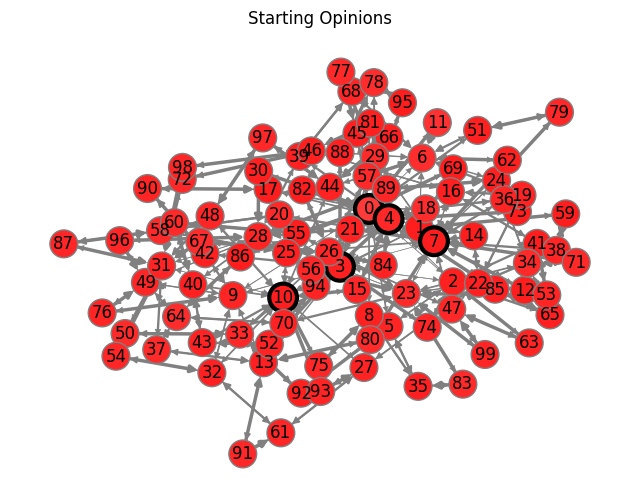

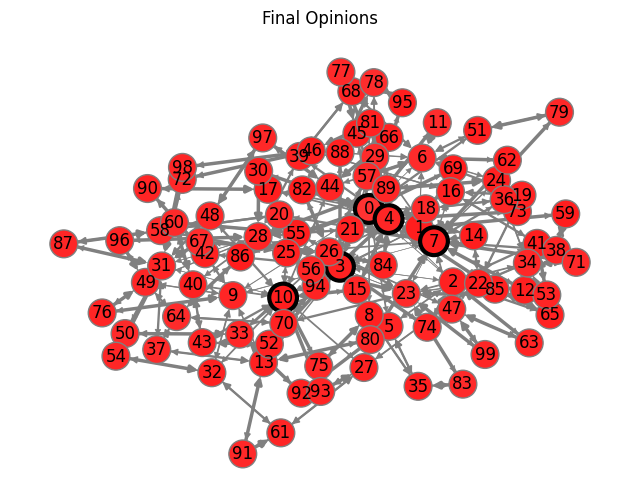



 >> 5. s_B1(1) :

Initial Opinions:	 ['0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00']
Final Opinions:		 ['0.02', '0.89', '0.00', '0.02', '0.00', '0.00', '0.02', '0.00', '0.00', '0.00', '0.02', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00

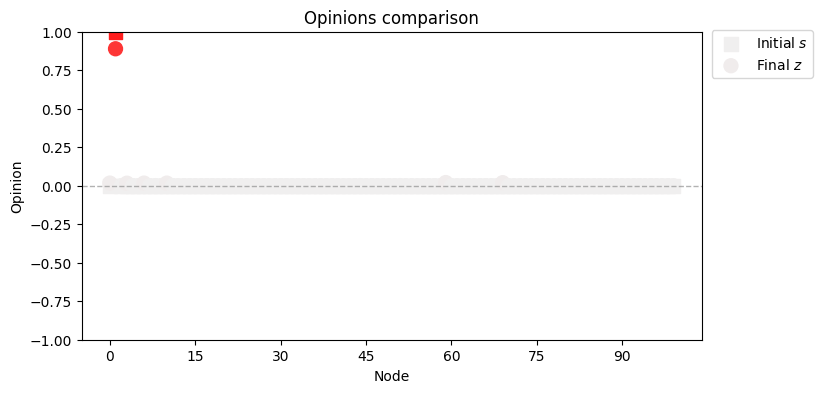

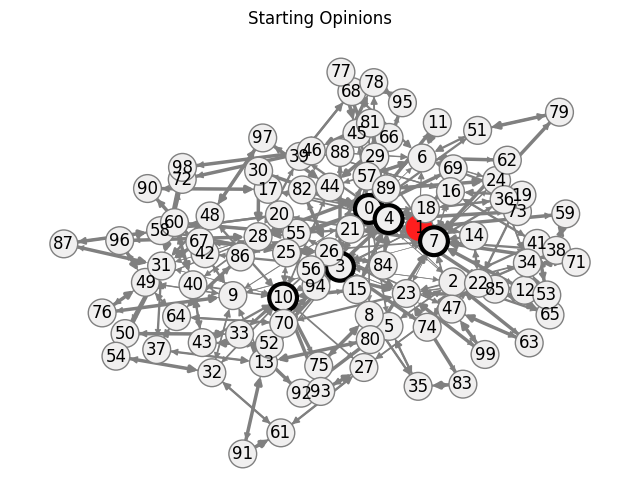

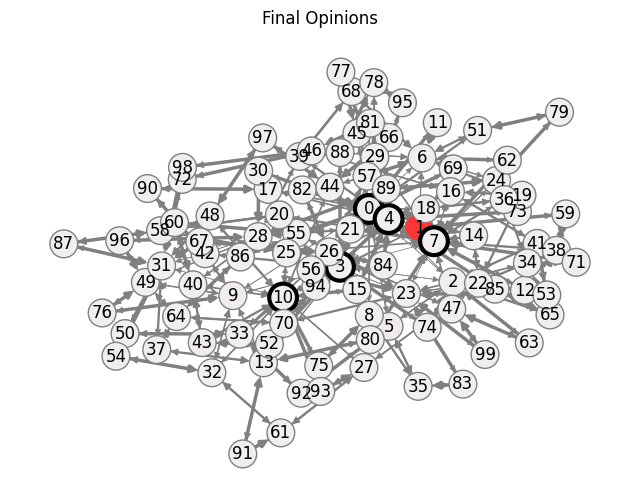



 >> 6. s_max^P4 :

Initial Opinions:	 ['0.00', '1.00', '1.00', '0.00', '0.00', '1.00', '0.00', '0.00', '1.00', '1.00', '0.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.00', '1.00', '1.00', '0.00', '1.00', '0.00', '1.00', '1.00', '0.00', '1.00', '1.00', '1.00', '0.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.99', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.00', '1.00', '0.00', '0.00', '0.00', '1.00', '1.00', '0.09', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.15', '1.00', '0.73', '1.00', '1.00', '1.00', '1.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '1.00', '1.00', '0.00', '1.00', '0.04', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.06', '1.00', '0.00', '0.00', '0.00', '0.00']
Final Opinions:		 ['0.32', '0.92', '0.92', '0.15', '0.19', '0.94', '0.17', '0.25', '0.93', '0.95', '0.18', '0.97', '0.98', '0.96', '0.97', '0.96', '0.97', '0.9

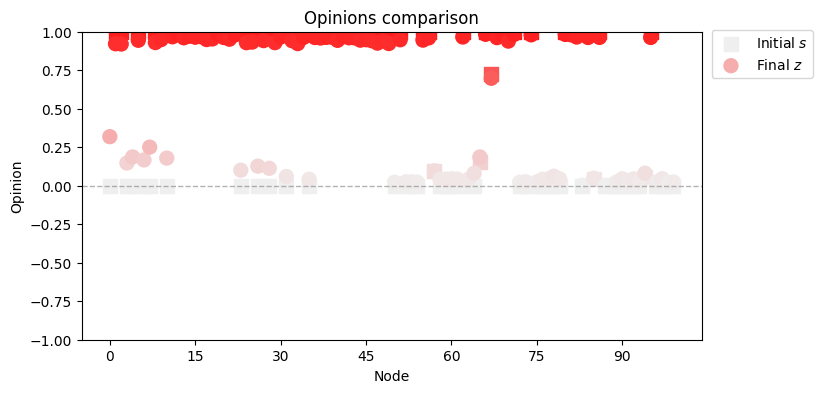

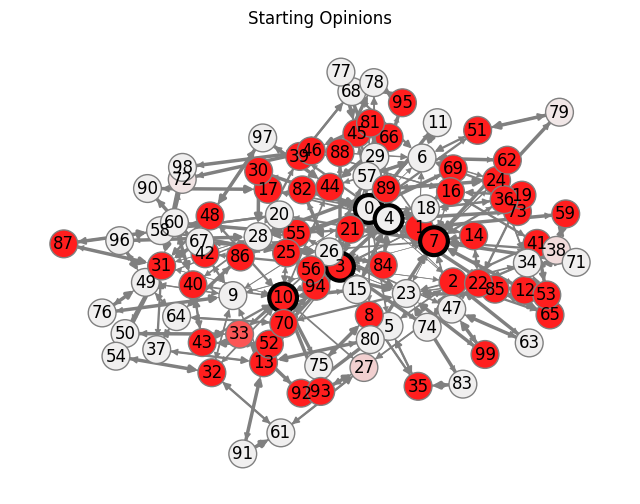

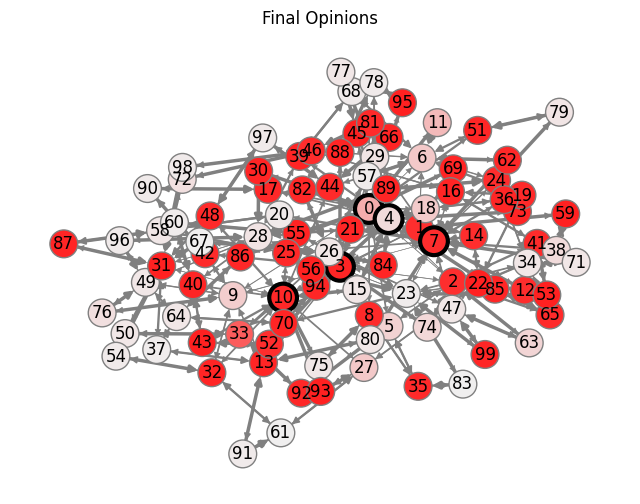

         s     GDI    NDI    P1    P2    P3    P4
    s_unif -498.02 -16.42 -4.98 -0.05 -4.97 -4.13
   s_B2(1)   -1.86  -0.11 -0.02  0.00  0.02  0.02
   s_B2(t)   -1.86  -0.11 -0.02  0.00  0.02  0.02
s_max^P2P3   -1.79  -0.11 -0.02  0.00  0.02  0.02
   s_B1(1)  -20.76  -0.55 -0.21 -0.00 -0.21  0.02
  s_max^P4 -468.57 -21.01 -4.69 -0.04 -4.41  0.24


In [16]:
# get graph
n = 100
m = 2
G = nx.barabasi_albert_graph(n, m, seed=500)

#original graph
pos = nx.spring_layout(G)
plt.figure(figsize=(8, 6))
nx.draw(G, pos, with_labels=True, node_color='lightgray', edge_color='gray', node_size=400)
plt.title("Original Graph")
plt.show()

# define W
A = nx.to_numpy_array(G)
W = A / A.sum(axis=1, keepdims=True)

# print("Weights:")
# print_W(W)

# centrality
C = nx.pagerank(G)
C = np.array([c for c in C.values()])

# Lambda const 0.8
lambda_vals = C
lambda_vals = lambda_vals / np.linalg.norm(lambda_vals)
Lambda = np.diag(lambda_vals)

# s_unif
s_unif = np.random.uniform(-1, 1, n)
# sB2(1)
s_b2_1 = find_polarizing_s_for_P2_P3(Lambda, W)
# sB2(t)
s_b2_t = s_b2_1 / np.max(np.abs(s_b2_1))
# s_max^P2P3(1)
s_max_P2P3 = get_s_max_P2P3(Lambda, W)
# sB1(1)
s_b1_1 = find_polarizing_s_for_P4(Lambda, W)
# s_max^P4(1)
s_max_P4 = get_s_max_P4(Lambda, W)

s_all = {"s_unif": s_unif, "s_B2(1)": s_b2_1, "s_B2(t)": s_b2_t, "s_max^P2P3": s_max_P2P3, "s_B1(1)": s_b1_1, "s_max^P4": s_max_P4}

i = 1
rows = []
for name, s in s_all.items():
    print(f"\n\n >> {i}. {name} :\n")
    metrics = barabasi_albert_template(s, Lambda, W)

    # table
    row = {"s": name}
    row.update(metrics)
    rows.append(row)
    i += 1

df = pd.DataFrame(rows)
print(df.to_string(index=False))


lambda reverse prop centrality

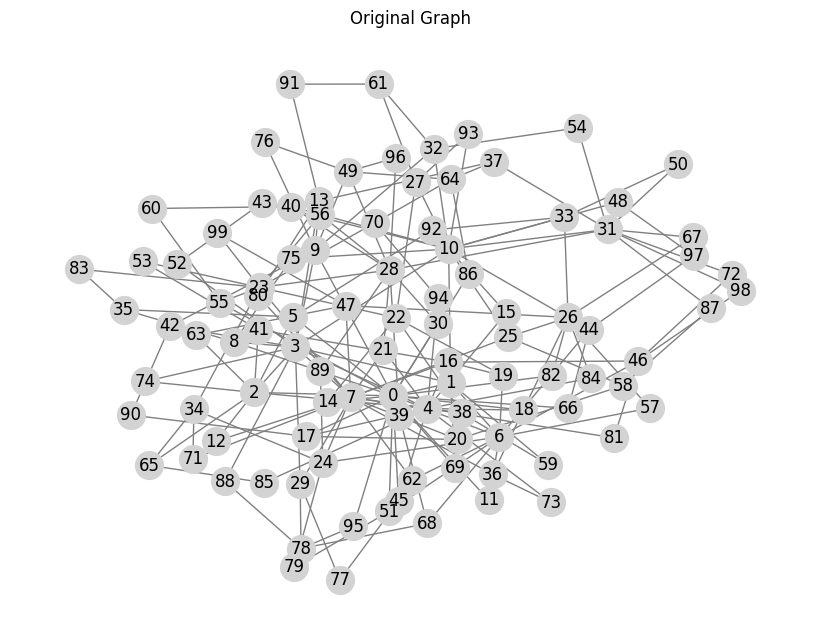



 >> 1. s_unif :

Initial Opinions:	 ['0.07', '-0.72', '-0.23', '0.70', '0.50', '0.23', '-0.96', '-0.26', '-0.51', '-0.63', '-0.21', '-0.01', '0.43', '0.04', '0.34', '0.94', '0.55', '-0.58', '0.40', '-0.07', '0.67', '0.55', '-0.67', '0.64', '-0.03', '-0.18', '-0.33', '0.12', '0.86', '0.99', '0.63', '0.65', '0.28', '0.87', '0.97', '-0.36', '-0.79', '0.53', '-0.34', '0.29', '0.84', '0.82', '-0.37', '-0.43', '0.43', '-0.58', '0.78', '-0.26', '-0.20', '-0.58', '-0.59', '-0.84', '0.04', '-0.85', '0.73', '0.66', '0.53', '-0.29', '0.76', '-0.33', '0.20', '0.25', '0.24', '-0.18', '0.85', '-0.24', '-0.09', '0.99', '0.58', '0.86', '0.49', '-0.94', '0.92', '0.15', '-0.50', '0.45', '-0.12', '-0.44', '-0.29', '-0.40', '0.30', '0.60', '-0.49', '-0.58', '-0.43', '-0.95', '-0.55', '-0.66', '0.23', '-0.95', '-0.24', '0.77', '-0.00', '-0.42', '-0.84', '-0.35', '-0.31', '0.12', '-0.34', '-0.47']
Final Opinions:		 ['0.07', '-0.68', '-0.21', '0.68', '0.49', '0.20', '-0.94', '-0.26', '-0.46', '-0.61', '-0.

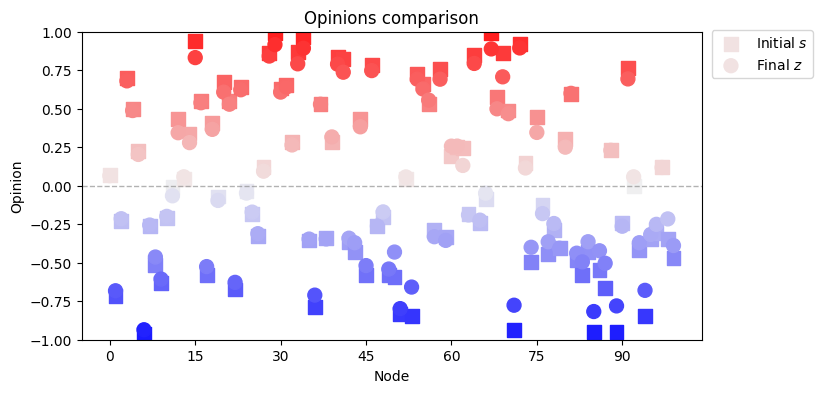

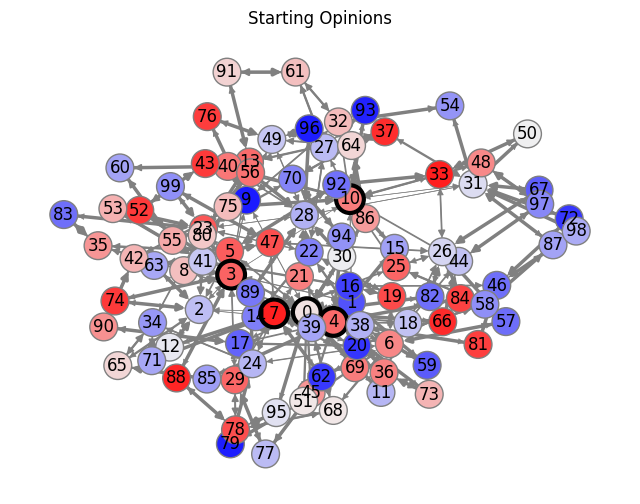

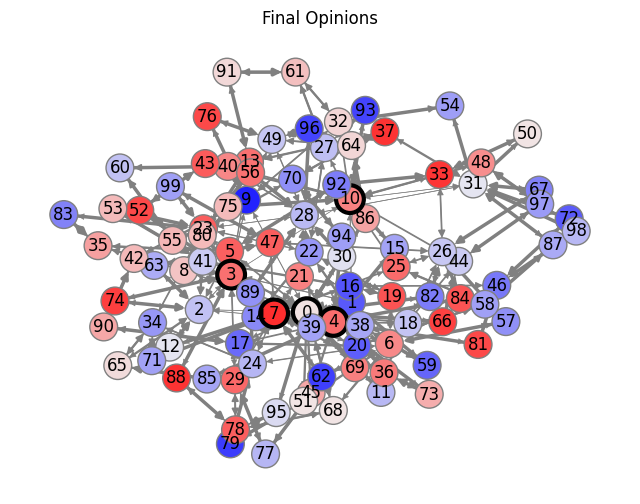



 >> 2. s_B2(1) :

Initial Opinions:	 ['-1.00', '-0.18', '-0.17', '-0.15', '-0.46', '-0.11', '-0.35', '-0.38', '-0.11', '-0.08', '-0.21', '-0.21', '-0.09', '-0.06', '-0.15', '-0.11', '-0.08', '-0.13', '-0.14', '-0.06', '-0.07', '-0.11', '-0.07', '-0.17', '-0.10', '-0.07', '-0.27', '-0.04', '-0.26', '-0.08', '-0.20', '-0.16', '-0.04', '-0.07', '-0.07', '-0.05', '-0.10', '-0.04', '-0.07', '-0.09', '-0.06', '-0.04', '-0.04', '-0.04', '-0.13', '-0.16', '-0.10', '-0.08', '-0.05', '-0.07', '-0.04', '-0.15', '-0.04', '-0.04', '-0.03', '-0.13', '-0.07', '-0.10', '-0.04', '-0.05', '-0.05', '-0.02', '-0.12', '-0.05', '-0.10', '-0.06', '-0.18', '-0.07', '-0.07', '-0.19', '-0.07', '-0.07', '-0.05', '-0.10', '-0.05', '-0.06', '-0.03', '-0.06', '-0.11', '-0.06', '-0.07', '-0.09', '-0.20', '-0.04', '-0.12', '-0.09', '-0.18', '-0.04', '-0.05', '-0.06', '-0.04', '-0.02', '-0.04', '-0.04', '-0.09', '-0.18', '-0.05', '-0.04', '-0.05', '-0.05']
Final Opinions:		 ['-0.99', '-0.18', '-0.17', '-0.15', '-0.4

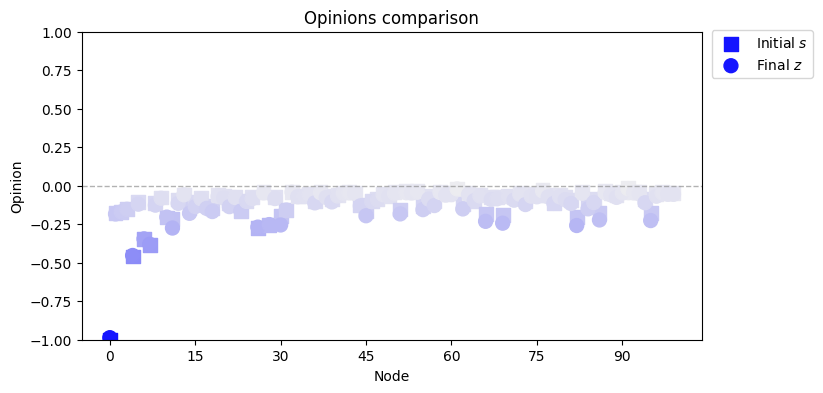

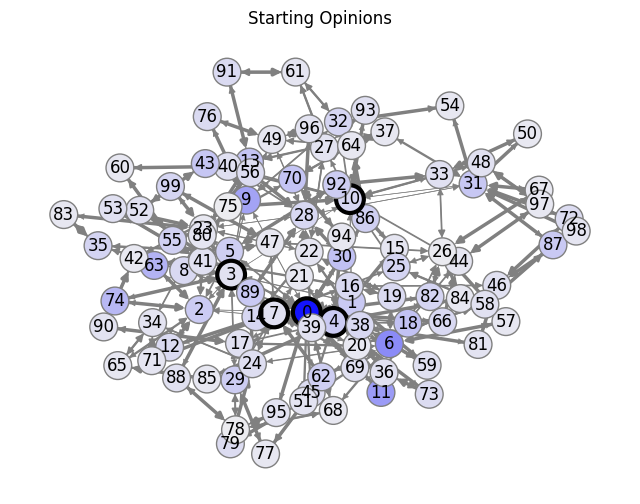

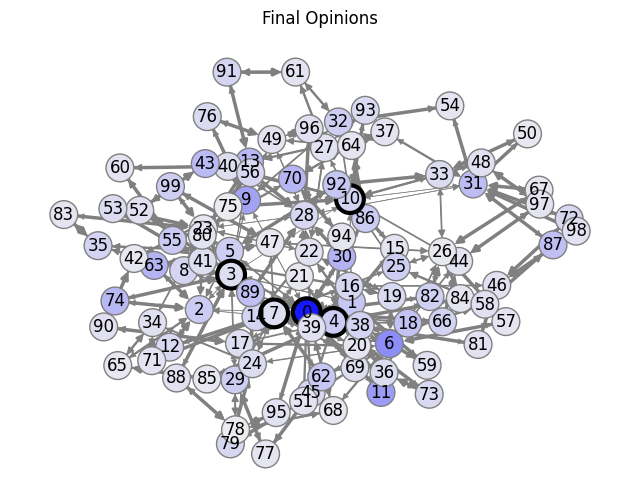



 >> 3. s_B2(t) :

Initial Opinions:	 ['-1.00', '-0.18', '-0.17', '-0.15', '-0.46', '-0.11', '-0.35', '-0.38', '-0.11', '-0.08', '-0.21', '-0.21', '-0.09', '-0.06', '-0.15', '-0.11', '-0.08', '-0.13', '-0.14', '-0.06', '-0.07', '-0.11', '-0.07', '-0.17', '-0.10', '-0.07', '-0.27', '-0.04', '-0.26', '-0.08', '-0.20', '-0.16', '-0.04', '-0.07', '-0.07', '-0.05', '-0.10', '-0.04', '-0.07', '-0.09', '-0.06', '-0.04', '-0.04', '-0.04', '-0.13', '-0.16', '-0.10', '-0.08', '-0.05', '-0.07', '-0.04', '-0.15', '-0.04', '-0.04', '-0.03', '-0.13', '-0.07', '-0.10', '-0.04', '-0.05', '-0.05', '-0.02', '-0.12', '-0.05', '-0.10', '-0.06', '-0.18', '-0.07', '-0.07', '-0.19', '-0.07', '-0.07', '-0.05', '-0.10', '-0.05', '-0.06', '-0.03', '-0.06', '-0.11', '-0.06', '-0.07', '-0.09', '-0.20', '-0.04', '-0.12', '-0.09', '-0.18', '-0.04', '-0.05', '-0.06', '-0.04', '-0.02', '-0.04', '-0.04', '-0.09', '-0.18', '-0.05', '-0.04', '-0.05', '-0.05']
Final Opinions:		 ['-0.99', '-0.18', '-0.17', '-0.15', '-0.4

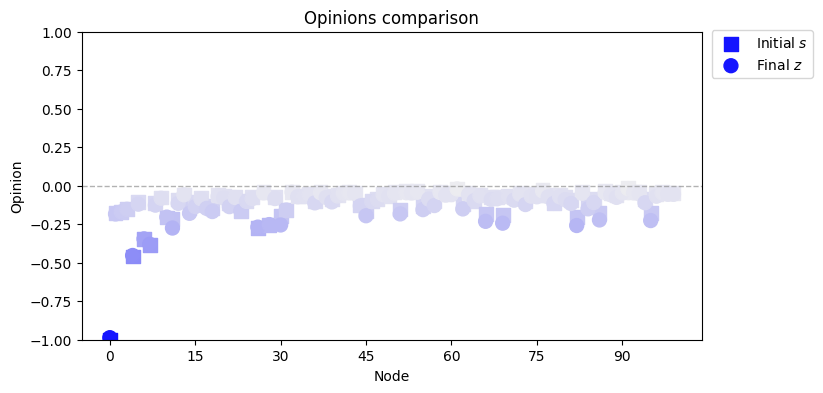

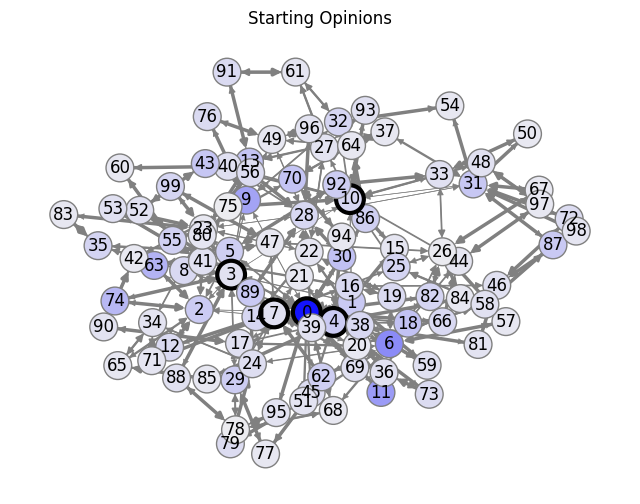

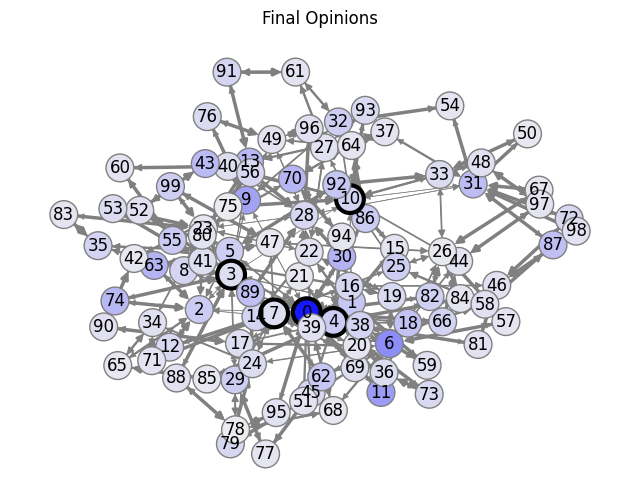



 >> 4. s_max^P2P3 :

Initial Opinions:	 ['1.00', '1.00', '1.00', '1.00', '1.00', '0.86', '1.00', '1.00', '0.81', '1.00', '1.00', '0.48', '0.48', '1.00', '0.55', '0.47', '0.87', '0.72', '0.61', '0.59', '0.55', '0.51', '1.00', '1.00', '1.00', '0.62', '1.00', '0.94', '1.00', '0.78', '0.48', '1.00', '0.88', '0.97', '0.92', '0.72', '0.58', '0.65', '0.67', '0.55', '0.77', '0.64', '0.60', '0.63', '0.90', '0.57', '1.00', '0.96', '0.61', '1.00', '0.54', '0.61', '0.47', '0.48', '0.51', '0.58', '0.49', '0.49', '0.62', '0.51', '0.45', '0.79', '0.48', '0.54', '1.00', '0.69', '0.51', '0.49', '0.62', '0.50', '0.71', '0.51', '0.52', '0.45', '0.48', '0.48', '0.53', '0.45', '1.00', '0.50', '0.51', '0.51', '0.49', '0.50', '0.49', '0.49', '0.53', '0.47', '0.54', '0.52', '0.44', '0.56', '0.55', '0.52', '0.49', '0.53', '0.52', '0.50', '0.52', '0.53']
Final Opinions:		 ['1.00', '0.99', '0.99', '1.00', '0.99', '0.86', '0.99', '0.99', '0.81', '0.99', '1.00', '0.55', '0.55', '0.99', '0.59', '0.54', '0.87', '0

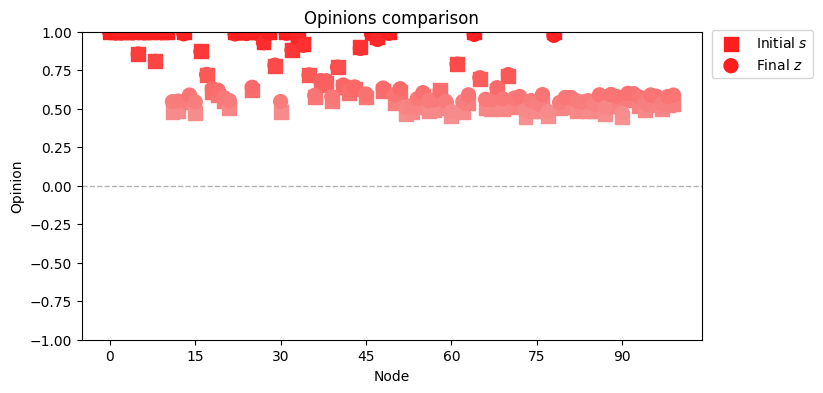

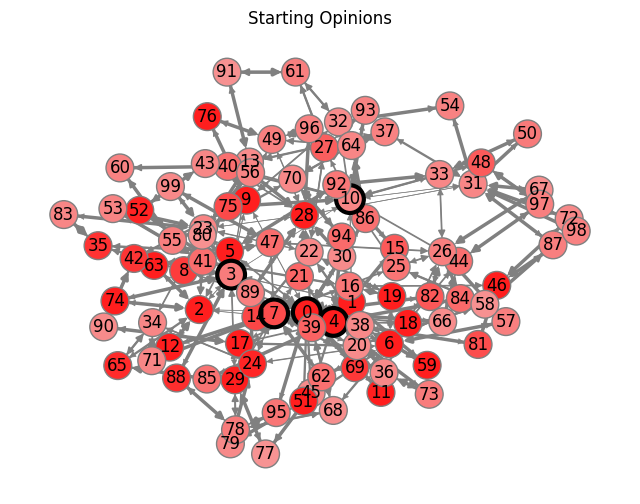

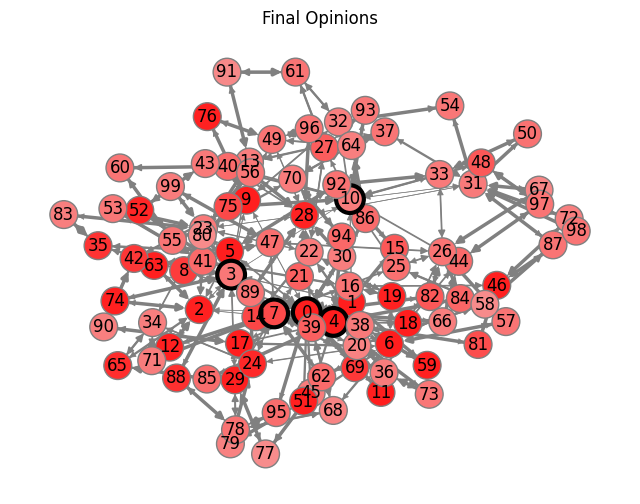



 >> 5. s_B1(1) :

Initial Opinions:	 ['1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00']
Final Opinions:		 ['0.98', '0.01', '0.00', '0.00', '0.00', '0.02', '0.00', '0.00', '0.02', '0.01', '0.00', '0.07', '0.00', '0.00', '0.03', '0.00', '0.00', '0.02

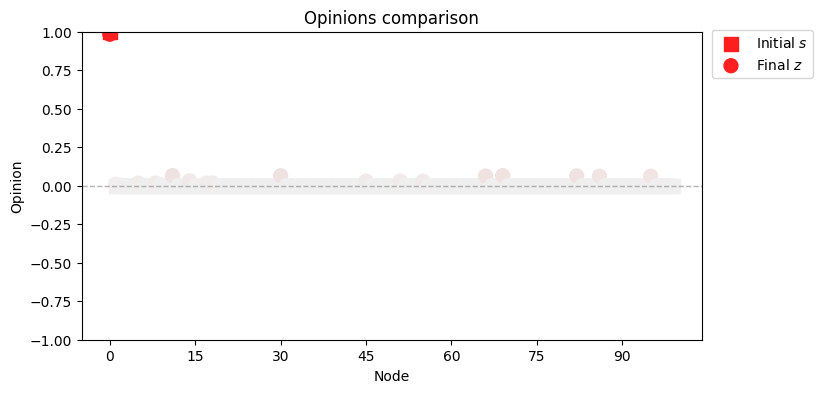

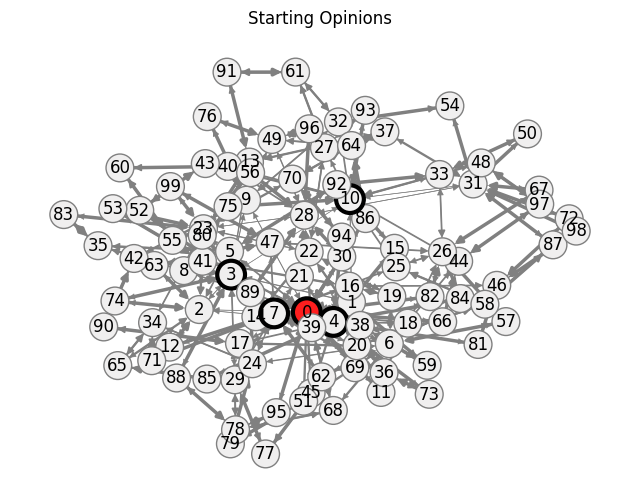

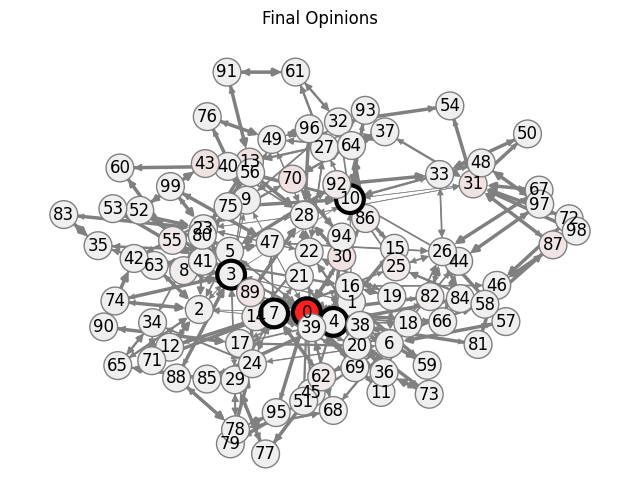



 >> 6. s_max^P4 :

Initial Opinions:	 ['1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.00', '0.00', '1.00', '0.00', '0.00', '1.00', '1.00', '0.00', '0.00', '0.00', '0.00', '1.00', '1.00', '1.00', '0.00', '1.00', '1.00', '1.00', '1.00', '0.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '1.00', '0.00', '1.00', '1.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '1.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00']
Final Opinions:		 ['0.99', '0.98', '0.98', '0.99', '0.99', '0.98', '0.99', '0.99', '0.98', '0.99', '0.99', '0.13', '0.13', '0.97', '0.10', '0.13', '0.98', '0.9

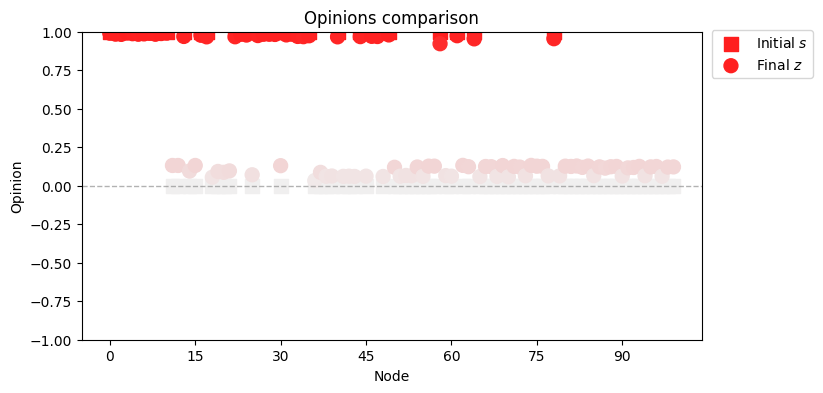

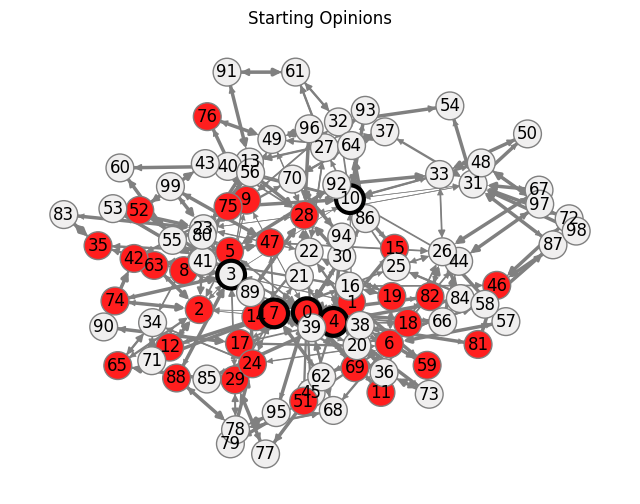

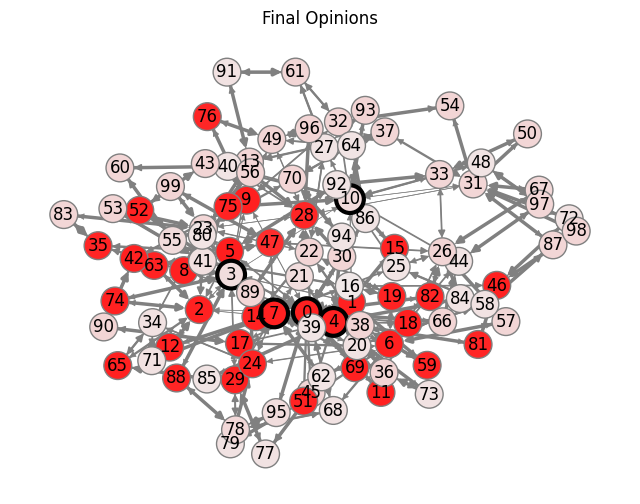

         s     GDI    NDI    P1    P2    P3    P4
    s_unif -545.31 -12.65 -5.45 -0.05 -5.41 -4.21
   s_B2(1)    0.51  -0.87  0.01  0.00  0.30  1.28
   s_B2(t)    0.51  -0.87  0.01  0.00  0.30  1.28
s_max^P2P3  -96.59  -3.35 -0.97  0.03  2.62  2.62
   s_B1(1)   -1.58  -0.82 -0.02  0.00  0.00  0.66
  s_max^P4 -510.59 -16.82 -5.11 -0.01 -0.99  5.46


In [17]:
# get graph
n = 100
m = 2
G = nx.barabasi_albert_graph(n, m, seed=500)

#original graph
pos = nx.spring_layout(G)
plt.figure(figsize=(8, 6))
nx.draw(G, pos, with_labels=True, node_color='lightgray', edge_color='gray', node_size=400)
plt.title("Original Graph")
plt.show()

# define W
A = nx.to_numpy_array(G)
W = A / A.sum(axis=1, keepdims=True)

# print("Weights:")
# print_W(W)

# centrality
C = nx.pagerank(G)
C = np.array([c for c in C.values()])

# Lambda const 0.8
lambda_vals = 1/C
lambda_vals = lambda_vals / np.linalg.norm(lambda_vals)
Lambda = np.diag(lambda_vals)

# s_unif
s_unif = np.random.uniform(-1, 1, n)
# sB2(1)
s_b2_1 = find_polarizing_s_for_P2_P3(Lambda, W)
# sB2(t)
s_b2_t = s_b2_1 / np.max(np.abs(s_b2_1))
# s_max^P2P3(1)
s_max_P2P3 = get_s_max_P2P3(Lambda, W)
# sB1(1)
s_b1_1 = find_polarizing_s_for_P4(Lambda, W)
# s_max^P4(1)
s_max_P4 = get_s_max_P4(Lambda, W)

s_all = {"s_unif": s_unif, "s_B2(1)": s_b2_1, "s_B2(t)": s_b2_t, "s_max^P2P3": s_max_P2P3, "s_B1(1)": s_b1_1, "s_max^P4": s_max_P4}

i = 1
rows = []
for name, s in s_all.items():
    print(f"\n\n >> {i}. {name} :\n")
    metrics = barabasi_albert_template(s, Lambda, W)

    # table
    row = {"s": name}
    row.update(metrics)
    rows.append(row)
    i += 1

df = pd.DataFrame(rows)
print(df.to_string(index=False))


---
# **Scenario 6**: Karate Club
---
cases:


*   lambda = 0.8
*   lambda prop C
*   lambda prop 1/C





In [ ]:
def visualize_network_karate(W, opinions, layout="spring", set_pos=None, title="Opinions", options=None): # cba to parametrize the original
    n = len(opinions)

    # connect graph
    G = nx.DiGraph()
    for i in range(n):
        for j in range(n):
            if W[i, j] > 0:
                G.add_edge(i, j, weight=W[i, j])

    # assign node colors
    norm_opinions = (opinions + 1) / 2
    cmap = cm_bgr # plt.cm.bgr #plt.cm.coolwarm
    node_colors = cmap(norm_opinions)

    # choose layout
    if set_pos is not None:
        pos = set_pos
    elif layout == "spring":
        pos = nx.spring_layout(G)
    elif layout == "circular":
        pos = nx.circular_layout(G)
    else:
        pos = nx.spring_layout(G)

    # scale edges according yo weights
    edge_widths = []
    for u, v in G.edges():
        w = G[u][v]['weight']
        edge_widths.append(w * BASE_WIDTH)

    # plot network
    fig, ax = plt.subplots(figsize=(8, 6))
    nx.draw(G, pos, ax=ax,
            with_labels=True,
            node_color=node_colors,
            node_size=400,
            # width=1.5,
            width=edge_widths,
            font_color='black',
            edge_color='gray',
            edgecolors='black')

    ax.set_title(title)
    ax.set_axis_off()
    plt.show()

    return pos

def karate_template(s, Lambda, W):
    # find convergence
    z = solve_gFJ(s, Lambda, W)

    # metrics
    metrics_s = calculate_polarization_metrics(s, W)
    metrics_z = calculate_polarization_metrics(z, W)

    # prints
    print("Initial Opinions:\t", [f"{val:.2f}" for val in s])
    print("Final Opinions:\t\t", [f"{val:.2f}" for val in z])
    print("Susceptibilities:\t", [f"{val:.2f}" for val in lambda_vals])

    print("\nPolarization:")
    diff = {}
    for k in metrics_s:
        delta = metrics_z[k] - metrics_s[k]
        diff[k] = round(delta, 2)
        print(f"{k}:\tΔΦ = ({metrics_s[k]:.2f}) - ({metrics_z[k]:.2f}) = {delta:.2f}")

    # another type
    plot_opinions(s, z)

    _ = visualize_network_karate(W, s, set_pos=pos, title="Starting Opinions")
    _ = visualize_network_karate(W, z, set_pos=pos, title="Final Opinions")

    return diff

lambda = 0.8 all

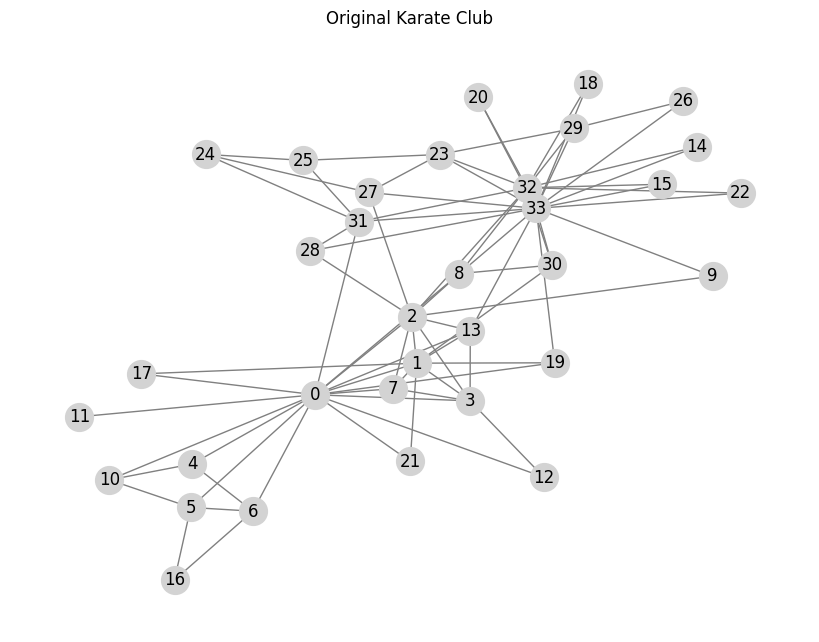



 >> 1. s_unif :

Initial Opinions:	 ['-0.64', '-0.13', '0.73', '0.15', '-0.44', '-0.75', '-0.54', '-0.75', '-0.53', '-0.23', '-0.91', '0.68', '-0.19', '0.13', '0.27', '-0.73', '-0.83', '-0.69', '0.97', '-0.79', '-0.15', '0.75', '0.17', '-0.96', '0.78', '-0.23', '-0.66', '-0.33', '0.19', '-0.92', '0.29', '0.22', '-0.54', '-0.15']
Final Opinions:		 ['-0.32', '-0.15', '-0.01', '-0.10', '-0.45', '-0.54', '-0.49', '-0.25', '-0.24', '-0.17', '-0.54', '-0.12', '-0.16', '-0.10', '-0.16', '-0.35', '-0.58', '-0.35', '-0.00', '-0.34', '-0.26', '-0.04', '-0.17', '-0.41', '0.00', '-0.21', '-0.44', '-0.22', '-0.06', '-0.47', '-0.13', '-0.12', '-0.30', '-0.22']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (352.71) - (31.31) = -321.

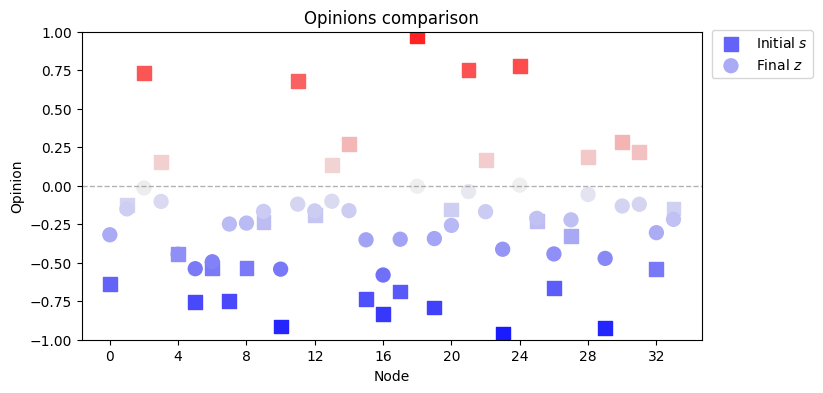

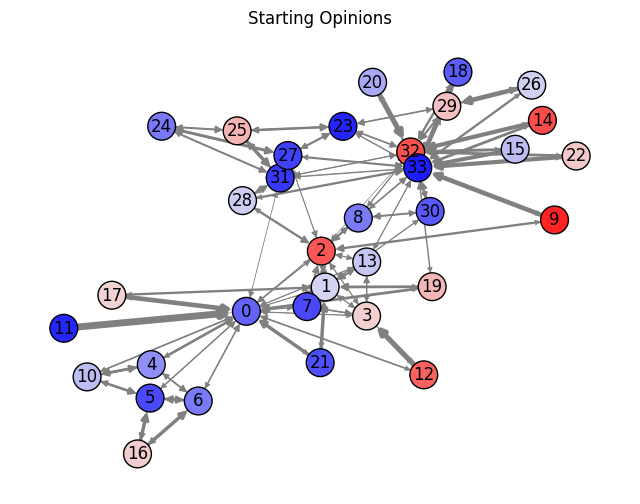

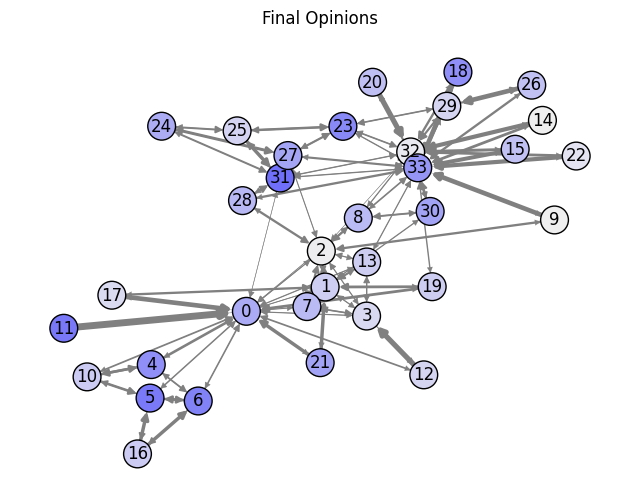



 >> 2. s_B2(1) :

Initial Opinions:	 ['-0.84', '-0.56', '-0.61', '-0.36', '-0.19', '-0.29', '-0.28', '-0.26', '-0.34', '-0.11', '-0.19', '-0.10', '-0.12', '-0.33', '-0.15', '-0.18', '-0.14', '-0.10', '-0.11', '-0.14', '-0.13', '-0.12', '-0.15', '-0.41', '-0.17', '-0.28', '-0.16', '-0.28', '-0.15', '-0.29', '-0.24', '-0.42', '-0.78', '-1.00']
Final Opinions:		 ['-0.52', '-0.49', '-0.51', '-0.45', '-0.38', '-0.37', '-0.37', '-0.45', '-0.49', '-0.47', '-0.37', '-0.44', '-0.40', '-0.47', '-0.48', '-0.49', '-0.33', '-0.43', '-0.48', '-0.45', '-0.47', '-0.43', '-0.49', '-0.48', '-0.40', '-0.43', '-0.44', '-0.45', '-0.45', '-0.46', '-0.48', '-0.48', '-0.55', '-0.59']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (56.66) - (3

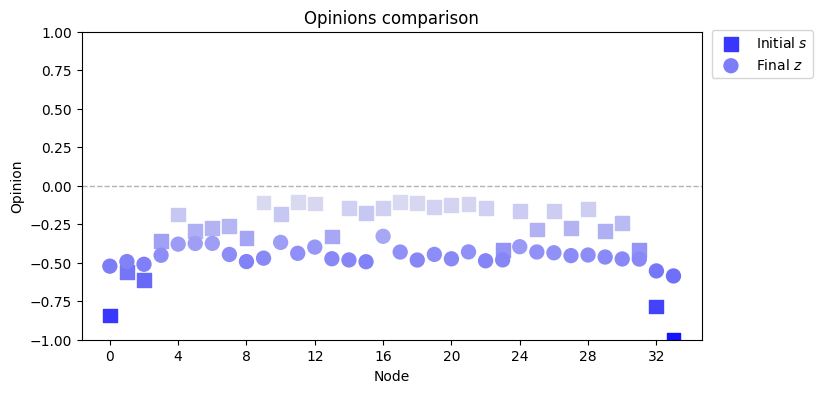

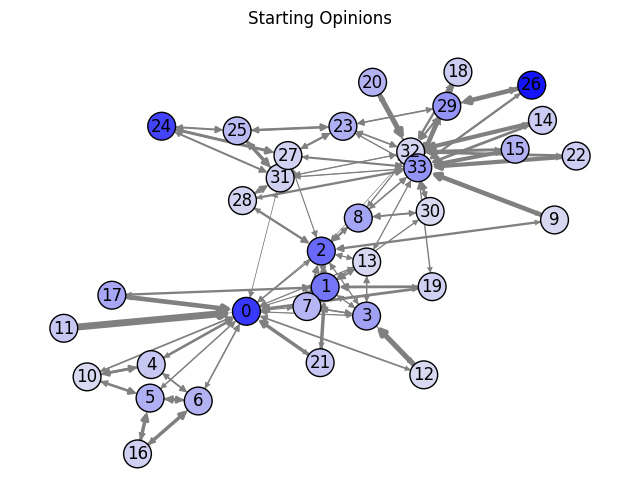

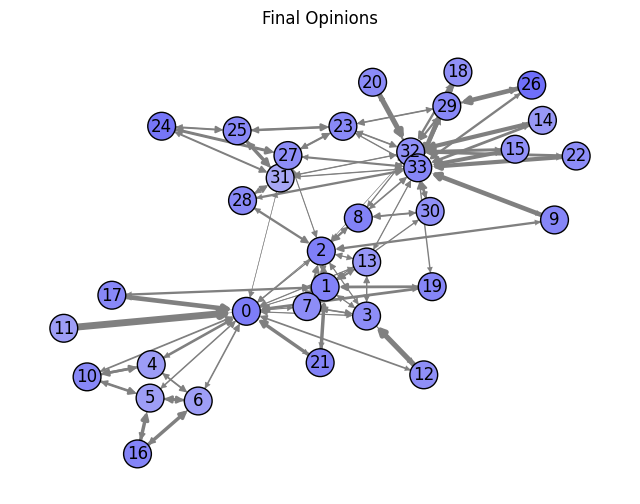



 >> 3. s_B2(t) :

Initial Opinions:	 ['-0.84', '-0.56', '-0.61', '-0.36', '-0.19', '-0.29', '-0.28', '-0.26', '-0.34', '-0.11', '-0.19', '-0.10', '-0.12', '-0.33', '-0.15', '-0.18', '-0.14', '-0.10', '-0.11', '-0.14', '-0.13', '-0.12', '-0.15', '-0.41', '-0.17', '-0.28', '-0.16', '-0.28', '-0.15', '-0.29', '-0.24', '-0.42', '-0.78', '-1.00']
Final Opinions:		 ['-0.52', '-0.49', '-0.51', '-0.45', '-0.38', '-0.37', '-0.37', '-0.45', '-0.49', '-0.47', '-0.37', '-0.44', '-0.40', '-0.47', '-0.48', '-0.49', '-0.33', '-0.43', '-0.48', '-0.45', '-0.47', '-0.43', '-0.49', '-0.48', '-0.40', '-0.43', '-0.44', '-0.45', '-0.45', '-0.46', '-0.48', '-0.48', '-0.55', '-0.59']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (56.66) - (3

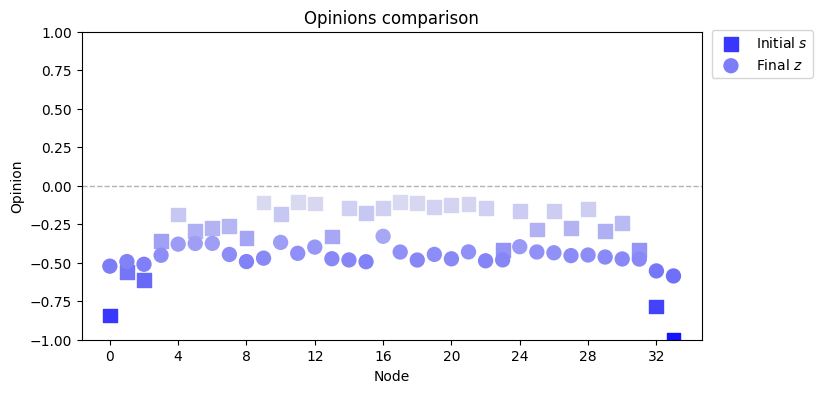

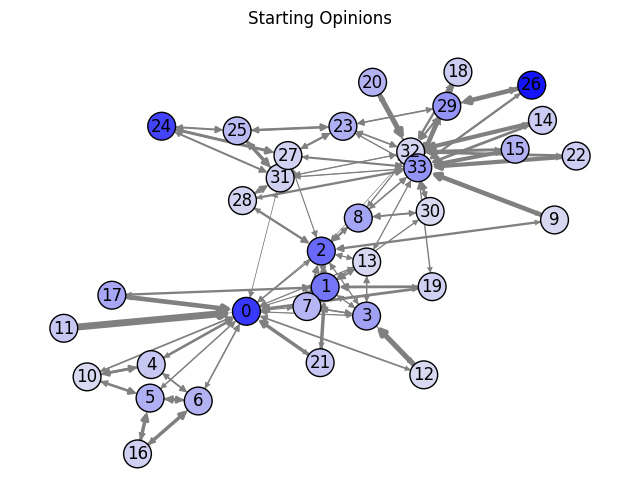

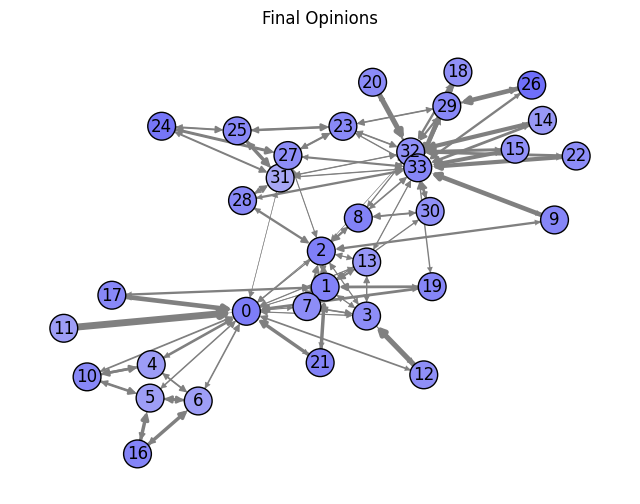



 >> 4. s_max^P2P3 :

Initial Opinions:	 ['1.00', '1.00', '1.00', '1.00', '0.57', '0.93', '0.87', '0.73', '0.91', '0.28', '0.57', '0.29', '0.34', '0.92', '0.37', '0.46', '0.47', '0.28', '0.28', '0.37', '0.32', '0.33', '0.37', '1.00', '0.47', '0.80', '0.43', '0.75', '0.41', '0.78', '0.64', '1.00', '1.00', '1.00']
Final Opinions:		 ['0.86', '0.88', '0.89', '0.89', '0.77', '0.83', '0.82', '0.85', '0.87', '0.75', '0.77', '0.75', '0.77', '0.88', '0.76', '0.78', '0.76', '0.75', '0.74', '0.77', '0.75', '0.76', '0.76', '0.87', '0.77', '0.85', '0.75', '0.83', '0.78', '0.82', '0.82', '0.87', '0.86', '0.85']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (88.66) - (3.01) = -85.65
NDI:	ΔΦ = (7.27) - (0.20) = -7.08
P1:	ΔΦ = (2.61) -

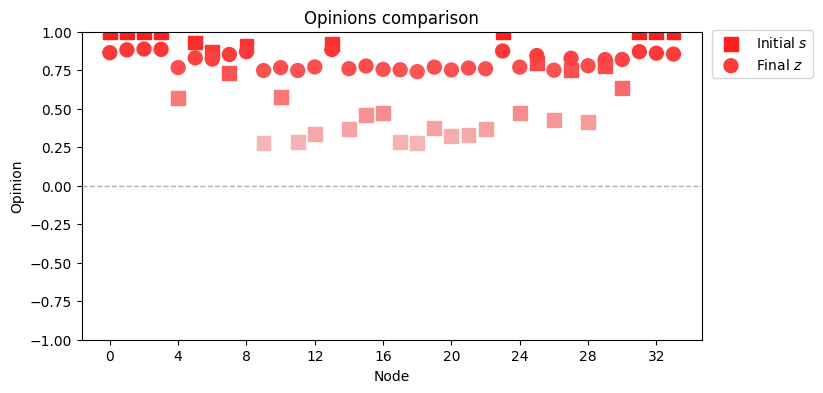

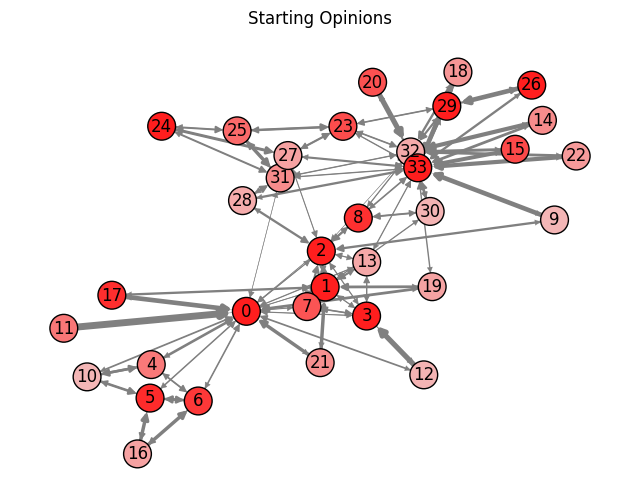

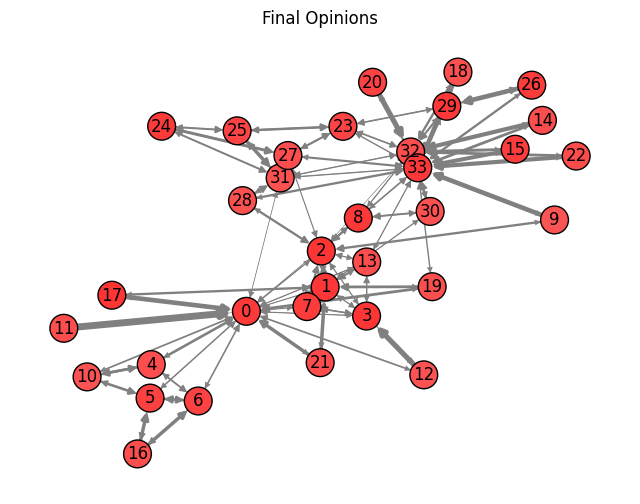



 >> 5. s_B1(1) :

Initial Opinions:	 ['0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00']
Final Opinions:		 ['0.04', '0.04', '0.06', '0.04', '0.02', '0.02', '0.02', '0.04', '0.11', '0.18', '0.02', '0.03', '0.03', '0.07', '0.16', '0.18', '0.01', '0.03', '0.20', '0.08', '0.14', '0.03', '0.19', '0.12', '0.09', '0.09', '0.15', '0.13', '0.13', '0.13', '0.13', '0.11', '0.12', '0.31']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (33.00) - (5.35) = -27.65
NDI:	ΔΦ = (6.68) - (0.20) = -6.48
P1:	ΔΦ = (0.97) - (0

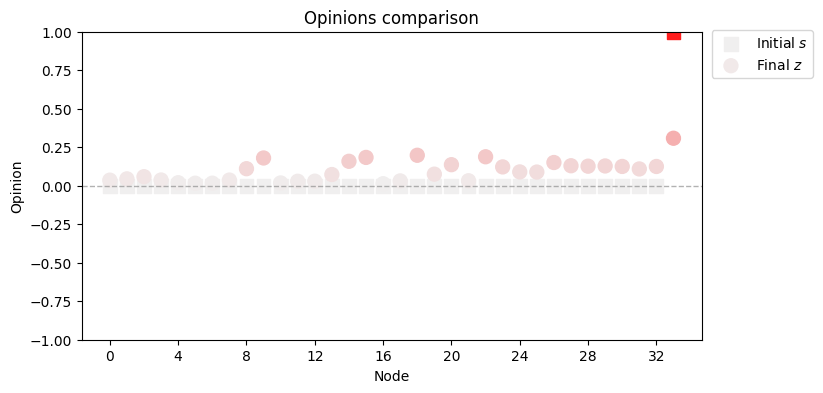

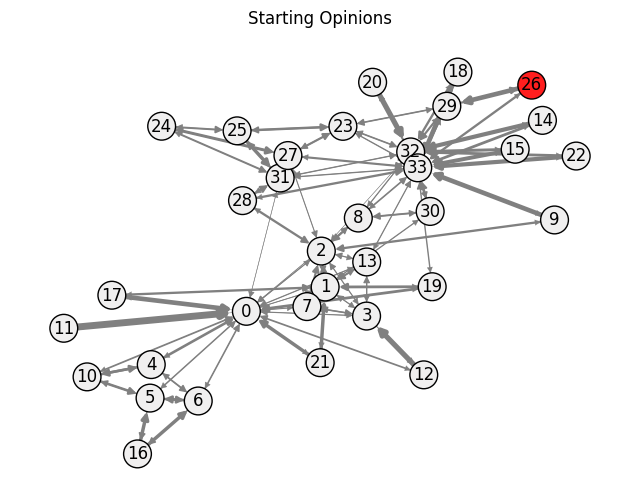

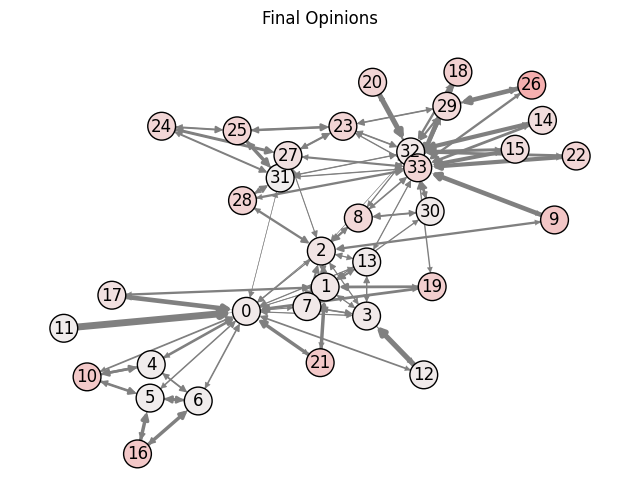



 >> 6. s_max^P4 :

Initial Opinions:	 ['1.00', '1.00', '1.00', '1.00', '0.00', '1.00', '1.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '1.00', '1.00']
Final Opinions:		 ['0.75', '0.77', '0.77', '0.78', '0.53', '0.73', '0.74', '0.61', '0.76', '0.58', '0.53', '0.60', '0.62', '0.80', '0.56', '0.56', '0.59', '0.61', '0.56', '0.60', '0.56', '0.61', '0.56', '0.67', '0.45', '0.52', '0.45', '0.52', '0.57', '0.49', '0.58', '0.69', '0.70', '0.70']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (264.00) - (11.01) = -252.99
NDI:	ΔΦ = (23.75) - (0.64) = -23.11
P1:	ΔΦ = (7.76

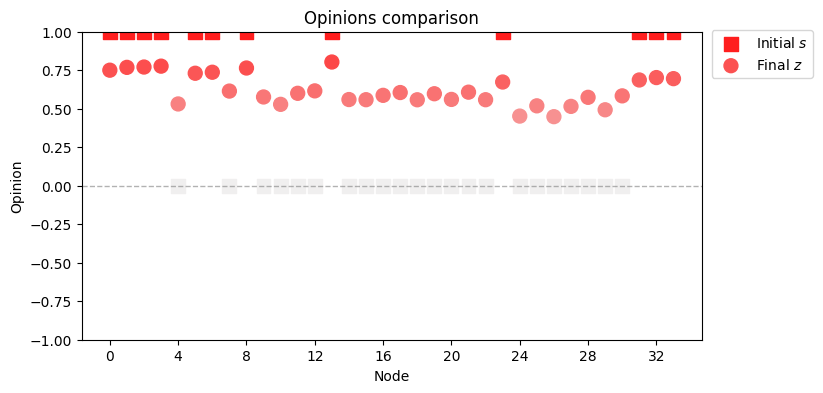

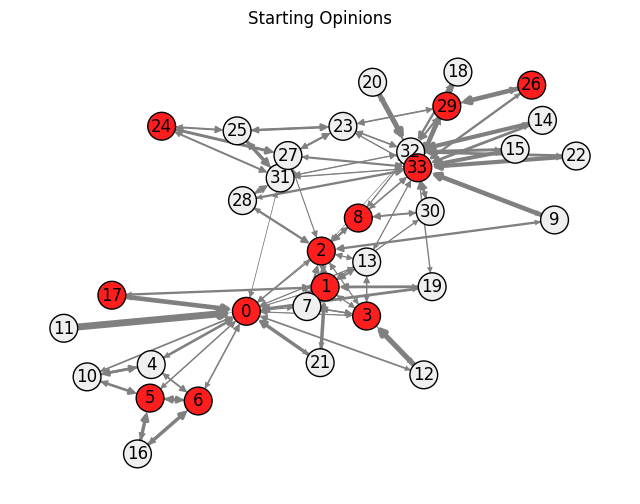

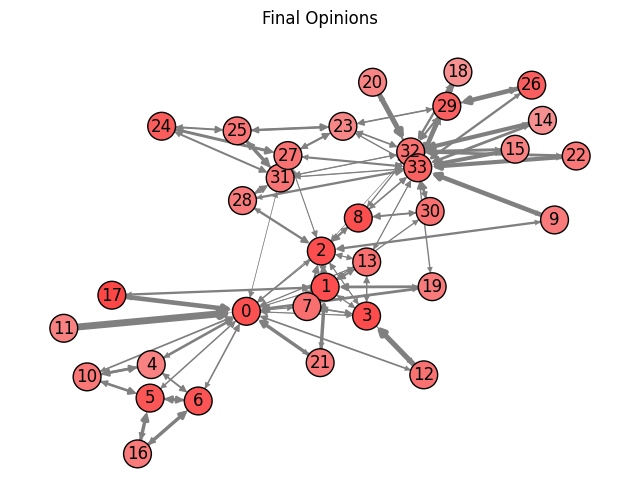

         s     GDI    NDI    P1    P2    P3    P4
    s_unif -321.39 -14.71 -9.45 -0.26 -8.69 -8.96
   s_B2(1)  -53.42  -8.88 -1.57  0.07  2.52  5.46
   s_B2(t)  -53.42  -8.88 -1.57  0.07  2.52  5.46
s_max^P2P3  -85.65  -7.08 -2.52  0.16  5.56  5.56
   s_B1(1)  -27.65  -6.48 -0.81 -0.02 -0.54  2.23
  s_max^P4 -252.99 -23.11 -7.44  0.04  1.42  9.10


In [9]:
def visualize_network_karate(W, opinions, layout="spring", set_pos=None, title="Opinions", options=None): # cba to parametrize the original
    n = len(opinions)

    # connect graph
    G = nx.DiGraph()
    for i in range(n):
        for j in range(n):
            if W[i, j] > 0:
                G.add_edge(i, j, weight=W[i, j])

    # assign node colors
    norm_opinions = (opinions + 1) / 2
    cmap = cm_bgr # plt.cm.bgr #plt.cm.coolwarm
    node_colors = cmap(norm_opinions)

    # choose layout
    if set_pos is not None:
        pos = set_pos
    elif layout == "spring":
        pos = nx.spring_layout(G)
    elif layout == "circular":
        pos = nx.circular_layout(G)
    else:
        pos = nx.spring_layout(G)

    # scale edges according yo weights
    edge_widths = []
    for u, v in G.edges():
        w = G[u][v]['weight']
        edge_widths.append(w * BASE_WIDTH)

    # plot network
    fig, ax = plt.subplots(figsize=(8, 6))
    nx.draw(G, pos, ax=ax,
            with_labels=True,
            node_color=node_colors,
            node_size=400,
            # width=1.5,
            width=edge_widths,
            font_color='black',
            edge_color='gray',
            edgecolors='black')

    ax.set_title(title)
    ax.set_axis_off()
    plt.show()

    return pos

def karate_template(s, Lambda, W):
    # find convergence
    z = solve_gFJ(s, Lambda, W)

    # metrics
    metrics_s = calculate_polarization_metrics(s, W)
    metrics_z = calculate_polarization_metrics(z, W)

    # prints
    print("Initial Opinions:\t", [f"{val:.2f}" for val in s])
    print("Final Opinions:\t\t", [f"{val:.2f}" for val in z])
    print("Susceptibilities:\t", [f"{val:.2f}" for val in lambda_vals])

    print("\nPolarization:")
    diff = {}
    for k in metrics_s:
        delta = metrics_z[k] - metrics_s[k]
        diff[k] = round(delta, 2)
        print(f"{k}:\tΔΦ = ({metrics_s[k]:.2f}) - ({metrics_z[k]:.2f}) = {delta:.2f}")

    # another type
    plot_opinions(s, z)

    _ = visualize_network_karate(W, s, set_pos=pos, title="Starting Opinions")
    _ = visualize_network_karate(W, z, set_pos=pos, title="Final Opinions")

    return diff

# get graph
G = nx.karate_club_graph()
n = G.number_of_nodes()

#original graph
pos = nx.spring_layout(G)
plt.figure(figsize=(8, 6))
nx.draw(G, pos, with_labels=True, node_color='lightgray', edge_color='gray', node_size=400)
plt.title("Original Karate Club")
plt.show()

# define W
A = nx.to_numpy_array(G)
W = A / A.sum(axis=1, keepdims=True)

# print("Weights:")
# print_W(W)

# Lambda const 0.8
lambda_vals = np.full(n, 0.8)
Lambda = np.diag(lambda_vals)

# s_unif
s_unif = np.random.uniform(-1, 1, n)
# sB2(1)
s_b2_1 = find_polarizing_s_for_P2_P3(Lambda, W)
# sB2(t)
s_b2_t = s_b2_1 / np.max(np.abs(s_b2_1))
# s_max^P2P3(1)
s_max_P2P3 = get_s_max_P2P3(Lambda, W)
# sB1(1)
s_b1_1 = find_polarizing_s_for_P4(Lambda, W)
# s_max^P4(1)
s_max_P4 = get_s_max_P4(Lambda, W)

s_all = {"s_unif": s_unif, "s_B2(1)": s_b2_1, "s_B2(t)": s_b2_t, "s_max^P2P3": s_max_P2P3, "s_B1(1)": s_b1_1, "s_max^P4": s_max_P4}

i = 1
rows = []
for name, s in s_all.items():
    print(f"\n\n >> {i}. {name} :\n")
    metrics = karate_template(s, Lambda, W)

    # table
    row = {"s": name}
    row.update(metrics)
    rows.append(row)
    i += 1

df = pd.DataFrame(rows)
print(df.to_string(index=False))


proportional to centrality, check biggest nodes (0: Mr. Hi, 33: Officer) to verify

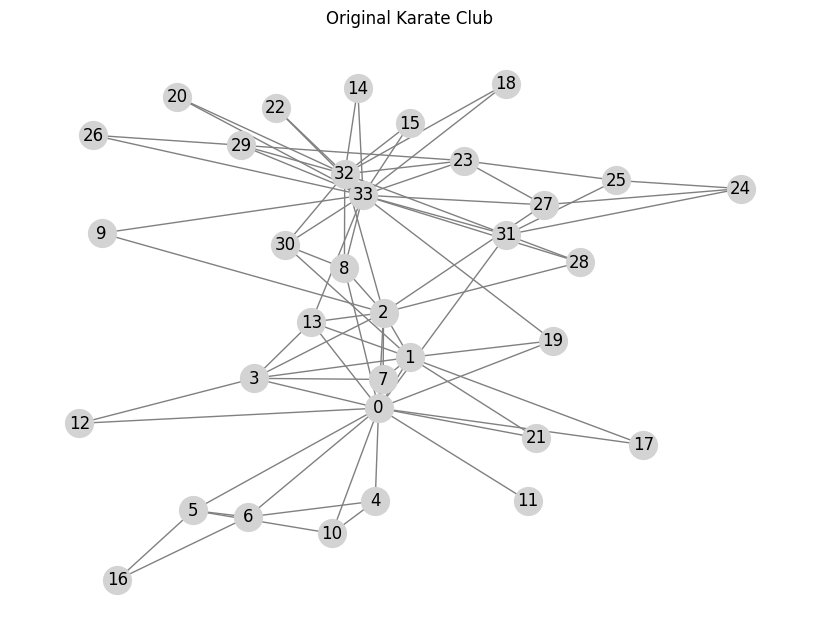



 >> 1. s_unif :

Initial Opinions:	 ['0.88', '-0.32', '-0.35', '-0.98', '-0.86', '0.92', '-0.05', '-0.76', '-0.78', '0.04', '0.30', '0.67', '0.14', '-0.33', '0.40', '-0.62', '-0.33', '-0.76', '0.36', '0.08', '-0.12', '-0.54', '0.69', '-0.21', '0.82', '-0.46', '0.27', '0.47', '-0.66', '-0.64', '0.53', '-0.82', '-0.04', '-0.83']
Final Opinions:		 ['0.42', '-0.31', '-0.34', '-0.84', '-0.76', '0.79', '-0.01', '-0.70', '-0.68', '0.01', '0.29', '0.66', '0.11', '-0.33', '0.36', '-0.60', '-0.28', '-0.72', '0.33', '0.07', '-0.13', '-0.51', '0.62', '-0.21', '0.75', '-0.44', '0.22', '0.40', '-0.65', '-0.57', '0.43', '-0.70', '-0.12', '-0.52']
Susceptibilities:	 ['0.41', '0.27', '0.29', '0.17', '0.10', '0.16', '0.15', '0.12', '0.15', '0.04', '0.10', '0.05', '0.05', '0.16', '0.06', '0.08', '0.08', '0.04', '0.04', '0.06', '0.05', '0.05', '0.06', '0.19', '0.08', '0.13', '0.07', '0.13', '0.07', '0.13', '0.11', '0.19', '0.35', '0.45']

Polarization:
GDI:	ΔΦ = (368.99) - (272.01) = -96.98
NDI:	ΔΦ = (2

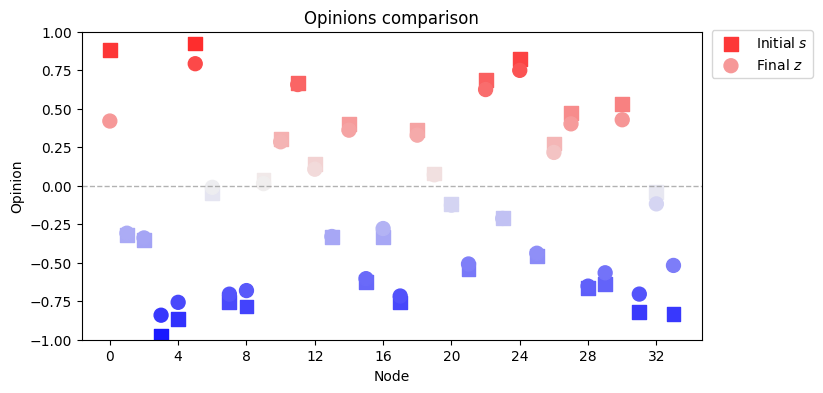

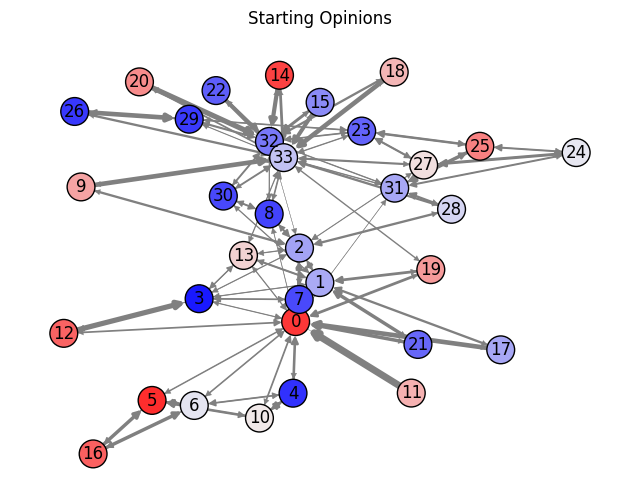

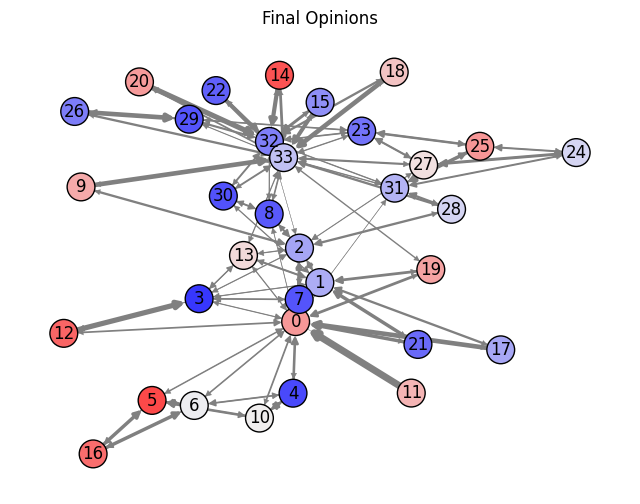



 >> 2. s_B2(1) :

Initial Opinions:	 ['-0.76', '-0.91', '-0.91', '-0.94', '-0.87', '-0.86', '-0.86', '-0.98', '-1.00', '-0.82', '-0.86', '-0.79', '-0.84', '-0.99', '-0.90', '-0.95', '-0.83', '-0.80', '-0.82', '-0.89', '-0.87', '-0.85', '-0.91', '-0.97', '-0.92', '-0.97', '-0.90', '-0.97', '-0.93', '-0.95', '-0.99', '-0.96', '-0.85', '-0.76']
Final Opinions:		 ['-0.82', '-0.91', '-0.91', '-0.94', '-0.86', '-0.86', '-0.86', '-0.97', '-0.98', '-0.82', '-0.86', '-0.79', '-0.85', '-0.97', '-0.90', '-0.95', '-0.83', '-0.80', '-0.82', '-0.89', '-0.87', '-0.85', '-0.90', '-0.96', '-0.93', '-0.97', '-0.90', '-0.97', '-0.93', '-0.95', '-0.98', '-0.95', '-0.87', '-0.83']
Susceptibilities:	 ['0.41', '0.27', '0.29', '0.17', '0.10', '0.16', '0.15', '0.12', '0.15', '0.04', '0.10', '0.05', '0.05', '0.16', '0.06', '0.08', '0.08', '0.04', '0.04', '0.06', '0.05', '0.05', '0.06', '0.19', '0.08', '0.13', '0.07', '0.13', '0.07', '0.13', '0.11', '0.19', '0.35', '0.45']

Polarization:
GDI:	ΔΦ = (5.36) - (3.

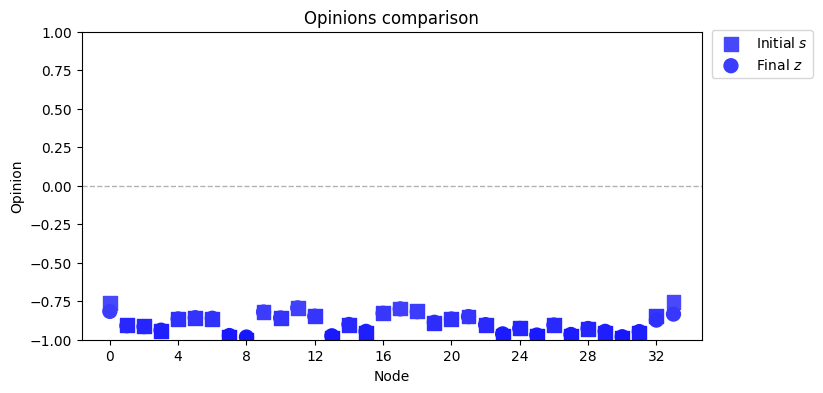

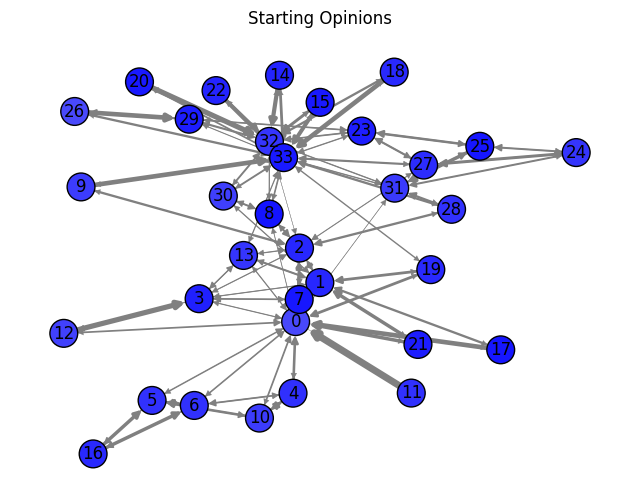

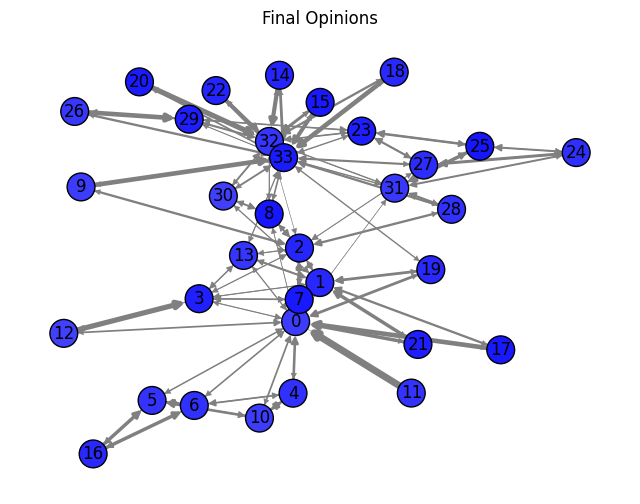



 >> 3. s_B2(t) :

Initial Opinions:	 ['-0.76', '-0.91', '-0.91', '-0.94', '-0.87', '-0.86', '-0.86', '-0.98', '-1.00', '-0.82', '-0.86', '-0.79', '-0.84', '-0.99', '-0.90', '-0.95', '-0.83', '-0.80', '-0.82', '-0.89', '-0.87', '-0.85', '-0.91', '-0.97', '-0.92', '-0.97', '-0.90', '-0.97', '-0.93', '-0.95', '-0.99', '-0.96', '-0.85', '-0.76']
Final Opinions:		 ['-0.82', '-0.91', '-0.91', '-0.94', '-0.86', '-0.86', '-0.86', '-0.97', '-0.98', '-0.82', '-0.86', '-0.79', '-0.85', '-0.97', '-0.90', '-0.95', '-0.83', '-0.80', '-0.82', '-0.89', '-0.87', '-0.85', '-0.90', '-0.96', '-0.93', '-0.97', '-0.90', '-0.97', '-0.93', '-0.95', '-0.98', '-0.95', '-0.87', '-0.83']
Susceptibilities:	 ['0.41', '0.27', '0.29', '0.17', '0.10', '0.16', '0.15', '0.12', '0.15', '0.04', '0.10', '0.05', '0.05', '0.16', '0.06', '0.08', '0.08', '0.04', '0.04', '0.06', '0.05', '0.05', '0.06', '0.19', '0.08', '0.13', '0.07', '0.13', '0.07', '0.13', '0.11', '0.19', '0.35', '0.45']

Polarization:
GDI:	ΔΦ = (5.36) - (3.

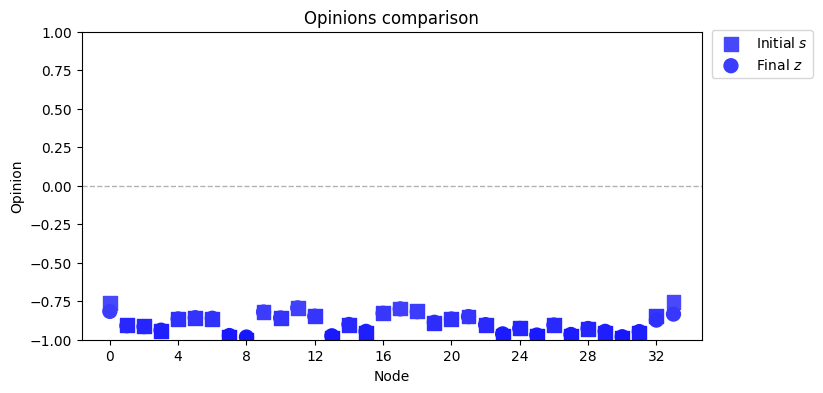

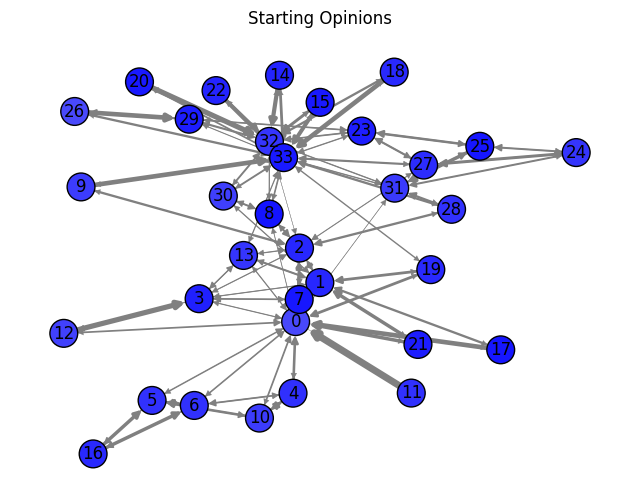

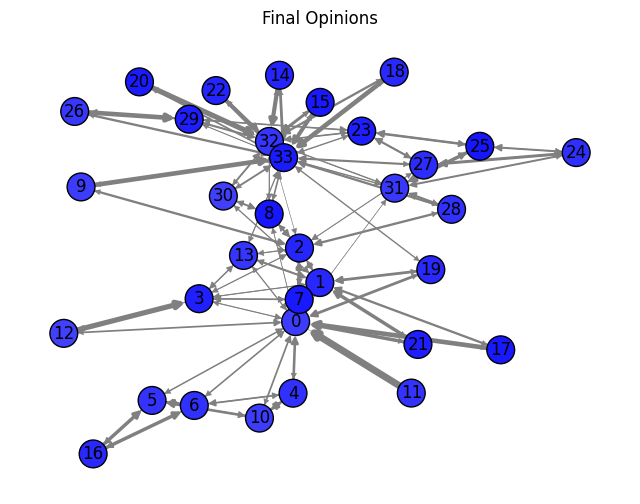



 >> 4. s_max^P2P3 :

Initial Opinions:	 ['0.80', '0.94', '0.95', '0.99', '0.94', '0.93', '0.94', '1.00', '1.00', '0.87', '0.93', '0.85', '0.90', '1.00', '0.95', '1.00', '0.91', '0.85', '0.86', '0.94', '0.92', '0.90', '0.95', '1.00', '0.97', '1.00', '0.96', '1.00', '0.98', '1.00', '1.00', '1.00', '0.88', '0.79']
Final Opinions:		 ['0.86', '0.94', '0.95', '0.98', '0.94', '0.93', '0.93', '0.99', '0.99', '0.87', '0.93', '0.85', '0.90', '0.99', '0.95', '0.99', '0.91', '0.85', '0.87', '0.94', '0.91', '0.90', '0.95', '0.99', '0.97', '1.00', '0.96', '0.99', '0.97', '0.99', '0.99', '0.99', '0.91', '0.87']
Susceptibilities:	 ['0.41', '0.27', '0.29', '0.17', '0.10', '0.16', '0.15', '0.12', '0.15', '0.04', '0.10', '0.05', '0.05', '0.16', '0.06', '0.08', '0.08', '0.04', '0.04', '0.06', '0.05', '0.05', '0.06', '0.19', '0.08', '0.13', '0.07', '0.13', '0.07', '0.13', '0.11', '0.19', '0.35', '0.45']

Polarization:
GDI:	ΔΦ = (4.00) - (2.51) = -1.49
NDI:	ΔΦ = (0.35) - (0.13) = -0.22
P1:	ΔΦ = (0.12) - (

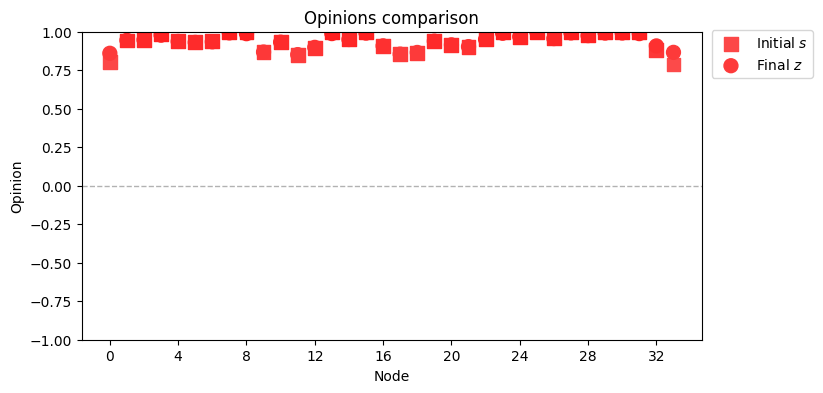

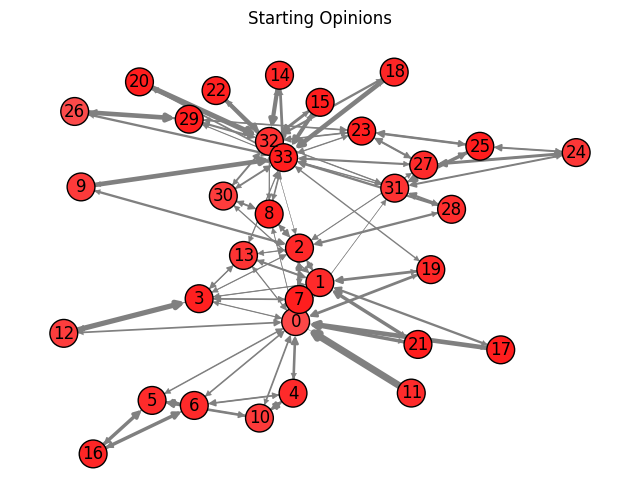

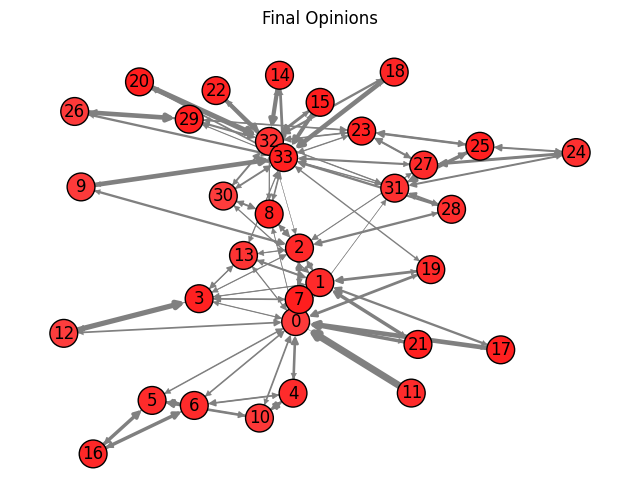



 >> 5. s_B1(1) :

Initial Opinions:	 ['0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00']
Final Opinions:		 ['0.02', '0.00', '0.04', '0.00', '0.00', '0.00', '0.00', '0.00', '0.85', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.03', '0.00', '0.03', '0.03']
Susceptibilities:	 ['0.41', '0.27', '0.29', '0.17', '0.10', '0.16', '0.15', '0.12', '0.15', '0.04', '0.10', '0.05', '0.05', '0.16', '0.06', '0.08', '0.08', '0.04', '0.04', '0.06', '0.05', '0.05', '0.06', '0.19', '0.08', '0.13', '0.07', '0.13', '0.07', '0.13', '0.11', '0.19', '0.35', '0.45']

Polarization:
GDI:	ΔΦ = (33.00) - (23.65) = -9.35
NDI:	ΔΦ = (1.63) - (1.11) = -0.52
P1:	ΔΦ = (0.97) - (0

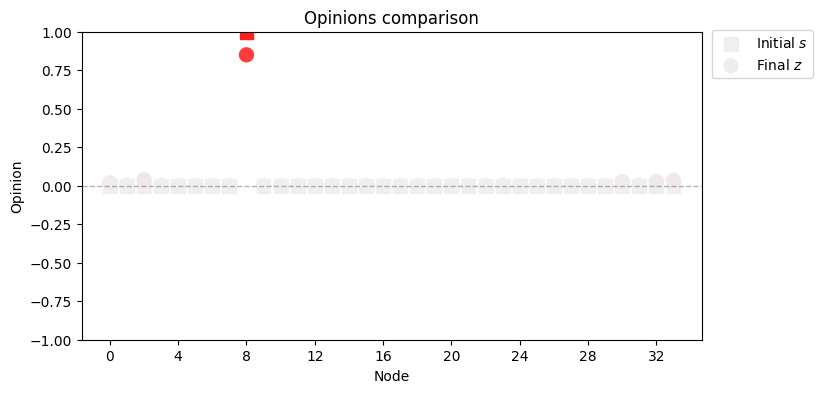

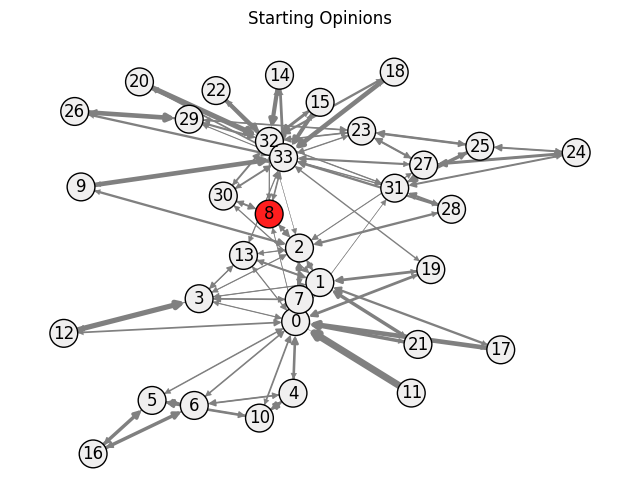

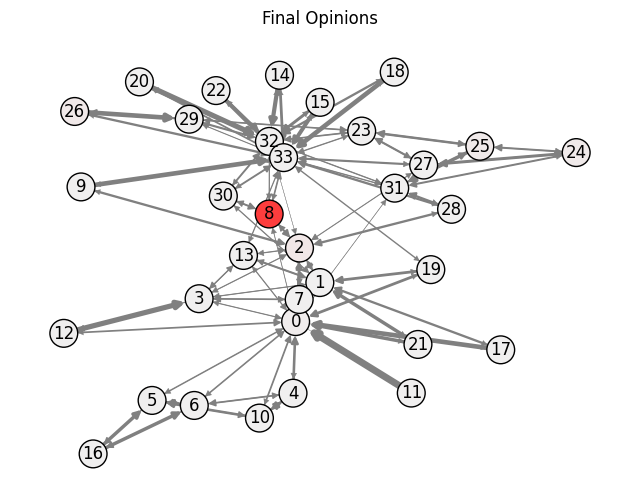



 >> 6. s_max^P4 :

Initial Opinions:	 ['0.00', '0.12', '0.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.00', '1.00', '0.00', '0.00', '1.00', '1.00', '1.00', '0.00', '0.00', '0.00', '1.00', '1.00', '0.00', '1.00', '1.00', '0.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '1.00', '0.00', '0.00']
Final Opinions:		 ['0.25', '0.24', '0.18', '0.90', '0.97', '0.94', '0.94', '0.92', '0.90', '0.01', '0.98', '0.01', '0.04', '0.90', '0.96', '0.95', '0.07', '0.01', '0.01', '0.96', '0.96', '0.01', '0.96', '0.94', '0.07', '0.97', '0.98', '0.93', '0.97', '0.96', '0.94', '0.92', '0.28', '0.36']
Susceptibilities:	 ['0.41', '0.27', '0.29', '0.17', '0.10', '0.16', '0.15', '0.12', '0.15', '0.04', '0.10', '0.05', '0.05', '0.16', '0.06', '0.08', '0.08', '0.04', '0.04', '0.06', '0.05', '0.05', '0.06', '0.19', '0.08', '0.13', '0.07', '0.13', '0.07', '0.13', '0.11', '0.19', '0.35', '0.45']

Polarization:
GDI:	ΔΦ = (268.57) - (192.76) = -75.81
NDI:	ΔΦ = (19.30) - (10.20) = -9.10
P1:	ΔΦ = (7.90

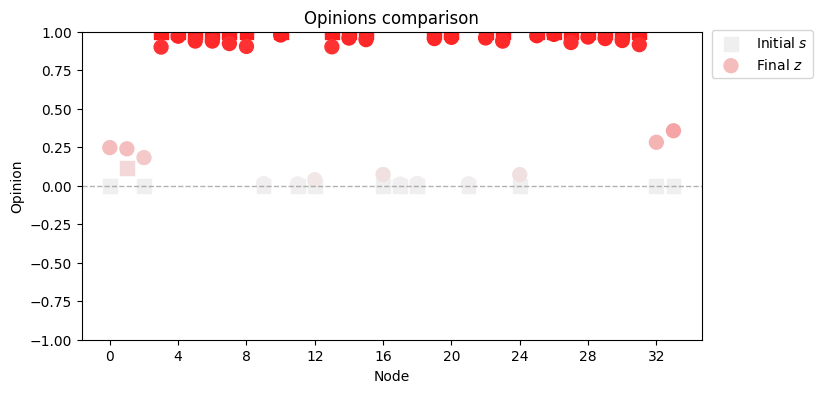

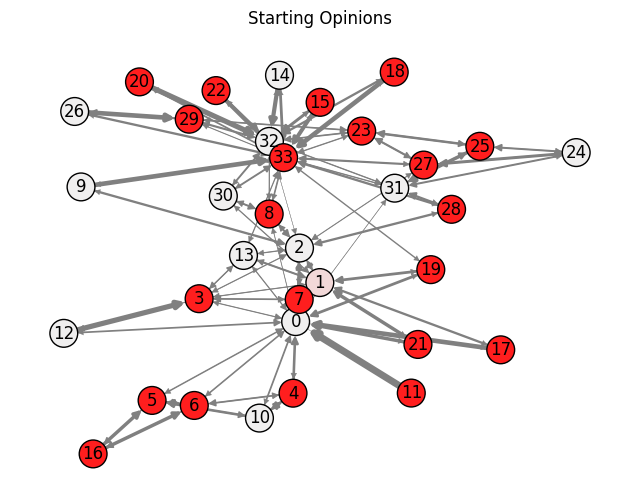

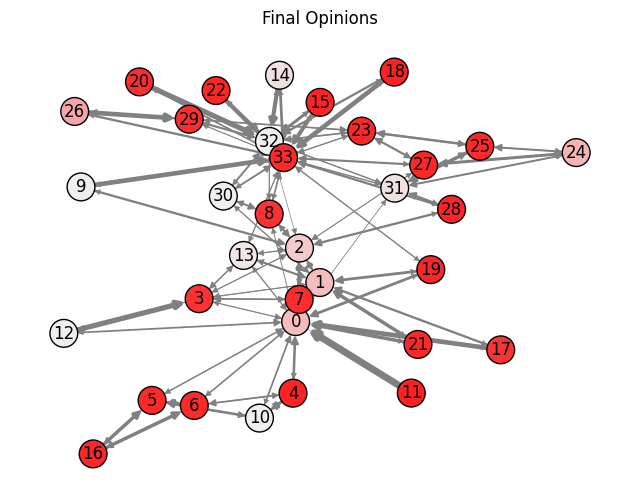

         s    GDI    NDI    P1    P2    P3    P4
    s_unif -96.98 -10.77 -2.85 -0.08 -2.84 -2.19
   s_B2(1)  -1.58  -0.21 -0.05  0.00  0.05  0.05
   s_B2(t)  -1.58  -0.21 -0.05  0.00  0.05  0.05
s_max^P2P3  -1.49  -0.22 -0.04  0.00  0.05  0.05
   s_B1(1)  -9.35  -0.52 -0.28 -0.01 -0.27  0.04
  s_max^P4 -75.81  -9.10 -2.23 -0.05 -1.87  0.29


In [10]:
def visualize_network_karate(W, opinions, layout="spring", set_pos=None, title="Opinions", options=None): # cba to parametrize the original
    n = len(opinions)

    # connect graph
    G = nx.DiGraph()
    for i in range(n):
        for j in range(n):
            if W[i, j] > 0:
                G.add_edge(i, j, weight=W[i, j])

    # assign node colors
    norm_opinions = (opinions + 1) / 2
    cmap = cm_bgr # plt.cm.bgr #plt.cm.coolwarm
    node_colors = cmap(norm_opinions)

    # choose layout
    if set_pos is not None:
        pos = set_pos
    elif layout == "spring":
        pos = nx.spring_layout(G)
    elif layout == "circular":
        pos = nx.circular_layout(G)
    else:
        pos = nx.spring_layout(G)

    # scale edges according yo weights
    edge_widths = []
    for u, v in G.edges():
        w = G[u][v]['weight']
        edge_widths.append(w * BASE_WIDTH)

    # plot network
    fig, ax = plt.subplots(figsize=(8, 6))
    nx.draw(G, pos, ax=ax,
            with_labels=True,
            node_color=node_colors,
            node_size=400,
            # width=1.5,
            width=edge_widths,
            font_color='black',
            edge_color='gray',
            edgecolors='black')

    ax.set_title(title)
    ax.set_axis_off()
    plt.show()

    return pos

def karate_template(s, Lambda, W):
    # find convergence
    z = solve_gFJ(s, Lambda, W)

    # metrics
    metrics_s = calculate_polarization_metrics(s, W)
    metrics_z = calculate_polarization_metrics(z, W)

    # prints
    print("Initial Opinions:\t", [f"{val:.2f}" for val in s])
    print("Final Opinions:\t\t", [f"{val:.2f}" for val in z])
    print("Susceptibilities:\t", [f"{val:.2f}" for val in lambda_vals])

    print("\nPolarization:")
    diff = {}
    for k in metrics_s:
        delta = metrics_z[k] - metrics_s[k]
        diff[k] = round(delta, 2)
        print(f"{k}:\tΔΦ = ({metrics_s[k]:.2f}) - ({metrics_z[k]:.2f}) = {delta:.2f}")

    # another type
    plot_opinions(s, z)

    _ = visualize_network_karate(W, s, set_pos=pos, title="Starting Opinions")
    _ = visualize_network_karate(W, z, set_pos=pos, title="Final Opinions")

    return diff

# get graph
G = nx.karate_club_graph()
n = G.number_of_nodes()

#original graph
pos = nx.spring_layout(G)
plt.figure(figsize=(8, 6))
nx.draw(G, pos, with_labels=True, node_color='lightgray', edge_color='gray', node_size=400)
plt.title("Original Karate Club")
plt.show()

# define W
A = nx.to_numpy_array(G)
W = A / A.sum(axis=1, keepdims=True)

# print("Weights:")
# print_W(W)

# centrality
C = nx.pagerank(G)
C = np.array([c for c in C.values()])

# Lambda const 0.8
lambda_vals = C
lambda_vals = lambda_vals / np.linalg.norm(lambda_vals)
Lambda = np.diag(lambda_vals)

# s_unif
s_unif = np.random.uniform(-1, 1, n)
# sB2(1)
s_b2_1 = find_polarizing_s_for_P2_P3(Lambda, W)
# sB2(t)
s_b2_t = s_b2_1 / np.max(np.abs(s_b2_1))
# s_max^P2P3(1)
s_max_P2P3 = get_s_max_P2P3(Lambda, W)
# sB1(1)
s_b1_1 = find_polarizing_s_for_P4(Lambda, W)
# s_max^P4(1)
s_max_P4 = get_s_max_P4(Lambda, W)

s_all = {"s_unif": s_unif, "s_B2(1)": s_b2_1, "s_B2(t)": s_b2_t, "s_max^P2P3": s_max_P2P3, "s_B1(1)": s_b1_1, "s_max^P4": s_max_P4}

i = 1
rows = []
for name, s in s_all.items():
    print(f"\n\n >> {i}. {name} :\n")
    metrics = karate_template(s, Lambda, W)

    # table
    row = {"s": name}
    row.update(metrics)
    rows.append(row)
    i += 1

df = pd.DataFrame(rows)
print(df.to_string(index=False))


reverse proportional to centrality, check biggest nodes (0: Mr. Hi, 33: Officer) to verify

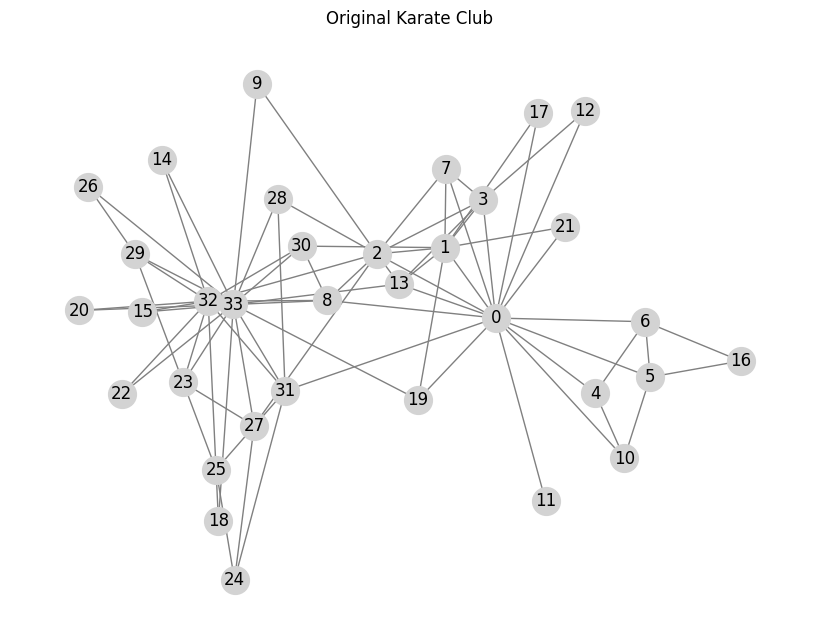



 >> 1. s_unif :

Initial Opinions:	 ['0.58', '-0.02', '0.95', '0.54', '0.27', '-0.78', '0.44', '-0.77', '-0.71', '0.72', '0.15', '0.13', '0.40', '0.69', '0.89', '-0.87', '-0.92', '-0.84', '0.96', '0.07', '-0.25', '0.22', '-0.76', '-0.22', '-0.41', '0.35', '-0.69', '0.95', '-0.92', '-0.79', '-0.67', '0.98', '-0.48', '0.37']
Final Opinions:		 ['0.57', '-0.01', '0.91', '0.52', '0.29', '-0.70', '0.38', '-0.63', '-0.63', '0.67', '0.12', '0.25', '0.43', '0.67', '0.67', '-0.72', '-0.79', '-0.48', '0.70', '0.12', '-0.25', '0.23', '-0.58', '-0.20', '-0.21', '0.35', '-0.63', '0.86', '-0.59', '-0.75', '-0.61', '0.92', '-0.47', '0.36']
Susceptibilities:	 ['0.03', '0.05', '0.05', '0.08', '0.14', '0.08', '0.09', '0.11', '0.09', '0.30', '0.14', '0.29', '0.25', '0.09', '0.22', '0.17', '0.17', '0.30', '0.30', '0.22', '0.25', '0.25', '0.22', '0.07', '0.17', '0.10', '0.19', '0.10', '0.20', '0.10', '0.12', '0.07', '0.04', '0.03']

Polarization:
GDI:	ΔΦ = (488.09) - (362.57) = -125.52
NDI:	ΔΦ = (25.47) -

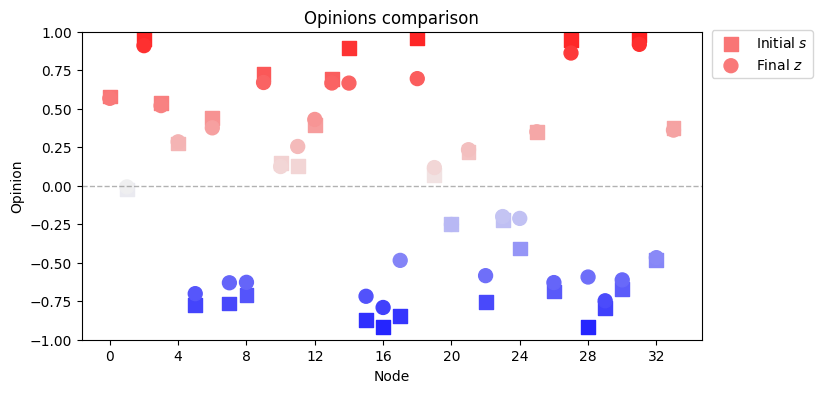

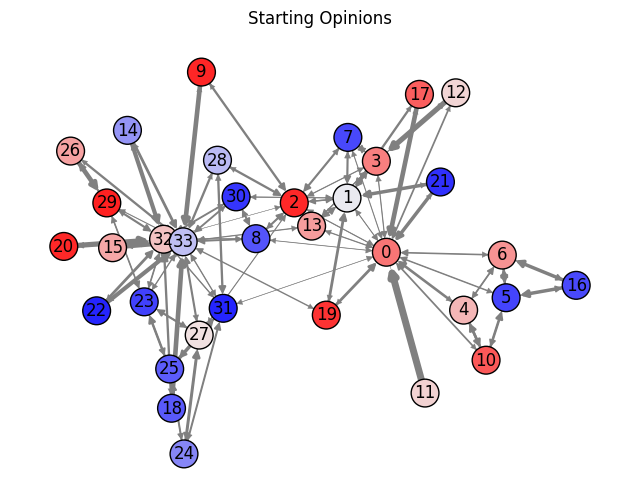

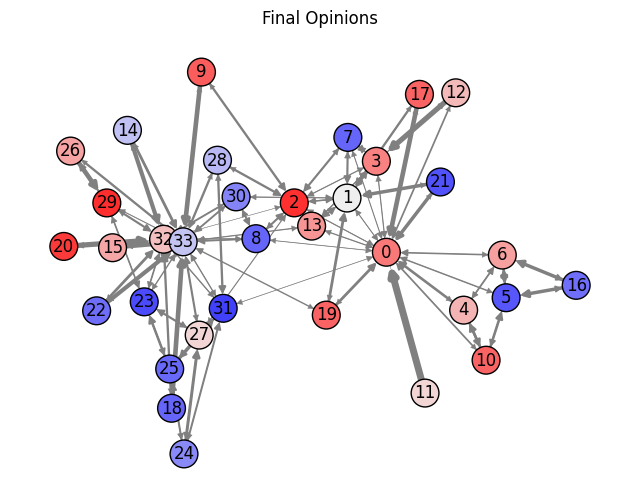



 >> 2. s_B2(1) :

Initial Opinions:	 ['-0.42', '-0.18', '-0.19', '-0.07', '-0.05', '-0.04', '-0.04', '-0.05', '-0.11', '-0.19', '-0.04', '-0.11', '-0.04', '-0.08', '-0.20', '-0.21', '-0.01', '-0.09', '-0.23', '-0.11', '-0.19', '-0.08', '-0.22', '-0.10', '-0.03', '-0.04', '-0.12', '-0.09', '-0.11', '-0.14', '-0.12', '-0.11', '-0.65', '-1.00']
Final Opinions:		 ['-0.41', '-0.18', '-0.19', '-0.08', '-0.07', '-0.04', '-0.04', '-0.06', '-0.14', '-0.35', '-0.05', '-0.20', '-0.07', '-0.10', '-0.33', '-0.32', '-0.02', '-0.16', '-0.42', '-0.18', '-0.33', '-0.13', '-0.36', '-0.12', '-0.04', '-0.05', '-0.18', '-0.12', '-0.18', '-0.17', '-0.17', '-0.13', '-0.64', '-0.98']
Susceptibilities:	 ['0.03', '0.05', '0.05', '0.08', '0.14', '0.08', '0.09', '0.11', '0.09', '0.30', '0.14', '0.29', '0.25', '0.09', '0.22', '0.17', '0.17', '0.30', '0.30', '0.22', '0.25', '0.25', '0.22', '0.07', '0.17', '0.10', '0.19', '0.10', '0.20', '0.10', '0.12', '0.07', '0.04', '0.03']

Polarization:
GDI:	ΔΦ = (41.27) - (4

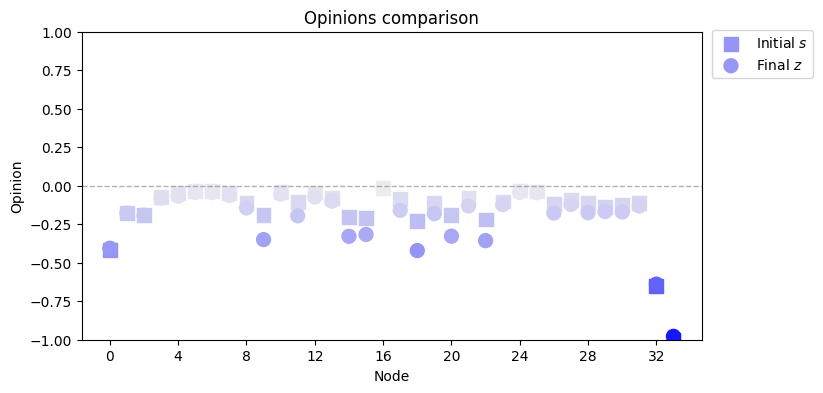

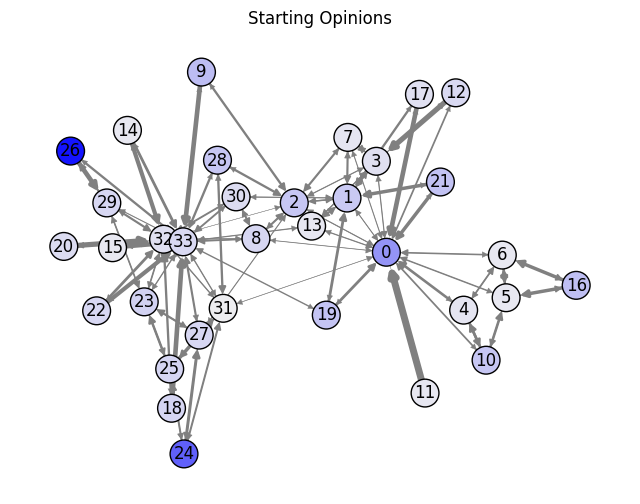

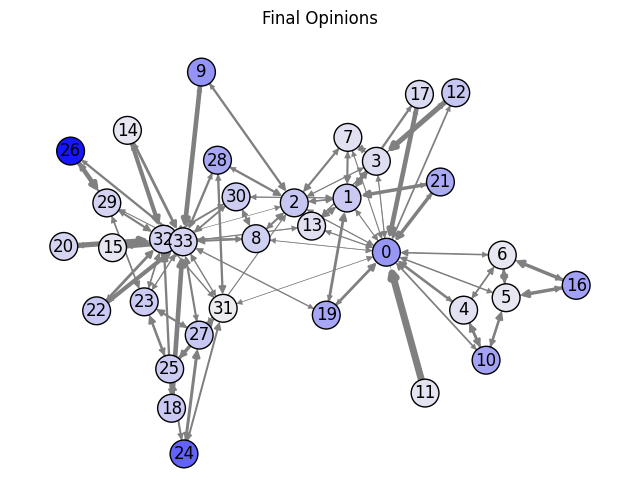



 >> 3. s_B2(t) :

Initial Opinions:	 ['-0.42', '-0.18', '-0.19', '-0.07', '-0.05', '-0.04', '-0.04', '-0.05', '-0.11', '-0.19', '-0.04', '-0.11', '-0.04', '-0.08', '-0.20', '-0.21', '-0.01', '-0.09', '-0.23', '-0.11', '-0.19', '-0.08', '-0.22', '-0.10', '-0.03', '-0.04', '-0.12', '-0.09', '-0.11', '-0.14', '-0.12', '-0.11', '-0.65', '-1.00']
Final Opinions:		 ['-0.41', '-0.18', '-0.19', '-0.08', '-0.07', '-0.04', '-0.04', '-0.06', '-0.14', '-0.35', '-0.05', '-0.20', '-0.07', '-0.10', '-0.33', '-0.32', '-0.02', '-0.16', '-0.42', '-0.18', '-0.33', '-0.13', '-0.36', '-0.12', '-0.04', '-0.05', '-0.18', '-0.12', '-0.18', '-0.17', '-0.17', '-0.13', '-0.64', '-0.98']
Susceptibilities:	 ['0.03', '0.05', '0.05', '0.08', '0.14', '0.08', '0.09', '0.11', '0.09', '0.30', '0.14', '0.29', '0.25', '0.09', '0.22', '0.17', '0.17', '0.30', '0.30', '0.22', '0.25', '0.25', '0.22', '0.07', '0.17', '0.10', '0.19', '0.10', '0.20', '0.10', '0.12', '0.07', '0.04', '0.03']

Polarization:
GDI:	ΔΦ = (41.27) - (4

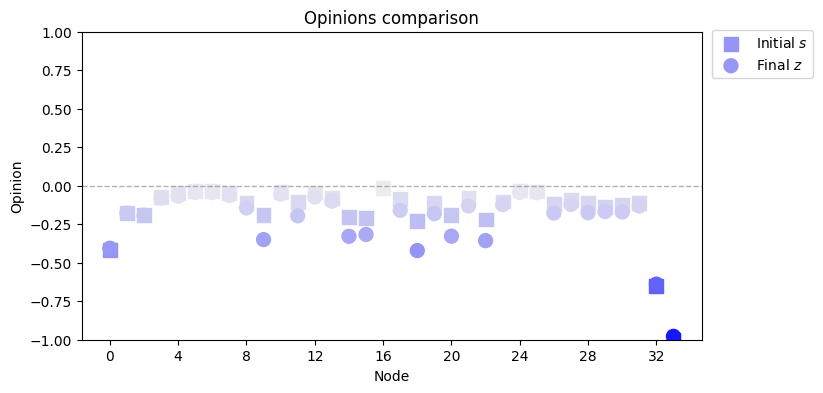

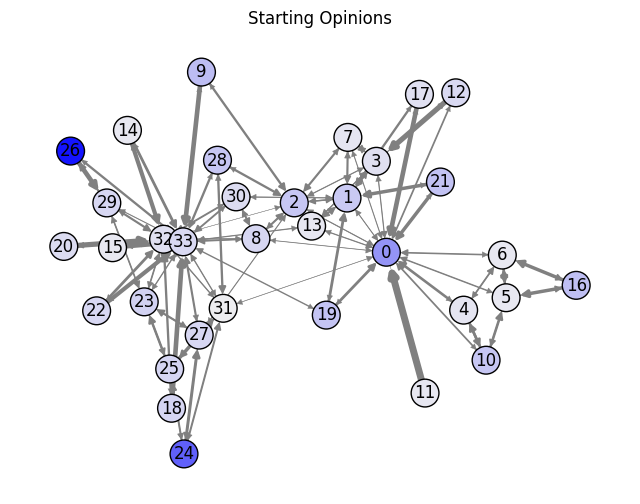

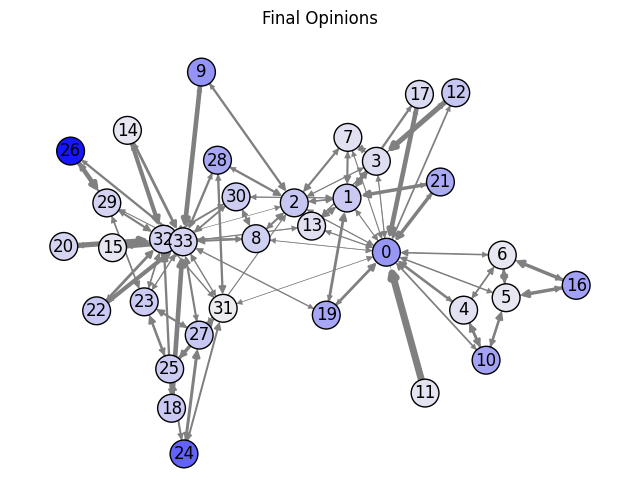



 >> 4. s_max^P2P3 :

Initial Opinions:	 ['1.00', '1.00', '1.00', '1.00', '0.57', '1.00', '1.00', '0.61', '0.65', '0.41', '0.59', '0.42', '0.45', '0.68', '0.45', '0.47', '0.56', '0.42', '0.41', '0.45', '0.43', '0.44', '0.45', '1.00', '0.47', '0.78', '0.47', '0.70', '0.47', '0.83', '0.51', '1.00', '1.00', '1.00']
Final Opinions:		 ['0.99', '0.99', '0.99', '0.99', '0.61', '0.99', '0.99', '0.65', '0.67', '0.59', '0.62', '0.59', '0.58', '0.71', '0.57', '0.56', '0.63', '0.59', '0.59', '0.57', '0.57', '0.58', '0.57', '0.99', '0.53', '0.79', '0.55', '0.72', '0.57', '0.83', '0.56', '0.99', '0.99', '0.99']
Susceptibilities:	 ['0.03', '0.05', '0.05', '0.08', '0.14', '0.08', '0.09', '0.11', '0.09', '0.30', '0.14', '0.29', '0.25', '0.09', '0.22', '0.17', '0.17', '0.30', '0.30', '0.22', '0.25', '0.25', '0.22', '0.07', '0.17', '0.10', '0.19', '0.10', '0.20', '0.10', '0.12', '0.07', '0.04', '0.03']

Polarization:
GDI:	ΔΦ = (64.99) - (38.06) = -26.93
NDI:	ΔΦ = (6.19) - (3.78) = -2.40
P1:	ΔΦ = (1.91) 

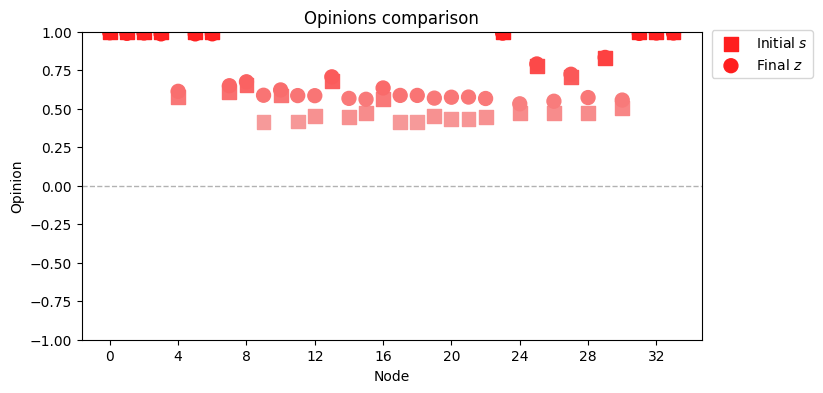

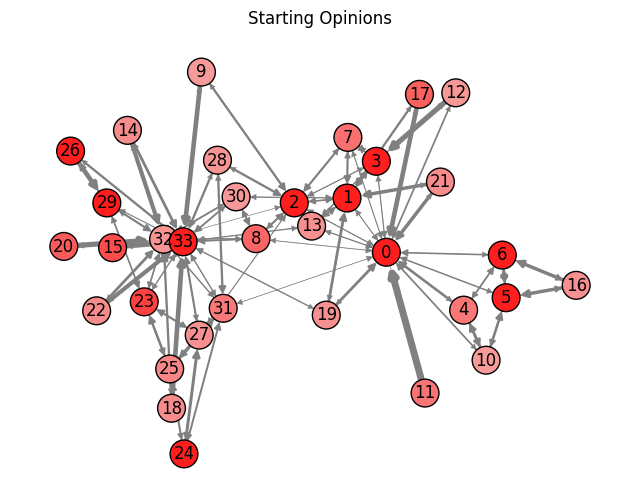

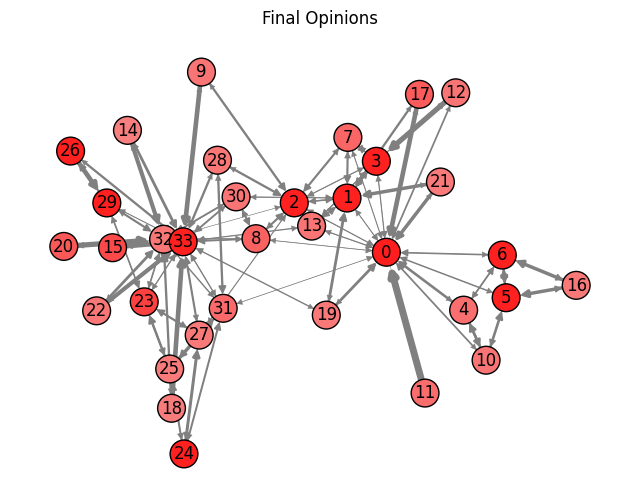



 >> 5. s_B1(1) :

Initial Opinions:	 ['0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00']
Final Opinions:		 ['0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.02', '0.20', '0.00', '0.00', '0.00', '0.01', '0.09', '0.10', '0.00', '0.00', '0.19', '0.04', '0.06', '0.00', '0.13', '0.01', '0.00', '0.00', '0.06', '0.03', '0.06', '0.02', '0.03', '0.01', '0.01', '0.97']
Susceptibilities:	 ['0.03', '0.05', '0.05', '0.08', '0.14', '0.08', '0.09', '0.11', '0.09', '0.30', '0.14', '0.29', '0.25', '0.09', '0.22', '0.17', '0.17', '0.30', '0.30', '0.22', '0.25', '0.25', '0.22', '0.07', '0.17', '0.10', '0.19', '0.10', '0.20', '0.10', '0.12', '0.07', '0.04', '0.03']

Polarization:
GDI:	ΔΦ = (33.00) - (32.19) = -0.81
NDI:	ΔΦ = (6.68) - (5.31) = -1.37
P1:	ΔΦ = (0.97) - (0

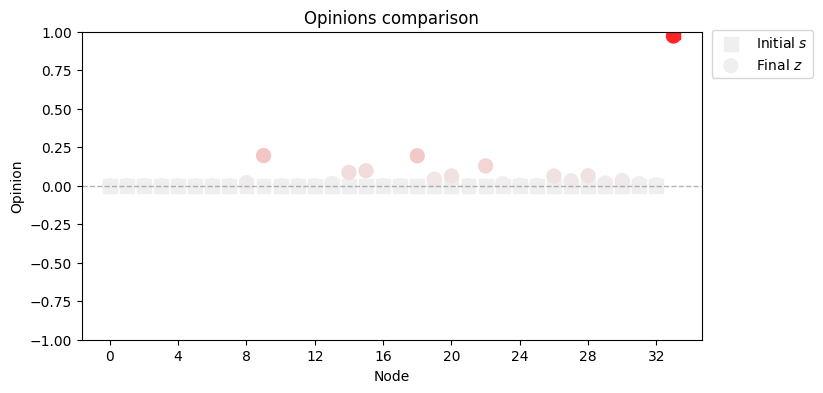

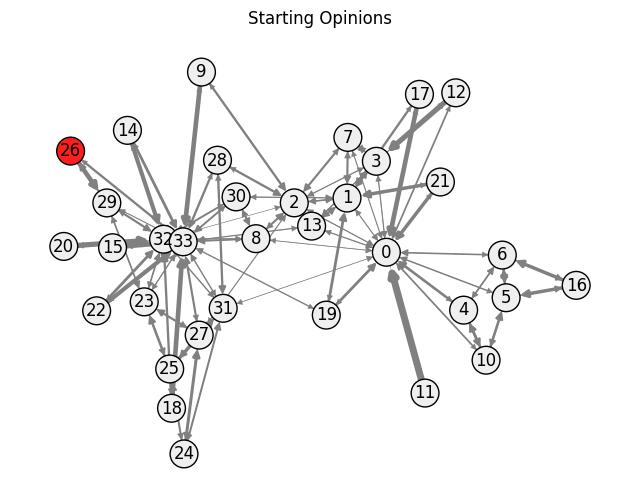

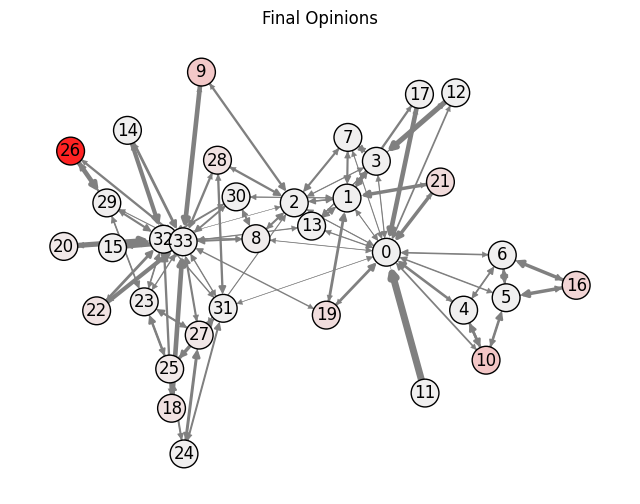



 >> 6. s_max^P4 :

Initial Opinions:	 ['1.00', '1.00', '1.00', '1.00', '0.00', '1.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '1.00', '0.00', '1.00', '1.00', '1.00']
Final Opinions:		 ['0.99', '0.98', '0.98', '0.97', '0.09', '0.97', '0.97', '0.11', '0.07', '0.30', '0.09', '0.29', '0.24', '0.08', '0.22', '0.17', '0.16', '0.29', '0.29', '0.21', '0.25', '0.25', '0.22', '0.97', '0.06', '0.08', '0.18', '0.08', '0.19', '0.97', '0.09', '0.97', '0.98', '0.98']
Susceptibilities:	 ['0.03', '0.05', '0.05', '0.08', '0.14', '0.08', '0.09', '0.11', '0.09', '0.30', '0.14', '0.29', '0.25', '0.09', '0.22', '0.17', '0.17', '0.30', '0.30', '0.22', '0.25', '0.25', '0.22', '0.07', '0.17', '0.10', '0.19', '0.10', '0.20', '0.10', '0.12', '0.07', '0.04', '0.03']

Polarization:
GDI:	ΔΦ = (253.00) - (167.18) = -85.82
NDI:	ΔΦ = (26.04) - (16.93) = -9.11
P1:	ΔΦ = (7.44

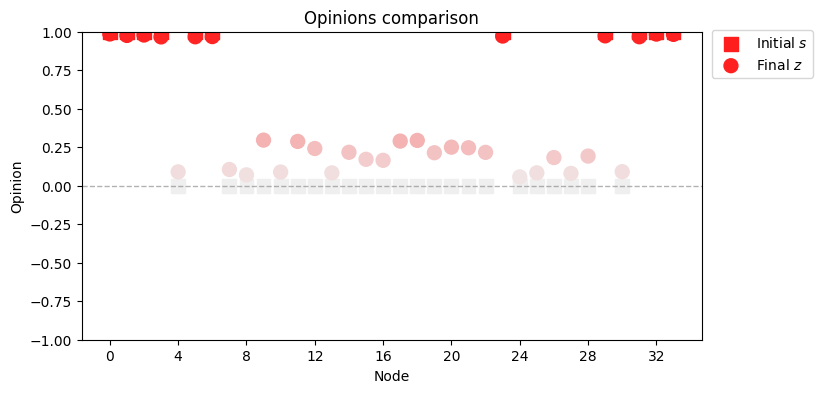

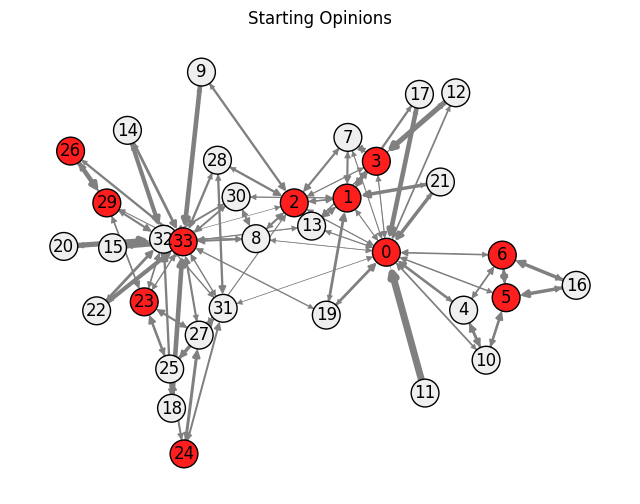

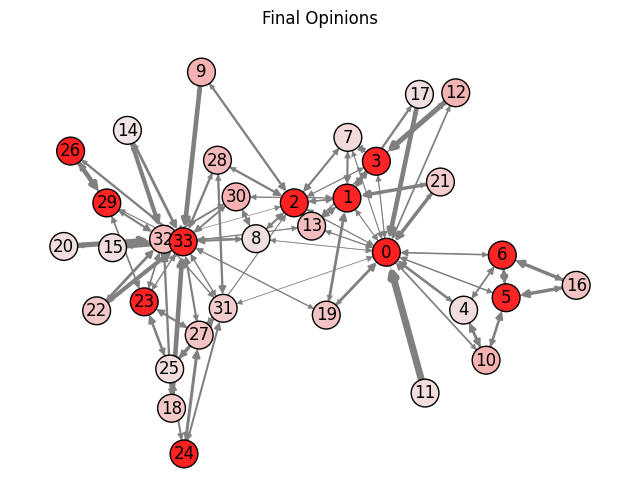

         s     GDI   NDI    P1    P2    P3    P4
    s_unif -125.52 -6.87 -3.69 -0.11 -3.68 -2.48
   s_B2(1)    0.84 -1.70  0.02  0.02  0.59  1.54
   s_B2(t)    0.84 -1.70  0.02  0.02  0.59  1.54
s_max^P2P3  -26.93 -2.40 -0.79  0.06  2.01  2.01
   s_B1(1)   -0.81 -1.37 -0.02  0.00  0.07  1.07
  s_max^P4  -85.82 -9.11 -2.52  0.01  0.31  3.74


In [11]:
def visualize_network_karate(W, opinions, layout="spring", set_pos=None, title="Opinions", options=None): # cba to parametrize the original
    n = len(opinions)

    # connect graph
    G = nx.DiGraph()
    for i in range(n):
        for j in range(n):
            if W[i, j] > 0:
                G.add_edge(i, j, weight=W[i, j])

    # assign node colors
    norm_opinions = (opinions + 1) / 2
    cmap = cm_bgr # plt.cm.bgr #plt.cm.coolwarm
    node_colors = cmap(norm_opinions)

    # choose layout
    if set_pos is not None:
        pos = set_pos
    elif layout == "spring":
        pos = nx.spring_layout(G)
    elif layout == "circular":
        pos = nx.circular_layout(G)
    else:
        pos = nx.spring_layout(G)

    # scale edges according yo weights
    edge_widths = []
    for u, v in G.edges():
        w = G[u][v]['weight']
        edge_widths.append(w * BASE_WIDTH)

    # plot network
    fig, ax = plt.subplots(figsize=(8, 6))
    nx.draw(G, pos, ax=ax,
            with_labels=True,
            node_color=node_colors,
            node_size=400,
            # width=1.5,
            width=edge_widths,
            font_color='black',
            edge_color='gray',
            edgecolors='black')

    ax.set_title(title)
    ax.set_axis_off()
    plt.show()

    return pos

def karate_template(s, Lambda, W):
    # find convergence
    z = solve_gFJ(s, Lambda, W)

    # metrics
    metrics_s = calculate_polarization_metrics(s, W)
    metrics_z = calculate_polarization_metrics(z, W)

    # prints
    print("Initial Opinions:\t", [f"{val:.2f}" for val in s])
    print("Final Opinions:\t\t", [f"{val:.2f}" for val in z])
    print("Susceptibilities:\t", [f"{val:.2f}" for val in lambda_vals])

    print("\nPolarization:")
    diff = {}
    for k in metrics_s:
        delta = metrics_z[k] - metrics_s[k]
        diff[k] = round(delta, 2)
        print(f"{k}:\tΔΦ = ({metrics_s[k]:.2f}) - ({metrics_z[k]:.2f}) = {delta:.2f}")

    # another type
    plot_opinions(s, z)

    _ = visualize_network_karate(W, s, set_pos=pos, title="Starting Opinions")
    _ = visualize_network_karate(W, z, set_pos=pos, title="Final Opinions")

    return diff

# get graph
G = nx.karate_club_graph()
n = G.number_of_nodes()

#original graph
pos = nx.spring_layout(G)
plt.figure(figsize=(8, 6))
nx.draw(G, pos, with_labels=True, node_color='lightgray', edge_color='gray', node_size=400)
plt.title("Original Karate Club")
plt.show()

# define W
A = nx.to_numpy_array(G)
W = A / A.sum(axis=1, keepdims=True)

# print("Weights:")
# print_W(W)

# centrality
C = nx.pagerank(G)
C = np.array([c for c in C.values()])

# Lambda const 0.8
lambda_vals = 1/C
lambda_vals = lambda_vals / np.linalg.norm(lambda_vals)
Lambda = np.diag(lambda_vals)

# s_unif
s_unif = np.random.uniform(-1, 1, n)
# sB2(1)
s_b2_1 = find_polarizing_s_for_P2_P3(Lambda, W)
# sB2(t)
s_b2_t = s_b2_1 / np.max(np.abs(s_b2_1))
# s_max^P2P3(1)
s_max_P2P3 = get_s_max_P2P3(Lambda, W)
# sB1(1)
s_b1_1 = find_polarizing_s_for_P4(Lambda, W)
# s_max^P4(1)
s_max_P4 = get_s_max_P4(Lambda, W)

s_all = {"s_unif": s_unif, "s_B2(1)": s_b2_1, "s_B2(t)": s_b2_t, "s_max^P2P3": s_max_P2P3, "s_B1(1)": s_b1_1, "s_max^P4": s_max_P4}

i = 1
rows = []
for name, s in s_all.items():
    print(f"\n\n >> {i}. {name} :\n")
    metrics = karate_template(s, Lambda, W)

    # table
    row = {"s": name}
    row.update(metrics)
    rows.append(row)
    i += 1

df = pd.DataFrame(rows)
print(df.to_string(index=False))


---
# **Scenario 7**: Unif Random
---




In [19]:
def visualize_network_rand(W, opinions, layout="spring", set_pos=None, title="Opinions", options=None): # cba to parametrize the original
    n = len(opinions)

    # connect graph
    G = nx.DiGraph()
    for i in range(n):
        for j in range(n):
            if W[i, j] > 0:
                G.add_edge(i, j, weight=W[i, j])

    # assign node colors
    norm_opinions = (opinions + 1) / 2
    cmap = cm_bgr # plt.cm.bgr #plt.cm.coolwarm
    node_colors = cmap(norm_opinions)

    # choose layout
    if set_pos is not None:
        pos = set_pos
    elif layout == "spring":
        pos = nx.spring_layout(G)
    elif layout == "circular":
        pos = nx.circular_layout(G)
    else:
        pos = nx.spring_layout(G)

    # scale edges according yo weights
    edge_widths = []
    for u, v in G.edges():
        w = G[u][v]['weight']
        edge_widths.append(w * BASE_WIDTH)

    # plot network
    fig, ax = plt.subplots(figsize=(8, 6))
    nx.draw(G, pos, ax=ax,
            with_labels=True,
            node_color=node_colors,
            node_size=400,
            # width=1.5,
            width=edge_widths,
            font_color='black',
            edge_color='gray',
            edgecolors='black')

    ax.set_title(title)
    ax.set_axis_off()
    plt.show()

    return pos

def rand_template(s, Lambda, W):
    # find convergence
    z = solve_gFJ(s, Lambda, W)

    # metrics
    metrics_s = calculate_polarization_metrics(s, W)
    metrics_z = calculate_polarization_metrics(z, W)

    # prints
    print("Initial Opinions:\t", [f"{val:.2f}" for val in s])
    print("Final Opinions:\t\t", [f"{val:.2f}" for val in z])
    print("Susceptibilities:\t", [f"{val:.2f}" for val in lambda_vals])

    print("\nPolarization:")
    diff = {}
    for k in metrics_s:
        delta = metrics_z[k] - metrics_s[k]
        diff[k] = round(delta, 2)
        print(f"{k}:\tΔΦ = ({metrics_s[k]:.2f}) - ({metrics_z[k]:.2f}) = {delta:.2f}")

    # another type
    plot_opinions(s, z)

    visualize_network_karate(W, s, title="Starting Opinions")
    _ = visualize_network_karate(W, z, set_pos=pos, title="Final Opinions")

    return diff

const lambda 0.8



 >> 1. s_unif :

Initial Opinions:	 ['-0.54', '0.43', '-0.13', '0.25', '0.11', '0.74', '0.77', '0.19', '0.84', '-0.81', '-0.60', '0.46', '-0.10', '0.88', '0.78']
Final Opinions:		 ['0.06', '0.24', '0.12', '0.21', '0.17', '0.30', '0.30', '0.17', '0.32', '-0.02', '0.07', '0.24', '0.13', '0.31', '0.30']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (65.30) - (2.40) = -62.89
NDI:	ΔΦ = (9.54) - (0.34) = -9.19
P1:	ΔΦ = (4.35) - (0.16) = -4.19
P2:	ΔΦ = (0.34) - (0.05) = -0.29
P3:	ΔΦ = (5.07) - (0.73) = -4.34
P4:	ΔΦ = (7.63) - (2.95) = -4.68


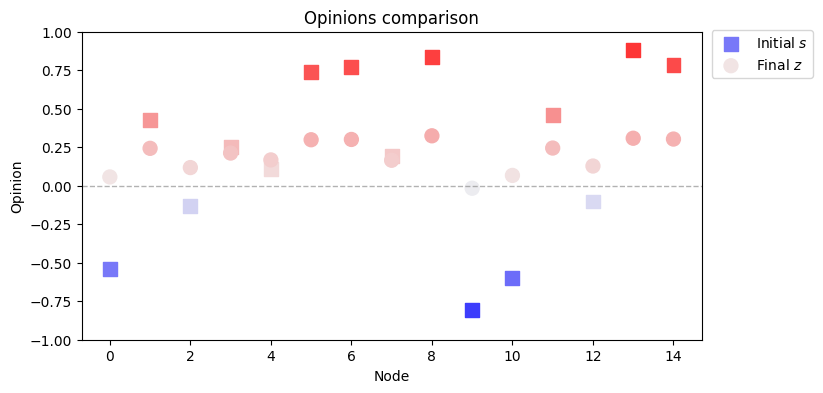

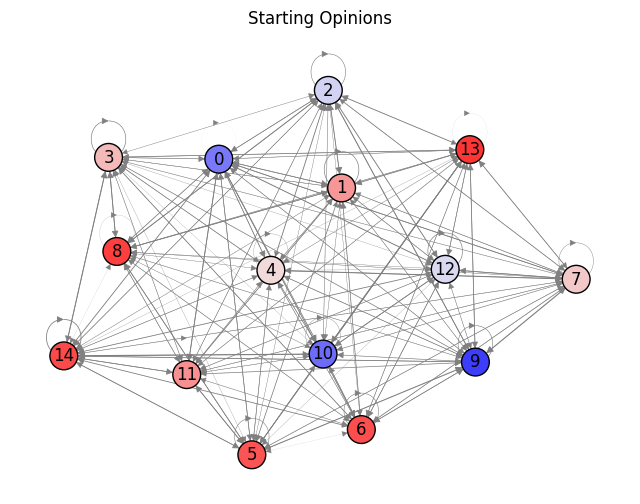

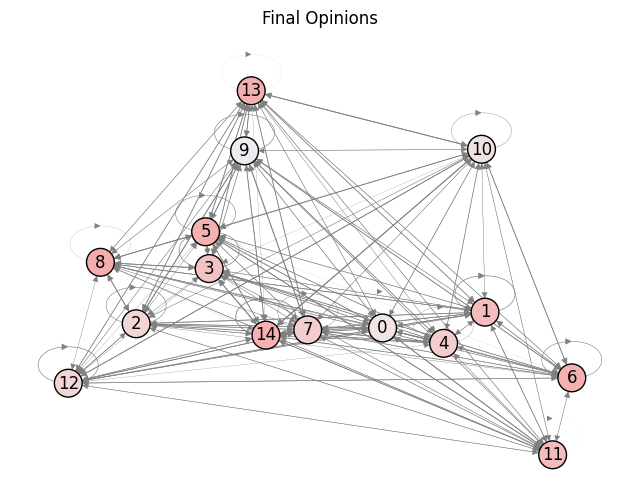



 >> 2. s_B2(1) :

Initial Opinions:	 ['-1.00', '-0.90', '-0.88', '-0.74', '-0.70', '-0.86', '-0.78', '-0.95', '-0.70', '-0.99', '-0.86', '-0.80', '-0.77', '-0.83', '-0.97']
Final Opinions:		 ['-0.88', '-0.87', '-0.87', '-0.84', '-0.83', '-0.86', '-0.85', '-0.88', '-0.83', '-0.89', '-0.86', '-0.85', '-0.85', '-0.86', '-0.89']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (2.14) - (0.08) = -2.05
NDI:	ΔΦ = (0.29) - (0.01) = -0.28
P1:	ΔΦ = (0.14) - (0.01) = -0.14
P2:	ΔΦ = (0.73) - (0.74) = 0.01
P3:	ΔΦ = (10.95) - (11.09) = 0.14
P4:	ΔΦ = (12.73) - (12.89) = 0.16


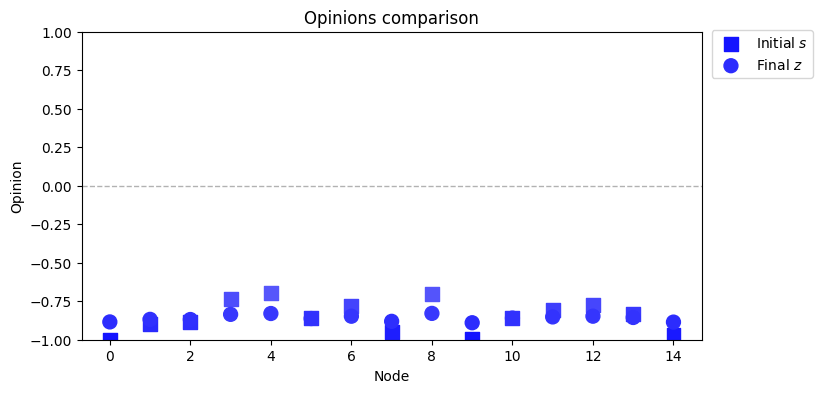

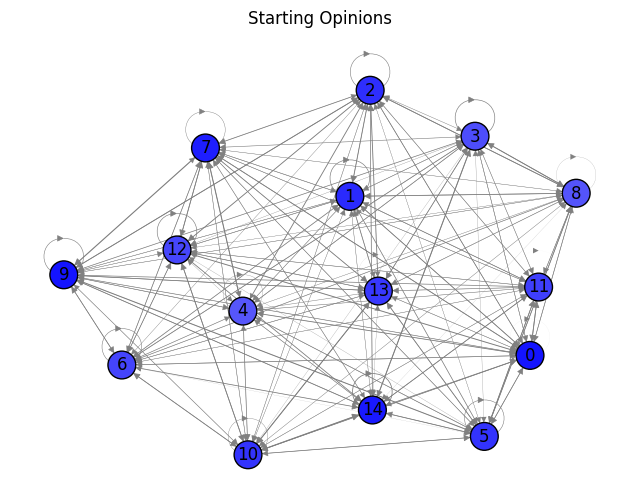

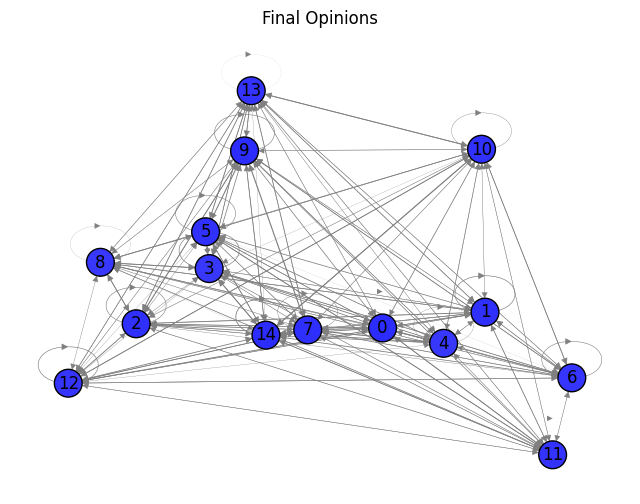



 >> 3. s_B2(t) :

Initial Opinions:	 ['-1.00', '-0.90', '-0.88', '-0.74', '-0.70', '-0.86', '-0.78', '-0.95', '-0.70', '-0.99', '-0.86', '-0.80', '-0.77', '-0.83', '-0.97']
Final Opinions:		 ['-0.88', '-0.87', '-0.87', '-0.84', '-0.83', '-0.86', '-0.85', '-0.88', '-0.83', '-0.89', '-0.86', '-0.85', '-0.85', '-0.86', '-0.89']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (2.14) - (0.08) = -2.05
NDI:	ΔΦ = (0.29) - (0.01) = -0.28
P1:	ΔΦ = (0.14) - (0.01) = -0.14
P2:	ΔΦ = (0.73) - (0.74) = 0.01
P3:	ΔΦ = (10.95) - (11.09) = 0.14
P4:	ΔΦ = (12.73) - (12.89) = 0.16


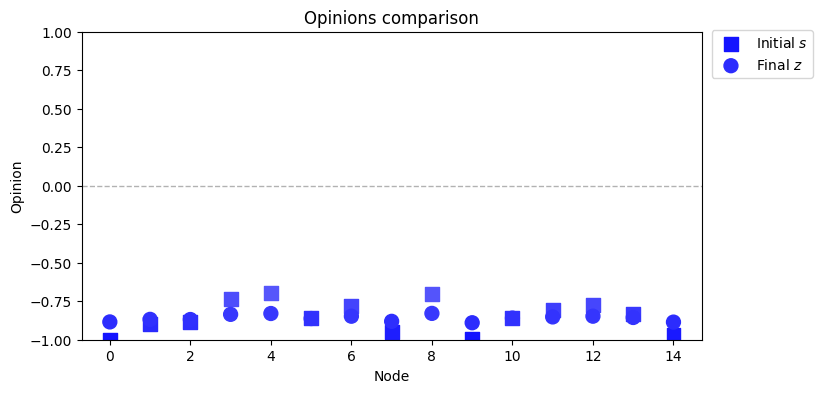

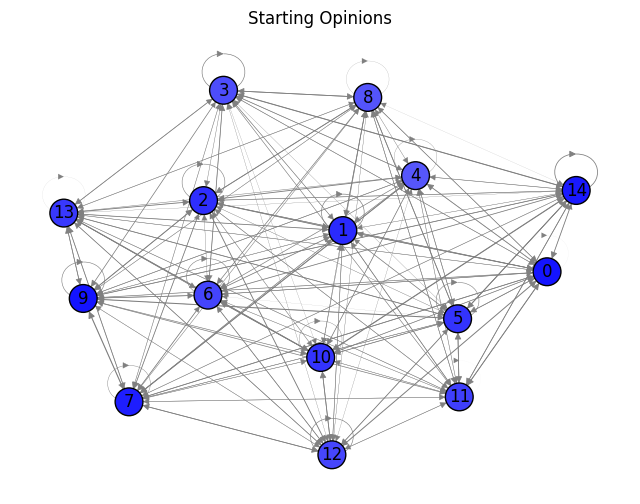

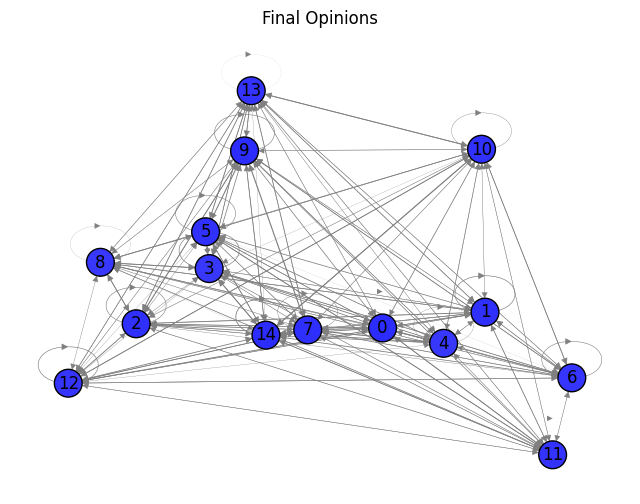



 >> 4. s_max^P2P3 :

Initial Opinions:	 ['1.00', '0.95', '0.94', '0.78', '0.74', '0.91', '0.83', '1.00', '0.75', '1.00', '0.91', '0.85', '0.82', '0.89', '1.00']
Final Opinions:		 ['0.92', '0.91', '0.91', '0.88', '0.87', '0.90', '0.89', '0.92', '0.87', '0.92', '0.90', '0.89', '0.89', '0.90', '0.92']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (1.81) - (0.07) = -1.74
NDI:	ΔΦ = (0.24) - (0.01) = -0.23
P1:	ΔΦ = (0.12) - (0.00) = -0.12
P2:	ΔΦ = (0.80) - (0.81) = 0.01
P3:	ΔΦ = (12.02) - (12.16) = 0.15
P4:	ΔΦ = (13.36) - (13.50) = 0.15


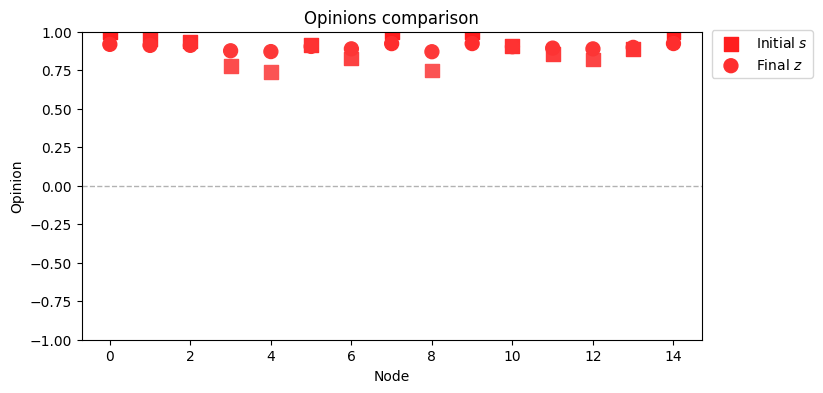

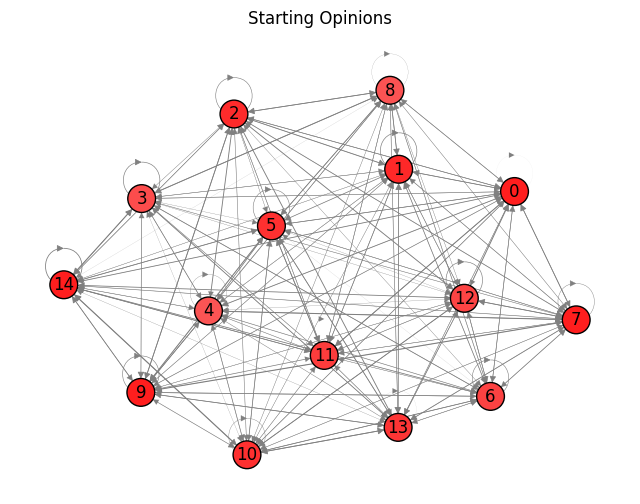

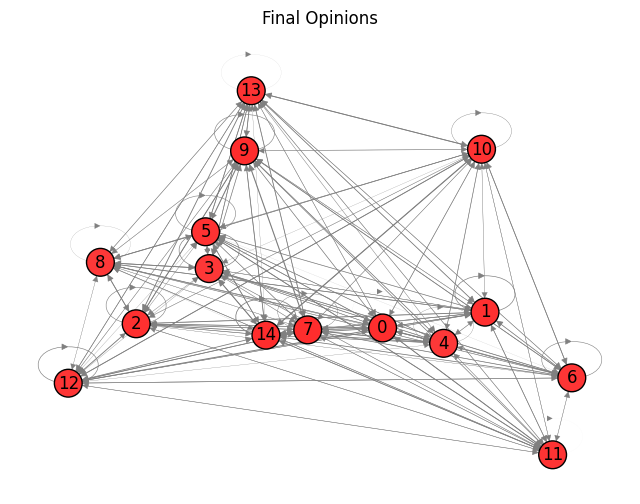



 >> 5. s_B1(1) :

Initial Opinions:	 ['1.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00', '0.00']
Final Opinions:		 ['0.25', '0.07', '0.07', '0.06', '0.06', '0.07', '0.06', '0.07', '0.07', '0.07', '0.06', '0.07', '0.07', '0.06', '0.07']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (14.00) - (0.49) = -13.51
NDI:	ΔΦ = (2.21) - (0.08) = -2.13
P1:	ΔΦ = (0.93) - (0.03) = -0.90
P2:	ΔΦ = (0.07) - (0.01) = -0.06
P3:	ΔΦ = (1.00) - (0.12) = -0.88
P4:	ΔΦ = (1.00) - (1.17) = 0.17


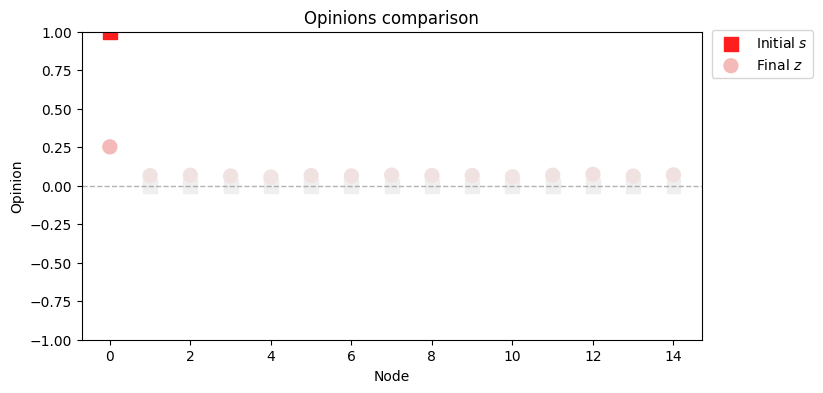

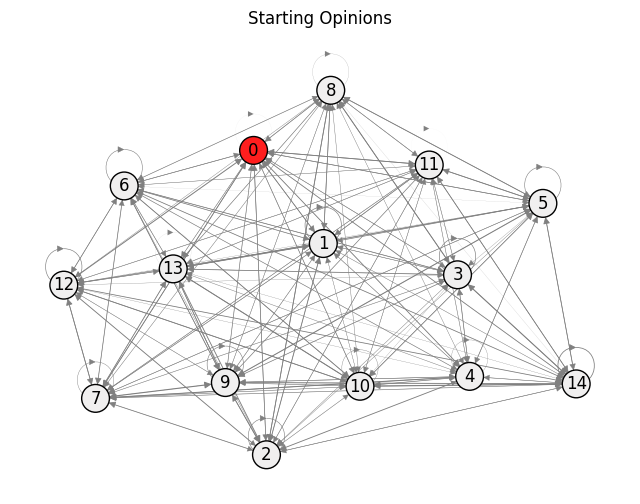

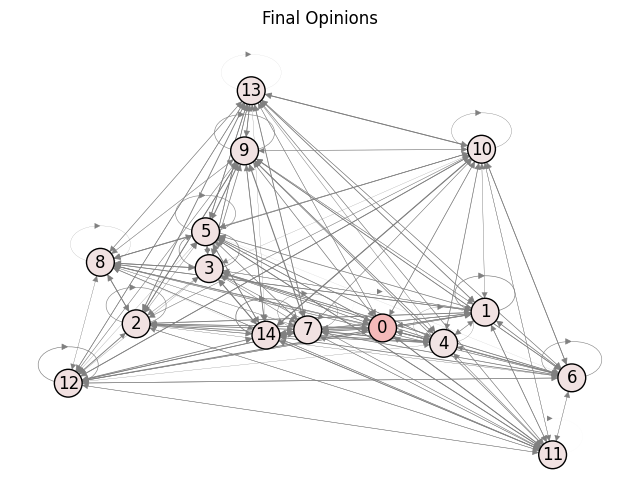



 >> 6. s_max^P4 :

Initial Opinions:	 ['1.00', '1.00', '1.00', '0.00', '0.00', '1.00', '0.00', '1.00', '0.00', '1.00', '1.00', '0.00', '0.00', '0.00', '1.00']
Final Opinions:		 ['0.66', '0.67', '0.68', '0.46', '0.49', '0.67', '0.47', '0.67', '0.46', '0.68', '0.66', '0.48', '0.48', '0.48', '0.68']
Susceptibilities:	 ['0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80', '0.80']

Polarization:
GDI:	ΔΦ = (56.00) - (2.19) = -53.81
NDI:	ΔΦ = (7.59) - (0.29) = -7.29
P1:	ΔΦ = (3.73) - (0.15) = -3.59
P2:	ΔΦ = (0.53) - (0.35) = -0.19
P3:	ΔΦ = (8.00) - (5.19) = -2.81
P4:	ΔΦ = (8.00) - (8.70) = 0.70


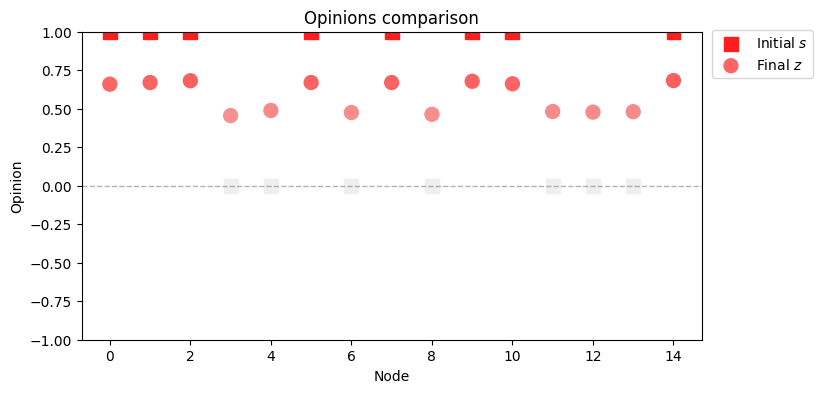

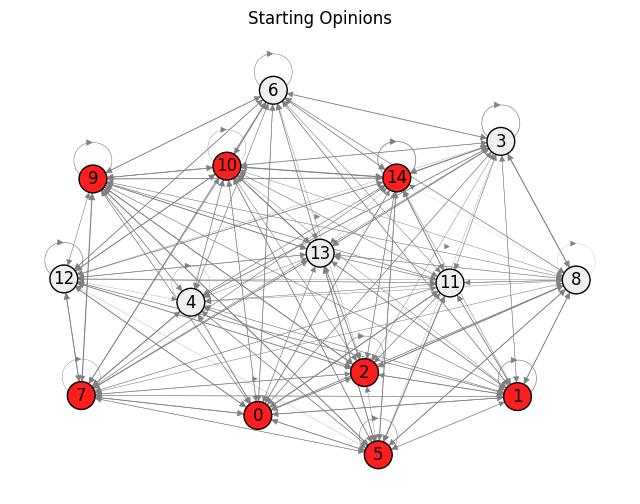

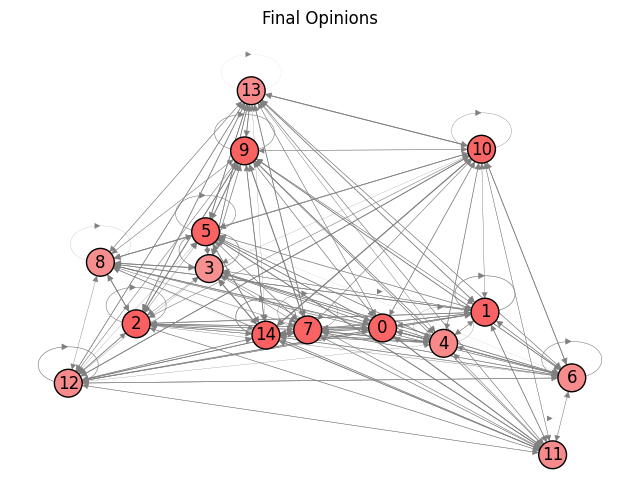

         s    GDI   NDI    P1    P2    P3    P4
    s_unif -62.89 -9.19 -4.19 -0.29 -4.34 -4.68
   s_B2(1)  -2.05 -0.28 -0.14  0.01  0.14  0.16
   s_B2(t)  -2.05 -0.28 -0.14  0.01  0.14  0.16
s_max^P2P3  -1.74 -0.23 -0.12  0.01  0.15  0.15
   s_B1(1) -13.51 -2.13 -0.90 -0.06 -0.88  0.17
  s_max^P4 -53.81 -7.29 -3.59 -0.19 -2.81  0.70


In [24]:
n = 15

# rand Lambda
np.random.seed(400)
lambda_vals = np.random.uniform(0, 1, n)
Lambda = np.diag(lambda_vals)
# rand W
W = np.random.rand(n, n)
W = W / W.sum(axis=1, keepdims=True) # row stochastic (i -> all j's)

# print("Weights:")
# print_W(W)

# Lambda const 0.8
lambda_vals = np.full(n, 0.8)
Lambda = np.diag(lambda_vals)

# s_unif
s_unif = np.random.uniform(-1, 1, n)
# sB2(1)
s_b2_1 = find_polarizing_s_for_P2_P3(Lambda, W)
# sB2(t)
s_b2_t = s_b2_1 / np.max(np.abs(s_b2_1))
# s_max^P2P3(1)
s_max_P2P3 = get_s_max_P2P3(Lambda, W)
# sB1(1)
s_b1_1 = find_polarizing_s_for_P4(Lambda, W)
# s_max^P4(1)
s_max_P4 = get_s_max_P4(Lambda, W)

s_all = {"s_unif": s_unif, "s_B2(1)": s_b2_1, "s_B2(t)": s_b2_t, "s_max^P2P3": s_max_P2P3, "s_B1(1)": s_b1_1, "s_max^P4": s_max_P4}

i = 1
rows = []
for name, s in s_all.items():
    print(f"\n\n >> {i}. {name} :\n")
    metrics = rand_template(s, Lambda, W)

    # table
    row = {"s": name}
    row.update(metrics)
    rows.append(row)
    i += 1

df = pd.DataFrame(rows)
print(df.to_string(index=False))
